In [1]:
# HiDDeN / complete-gan-mse-30-0.py
# Gourav Siddhad
# 25-Apr-2019

In [2]:
from __future__ import absolute_import, division, print_function

from numpy.random import seed
seed(1607)
from tensorflow import set_random_seed
set_random_seed(1607)

print('Importing Libraries', end='')

import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np

import random
import re
import os
import time
import csv
import math

import cv2
from sklearn.utils import shuffle
from sklearn.preprocessing import MultiLabelBinarizer

import tensorflow as tf
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

import keras
import keras.backend as K
from keras.models import Model, Sequential, load_model
from keras.layers import Activation, Input, Dense, Conv2D, BatchNormalization, ReLU
from keras.layers import GlobalAveragePooling2D, Flatten, Reshape, Lambda, Add
from keras import optimizers
from keras.preprocessing import sequence
from keras.utils import to_categorical, plot_model
from keras.layers.merge import concatenate

import matplotlib.pyplot as plt
%matplotlib inline

print(' - Done')

Importing Libraries

Using TensorFlow backend.


 - Done


In [3]:
# Model Configuration
H, W, C, L = 128, 128, 3, 30
all_messages_train = []
all_messages_validate = []
all_messages_test = []

# Training train_options
batch_size = 12
n_epochs = 200

modelpath = 'models/'

train_folder = 'dataset128/original/train/'
validate_folder = 'dataset128/original/validate/'
test_folder = 'dataset128/original/test/'
    
print('Model    - ', modelpath)
print('Train    - ', train_folder)
print('Validate - ', validate_folder)
print('Test     - ', test_folder)

Model    -  models/
Train    -  dataset128/original/train/
Validate -  dataset128/original/validate/
Test     -  dataset128/original/test/


In [4]:
print('Reading Image List', end='')
train_list = os.listdir(train_folder)
validate_list = os.listdir(validate_folder)
test_list = os.listdir(test_folder)
print(' - Done')

print('Train    - ', len(train_list))
print('Train    - ', len(validate_list))
print('Test     - ', len(test_list))
print()

message_train = []
message_validate = []
message_test = []

print('Reading Messages', end='')
with open(modelpath + str(L) + '-train-msg.csv') as csv_file:
    csv_reader = csv.reader(csv_file)
    line_count = 0
    for row in csv_reader:
        if line_count%2 is 0:
            message_train.append(row)
        line_count += 1
csv_file.close()

with open(modelpath + str(L) + '-validate-msg.csv') as csv_file:
    csv_reader = csv.reader(csv_file)
    line_count = 0
    for row in csv_reader:
        if line_count%2 is 0:
            message_validate.append(row)
        line_count += 1
csv_file.close()

with open(modelpath + str(L) + '-test-msg.csv') as csv_file:
    csv_reader = csv.reader(csv_file)
    line_count = 0
    for row in csv_reader:
        if line_count%2 is 0:
            message_test.append(row)
        line_count += 1
csv_file.close()
print(' - Done')

print('Train Messages    - ', len(message_train))
print('Validate Messages - ', len(message_validate))
print('Test Messages     - ', len(message_test))

Reading Image List - Done
Train    -  7992
Train    -  1992
Test     -  996

Reading Messages - Done
Train Messages    -  7992
Validate Messages -  1992
Test Messages     -  996


In [5]:
def gen_msg_plates(message):
    msg = []
    for l in message:
        if l is '1':
            temp = np.ones((H, W), dtype='float32')
            msg.append(temp)
        elif l is '0':
            temp = np.zeros((H, W), dtype='float32')
            msg.append(temp)
    return np.array(msg)

def gen_msg(message):
    msg = []
    for l in message:
        if l is '1':
            msg.append(float(1))
        if l is '0':
            msg.append(float(0))
    return np.array(msg, dtype='float32')

In [6]:
lamI = 0.7
lamD = 1.0
lamG = 1e-3

adam = optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

Instructions for updating:
Colocations handled automatically by placer.


In [7]:
print('Encoder Network')
# Encoder
def build_encoder():
    input_e = Input(shape=(H, W, C))
    input_m = Input(shape=(L, H, W))
    layer_e1 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(input_e)
    layer_e2 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_e1)
    layer_e3 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_e2)
    layer_e4 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_e3)

    # Reshape Message
    layer_r = Reshape((H, W, L))(input_m)

    # Integrate Message to Model
    merge = concatenate([layer_e4, input_e, layer_r])
    layer_e5 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(merge)
    output_e = Conv2D(filters=C, kernel_size=(1, 1), strides=(1, 1), padding='same')(layer_e5)
    
    model_e = Model(inputs=[input_e, input_m], outputs=output_e)
    model_e.compile(loss='mse', optimizer=adam, metrics=['accuracy'])
    return model_e

encoder = build_encoder()
encoder.summary()

print()
print('Metrics')
print(encoder.metrics_names)

Encoder Network
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 128, 128, 64) 2048        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 128, 128, 64) 37184       sequential_1[1][0]               
__________________________________________________________________________________________________
sequential_3 (Sequential)       (None, 128, 128, 64) 37184       sequential_2[1][0]               
_____________________________________________________________________________________________

In [8]:
print('Decoder Network')
# Decoder
def build_decoder():
    input_d = Input(shape=(H, W, C))
    layer_d1 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(input_d)
    layer_d2 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d1)
    layer_d3 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d2)
    layer_d4 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d3)
    layer_d5 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d4)
    layer_d6 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d5)
    layer_d7 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d6)
    layer_d8 = Sequential([Conv2D(filters=L, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_d7)
    layer_d9 = GlobalAveragePooling2D(data_format=None)(layer_d8)
    output_d = Activation('linear')(layer_d9)
    
    model_d = Model(inputs=input_d, outputs=output_d)
    model_d.compile(loss='mse', optimizer=adam, metrics=['binary_accuracy'])
    return model_d

decoder = build_decoder()
decoder.summary()

print()
print('Metrics')
print(decoder.metrics_names)

Decoder Network
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 128, 128, 3)       0         
_________________________________________________________________
sequential_6 (Sequential)    (None, 128, 128, 64)      2048      
_________________________________________________________________
sequential_7 (Sequential)    (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_8 (Sequential)    (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_9 (Sequential)    (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_10 (Sequential)   (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_11 (Sequential)   (None, 128, 128, 64)      37184

In [9]:
print('Adversary Network')
# Adversary
def build_adversary():
    input_a = Input(shape=(H, W, C))
    layer_a1 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(input_a)
    layer_a2 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_a1)
    layer_a3 = Sequential([Conv2D(filters=64, kernel_size=(3, 3), strides=(1, 1), padding='same'),
                    BatchNormalization(axis=-1, epsilon=1e-05, momentum=0.1, center=True, scale=True),
                    ReLU(max_value=None, negative_slope=0.0, threshold=0.0)])(layer_a2)
    layer_a4 =  GlobalAveragePooling2D(data_format=None)(layer_a3)
    output_a = Dense(1, activation='linear', name='Adv')(layer_a4)

    model_a = Model(inputs=input_a, outputs=output_a)
    model_a.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    return model_a

adversary = build_adversary()
adversary.summary()

print()
print('Metrics')
print(adversary.metrics_names)

Adversary Network
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         (None, 128, 128, 3)       0         
_________________________________________________________________
sequential_14 (Sequential)   (None, 128, 128, 64)      2048      
_________________________________________________________________
sequential_15 (Sequential)   (None, 128, 128, 64)      37184     
_________________________________________________________________
sequential_16 (Sequential)   (None, 128, 128, 64)      37184     
_________________________________________________________________
global_average_pooling2d_2 ( (None, 64)                0         
_________________________________________________________________
Adv (Dense)                  (None, 1)                 65        
Total params: 76,481
Trainable params: 76,097
Non-trainable params: 384
____________________________________________________

In [10]:
print('Combined Model')
# Combined
def build_combined(encoder, decoder, adversary):
    adversary.trainable = False
    
    c_iinput = Input(shape=(H, W, C))
    c_minput = Input(shape=(L, H, W))
    
    c_eout = encoder([c_iinput, c_minput])
    c_dout = decoder(c_eout)
    c_aout = adversary(c_eout)
    
    combined = Model(inputs=[c_iinput, c_minput], outputs=[c_eout, c_dout, c_aout])
    combined.compile(loss=['mse', 'mse', 'binary_crossentropy'], loss_weights=[lamI, lamD, lamG],
                     optimizer=adam, metrics=['accuracy', 'binary_accuracy'])
    return combined

combined = build_combined(encoder, decoder, adversary)
combined.summary()

print()
print('Metrics')
print(combined.metrics_names)

Combined Model
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
input_6 (InputLayer)            (None, 30, 128, 128) 0                                            
__________________________________________________________________________________________________
model_1 (Model)                 (None, 128, 128, 3)  169987      input_5[0][0]                    
                                                                 input_6[0][0]                    
__________________________________________________________________________________________________
model_2 (Model)                 (None, 30)           242582      model_1[1][0]                

In [11]:
def DataGenerator(file_list, folder_path, messages, index, batch_size=12):
    indexes = np.arange(len(file_list))
    
    index = indexes[int(index*batch_size) : int((index+1)*batch_size)]
    file_list_temp = [file_list[k] for k in index]
    message_temp = [messages[k] for k in index]

    images = []
    batch_msg = []
    dec_msg = []

    for i, ID in enumerate(file_list_temp):
        img = cv2.imread(folder_path + ID, -1)
        img = img.reshape([H, W, C])
        images.append((np.array(img, dtype='float32')-127.5)/127.5)
        
        msg = gen_msg_plates(message_temp[i])
        msg2 = gen_msg(message_temp[i])
        batch_msg.append(msg)
        dec_msg.append(msg2)

    return np.array(images), np.array(batch_msg), np.array(dec_msg)

In [12]:
# To remove the tf warning ;)
a = tf.to_int32(tf.Variable(0))

Instructions for updating:
Use tf.cast instead.


In [13]:
def calc_metric(loss, acc, vloss, vacc, advla, adv_r, adv_f, history, vhistory):
    avgl_e, avgl_d, avgl_a = [], [], []
    avga_e, avga_d, avga_a = [], [], []
    avgl = []
    vavgl_e, vavgl_d, vavgl_a = [], [], []
    vavga_e, vavga_d, vavga_a = [], [], []
    vavgl = []
    
    avgal_a, avgal_l = [], []
    for i in range(len(adv_r)):
        avgal_l.append(adv_r[i][0])
        avgal_a.append(adv_r[i][1])
        avgal_l.append(adv_f[i][0])
        avgal_a.append(adv_f[i][1])
        
    advla[0].append(np.mean(avgal_l))
    advla[1].append(np.mean(avgal_a))
    
    for hist in vhistory:
        vavgl.append(hist[0])
        vavgl_e.append(hist[1])
        vavgl_d.append(hist[2])
        vavgl_a.append(hist[3])
        vavga_e.append(hist[4])
        vavga_d.append(hist[7])
        vavga_a.append(hist[8])
        
    for hist in history:
        avgl.append(hist[0])
        avgl_e.append(hist[1])
        avgl_d.append(hist[2])
        avgl_a.append(hist[3])
        avga_e.append(hist[4])
        avga_d.append(hist[7])
        avga_a.append(hist[8])

    loss[0].append(np.mean(avgl))
    loss[1].append(np.mean(avgl_e))
    loss[2].append(np.mean(avgl_d))
    loss[3].append(np.mean(avgl_a))
    acc[0].append(np.mean(avga_e))
    acc[1].append(np.mean(avga_d))
    acc[2].append(np.mean(avga_a))
    
    vloss[0].append(np.mean(vavgl))
    vloss[1].append(np.mean(vavgl_e))
    vloss[2].append(np.mean(vavgl_d))
    vloss[3].append(np.mean(vavgl_a))
    vacc[0].append(np.mean(vavga_e))
    vacc[1].append(np.mean(vavga_d))
    vacc[2].append(np.mean(vavga_a))
    
    return loss, acc, vloss, vacc, advla

def print_metric(loss, acc, vloss, vacc, advla, epoch, ttime, vtime):
    print()
    print('Training   - ')
    print('Train     | Loss  : {:10.7f}'.format(loss[0][epoch]), end='\t')
    print(' | Time     : {:10.6f} |'.format(ttime))
    print('Adversary | Loss  : {:10.7f}'.format(advla[0][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(advla[1][epoch]))
    print('Encoder   | Loss  : {:10.7f}'.format(loss[1][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(acc[0][epoch]))
    print('Decoder   | Loss  : {:10.7f}'.format(loss[2][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(acc[1][epoch]))
    print('Adversary | Loss  : {:10.7f}'.format(loss[3][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(acc[2][epoch]))
    print()
    print('Validation - ')
    print('Validate  | Loss  : {:10.7f}'.format(vloss[0][epoch]), end='\t')
    print(' | Time     : {:10.6f} |'.format(vtime))
    print('Encoder   | Loss  : {:10.7f}'.format(vloss[1][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(vacc[0][epoch]))
    print('Decoder   | Loss  : {:10.7f}'.format(vloss[2][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(vacc[1][epoch]))
    print('Adversary | Loss  : {:10.7f}'.format(vloss[3][epoch]), end='\t')
    print(' | Accuracy : {:10.7f} |'.format(vacc[2][epoch]))
    
def arr_img(image):
    # To print images between epochs correctly
    return ((image*127.5)+127.5).astype(np.uint8)

def psnr(img1, img2):
    mse = np.mean((img1-img2)**2)
    if mse == 0:
        return mse
    PIXEL_MAX = 255.0
    return 20 * math.log10(PIXEL_MAX / math.sqrt(mse))

In [14]:
tbatches = (len(train_list)//batch_size)
vbatches = (len(validate_list)//batch_size)

Training Complete Network

Epoch :  1 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2701747	 | Time     : 240.143146 |
Adversary | Loss  :  0.7246597	 | Accuracy :  0.7321697 |
Encoder   | Loss  :  0.0293991	 | Accuracy :  0.5867391 |
Decoder   | Loss  :  0.2484301	 | Accuracy :  0.5510386 |
Adversary | Loss  :  1.1651946	 | Accuracy :  0.2294795 |

Validation - 
Validate  | Loss  :  0.2443464	 | Time     :  30.248748 |
Encoder   | Loss  :  0.0066413	 | Accuracy :  0.6580530 |
Decoder   | Loss  :  0.2389827	 | Accuracy :  0.5828481 |
Adversary | Loss  :  0.7147835	 | Accuracy :  0.4387550 |


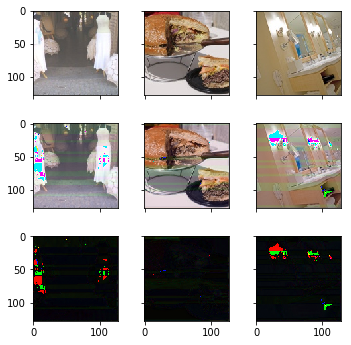


Epoch :  2 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2571780	 | Time     : 232.799183 |
Adversary | Loss  :  0.7989729	 | Accuracy :  0.8644895 |
Encoder   | Loss  :  0.0212615	 | Accuracy :  0.6118886 |
Decoder   | Loss  :  0.2394790	 | Accuracy :  0.5776193 |
Adversary | Loss  :  2.8159597	 | Accuracy :  0.0713213 |

Validation - 
Validate  | Loss  :  0.2525320	 | Time     :  19.816277 |
Encoder   | Loss  :  0.0129625	 | Accuracy :  0.5832722 |
Decoder   | Loss  :  0.2315865	 | Accuracy :  0.6028615 |
Adversary | Loss  : 11.8718023	 | Accuracy :  0.0717872 |


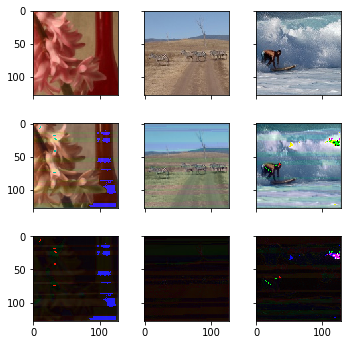


Epoch :  3 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2401176	 | Time     : 234.075694 |
Adversary | Loss  :  6.3658495	 | Accuracy :  0.2227227 |
Encoder   | Loss  :  0.0143154	 | Accuracy :  0.6372343 |
Decoder   | Loss  :  0.2242719	 | Accuracy :  0.6213672 |
Adversary | Loss  :  5.8249111	 | Accuracy :  0.2220971 |

Validation - 
Validate  | Loss  :  0.2347510	 | Time     :  19.668351 |
Encoder   | Loss  :  0.0099495	 | Accuracy :  0.6627979 |
Decoder   | Loss  :  0.2140994	 | Accuracy :  0.6369980 |
Adversary | Loss  : 13.6868954	 | Accuracy :  0.0496988 |


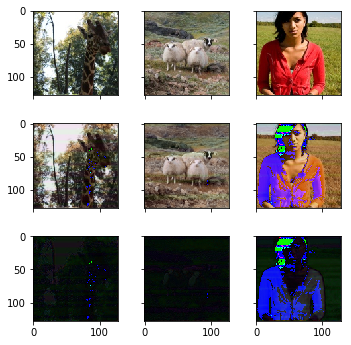


Epoch :  4 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2198694	 | Time     : 233.931123 |
Adversary | Loss  :  7.0435295	 | Accuracy :  0.1833083 |
Encoder   | Loss  :  0.0122727	 | Accuracy :  0.6598024 |
Decoder   | Loss  :  0.2109162	 | Accuracy :  0.6449533 |
Adversary | Loss  :  0.3623121	 | Accuracy :  0.3238238 |

Validation - 
Validate  | Loss  :  0.2169230	 | Time     :  19.655577 |
Encoder   | Loss  :  0.0067662	 | Accuracy :  0.6868988 |
Decoder   | Loss  :  0.2049964	 | Accuracy :  0.6535810 |
Adversary | Loss  :  7.1901894	 | Accuracy :  0.2560241 |


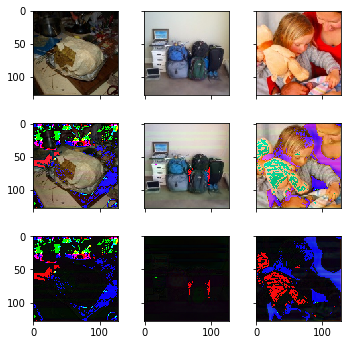


Epoch :  5 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2111080	 | Time     : 234.089976 |
Adversary | Loss  :  6.6529627	 | Accuracy :  0.2042042 |
Encoder   | Loss  :  0.0108529	 | Accuracy :  0.6626506 |
Decoder   | Loss  :  0.2027871	 | Accuracy :  0.6582916 |
Adversary | Loss  :  0.7238766	 | Accuracy :  0.3299550 |

Validation - 
Validate  | Loss  :  0.2269151	 | Time     :  19.808561 |
Encoder   | Loss  :  0.0136452	 | Accuracy :  0.6900128 |
Decoder   | Loss  :  0.2025354	 | Accuracy :  0.6653112 |
Adversary | Loss  : 14.8280249	 | Accuracy :  0.0371486 |


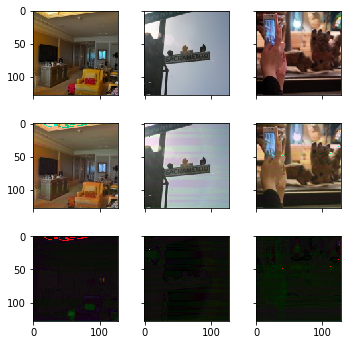


Epoch :  6 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2049989	 | Time     : 233.572520 |
Adversary | Loss  :  6.3178177	 | Accuracy :  0.2319820 |
Encoder   | Loss  :  0.0114600	 | Accuracy :  0.6587459 |
Decoder   | Loss  :  0.1959501	 | Accuracy :  0.6698657 |
Adversary | Loss  :  1.0268584	 | Accuracy :  0.3454705 |

Validation - 
Validate  | Loss  :  0.2085758	 | Time     :  19.676263 |
Encoder   | Loss  :  0.0074817	 | Accuracy :  0.6968365 |
Decoder   | Loss  :  0.1913003	 | Accuracy :  0.6799364 |
Adversary | Loss  : 12.0383167	 | Accuracy :  0.1094378 |


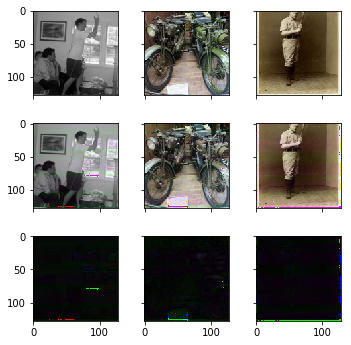


Epoch :  7 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1990705	 | Time     : 234.170645 |
Adversary | Loss  :  5.6491756	 | Accuracy :  0.2785285 |
Encoder   | Loss  :  0.0109278	 | Accuracy :  0.6661068 |
Decoder   | Loss  :  0.1903447	 | Accuracy :  0.6775401 |
Adversary | Loss  :  1.0763857	 | Accuracy :  0.3972723 |

Validation - 
Validate  | Loss  :  0.2095433	 | Time     :  19.567679 |
Encoder   | Loss  :  0.0143457	 | Accuracy :  0.6916530 |
Decoder   | Loss  :  0.1884395	 | Accuracy :  0.6774431 |
Adversary | Loss  : 11.0617046	 | Accuracy :  0.0943775 |


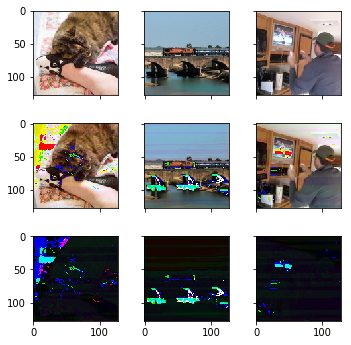


Epoch :  8 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1961483	 | Time     : 233.834409 |
Adversary | Loss  :  4.5559225	 | Accuracy :  0.3365866 |
Encoder   | Loss  :  0.0105389	 | Accuracy :  0.6743169 |
Decoder   | Loss  :  0.1882116	 | Accuracy :  0.6797464 |
Adversary | Loss  :  0.5595000	 | Accuracy :  0.4162913 |

Validation - 
Validate  | Loss  :  0.2099018	 | Time     :  19.829419 |
Encoder   | Loss  :  0.0092006	 | Accuracy :  0.6683480 |
Decoder   | Loss  :  0.1927486	 | Accuracy :  0.6633367 |
Adversary | Loss  : 10.7126894	 | Accuracy :  0.1792169 |


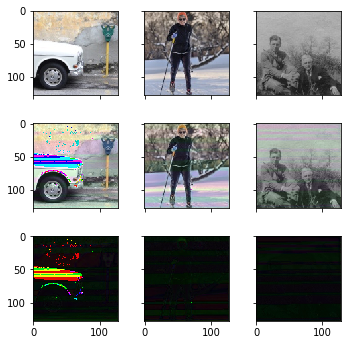


Epoch :  9 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1936069	 | Time     : 234.507431 |
Adversary | Loss  :  3.1926339	 | Accuracy :  0.4222973 |
Encoder   | Loss  :  0.0102440	 | Accuracy :  0.6692488 |
Decoder   | Loss  :  0.1852802	 | Accuracy :  0.6865407 |
Adversary | Loss  :  1.1559484	 | Accuracy :  0.4618368 |

Validation - 
Validate  | Loss  :  0.1928191	 | Time     :  19.713359 |
Encoder   | Loss  :  0.0143450	 | Accuracy :  0.6340632 |
Decoder   | Loss  :  0.1817977	 | Accuracy :  0.6939424 |
Adversary | Loss  :  0.9798670	 | Accuracy :  0.2926707 |


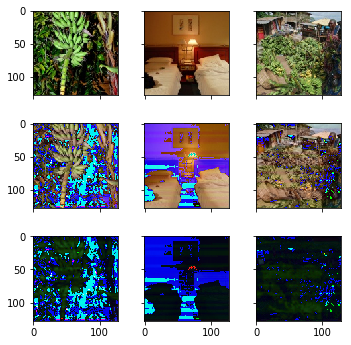


Epoch :  10 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1895356	 | Time     : 234.472855 |
Adversary | Loss  :  0.6972588	 | Accuracy :  0.5186436 |
Encoder   | Loss  :  0.0101987	 | Accuracy :  0.6661821 |
Decoder   | Loss  :  0.1816911	 | Accuracy :  0.6927219 |
Adversary | Loss  :  0.7054588	 | Accuracy :  0.4625876 |

Validation - 
Validate  | Loss  :  0.1917525	 | Time     :  19.478554 |
Encoder   | Loss  :  0.0160444	 | Accuracy :  0.6495830 |
Decoder   | Loss  :  0.1798547	 | Accuracy :  0.6963856 |
Adversary | Loss  :  0.6667380	 | Accuracy :  0.6365462 |


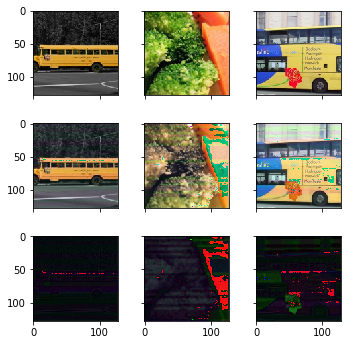


Epoch :  11 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1865950	 | Time     : 234.703327 |
Adversary | Loss  :  0.6785241	 | Accuracy :  0.6068568 |
Encoder   | Loss  :  0.0087792	 | Accuracy :  0.6795664 |
Decoder   | Loss  :  0.1797387	 | Accuracy :  0.6943819 |
Adversary | Loss  :  0.7108377	 | Accuracy :  0.3882632 |

Validation - 
Validate  | Loss  :  0.1839803	 | Time     :  19.479645 |
Encoder   | Loss  :  0.0084177	 | Accuracy :  0.6409822 |
Decoder   | Loss  :  0.1773715	 | Accuracy :  0.6943273 |
Adversary | Loss  :  0.7164379	 | Accuracy :  0.2650602 |


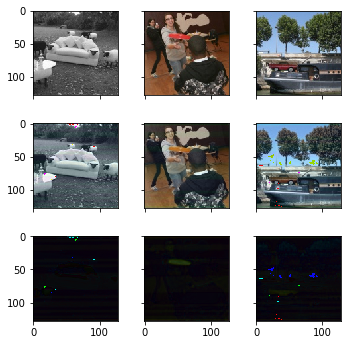


Epoch :  12 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1855395	 | Time     : 234.376899 |
Adversary | Loss  :  0.6481652	 | Accuracy :  0.6878128 |
Encoder   | Loss  :  0.0088710	 | Accuracy :  0.6820360 |
Decoder   | Loss  :  0.1785833	 | Accuracy :  0.6940148 |
Adversary | Loss  :  0.7464975	 | Accuracy :  0.2770270 |

Validation - 
Validate  | Loss  :  0.1868338	 | Time     :  19.887217 |
Encoder   | Loss  :  0.0084437	 | Accuracy :  0.6955204 |
Decoder   | Loss  :  0.1801507	 | Accuracy :  0.6937919 |
Adversary | Loss  :  0.7724622	 | Accuracy :  0.2128514 |


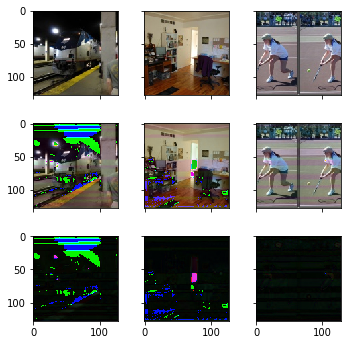


Epoch :  13 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1839386	 | Time     : 234.148327 |
Adversary | Loss  :  0.6106088	 | Accuracy :  0.7230356 |
Encoder   | Loss  :  0.0082479	 | Accuracy :  0.6921105 |
Decoder   | Loss  :  0.1773490	 | Accuracy :  0.6963630 |
Adversary | Loss  :  0.8160672	 | Accuracy :  0.2130881 |

Validation - 
Validate  | Loss  :  0.1805484	 | Time     :  19.590547 |
Encoder   | Loss  :  0.0055690	 | Accuracy :  0.6869659 |
Decoder   | Loss  :  0.1759286	 | Accuracy :  0.6979418 |
Adversary | Loss  :  0.7215520	 | Accuracy :  0.7243976 |


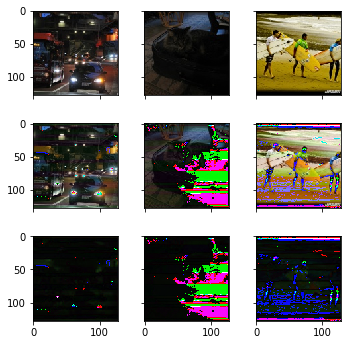


Epoch :  14 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1837947	 | Time     : 234.111531 |
Adversary | Loss  :  0.4744980	 | Accuracy :  0.8502252 |
Encoder   | Loss  :  0.0093343	 | Accuracy :  0.6869596 |
Decoder   | Loss  :  0.1760126	 | Accuracy :  0.7011803 |
Adversary | Loss  :  1.2480805	 | Accuracy :  0.1012262 |

Validation - 
Validate  | Loss  :  0.1760746	 | Time     :  19.604987 |
Encoder   | Loss  :  0.0039560	 | Accuracy :  0.7509207 |
Decoder   | Loss  :  0.1729020	 | Accuracy :  0.7082329 |
Adversary | Loss  :  0.4034332	 | Accuracy :  0.9673696 |


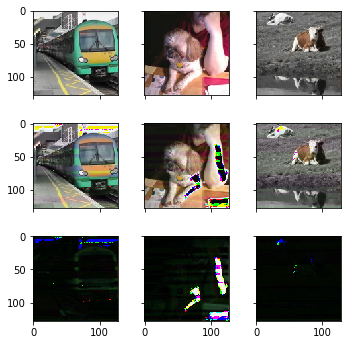


Epoch :  15 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1816203	 | Time     : 233.996360 |
Adversary | Loss  :  0.3750677	 | Accuracy :  0.9120371 |
Encoder   | Loss  :  0.0075746	 | Accuracy :  0.6889479 |
Decoder   | Loss  :  0.1744309	 | Accuracy :  0.7061061 |
Adversary | Loss  :  1.8872521	 | Accuracy :  0.0510511 |

Validation - 
Validate  | Loss  :  0.1856076	 | Time     :  19.386321 |
Encoder   | Loss  :  0.0078077	 | Accuracy :  0.6972343 |
Decoder   | Loss  :  0.1799985	 | Accuracy :  0.6927711 |
Adversary | Loss  :  0.1437234	 | Accuracy :  0.9949800 |


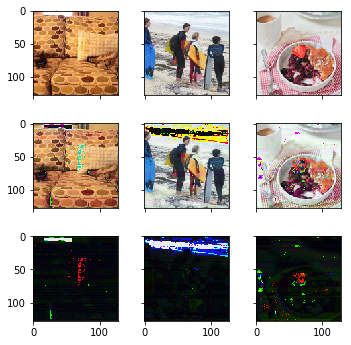


Epoch :  16 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1816598	 | Time     : 233.957930 |
Adversary | Loss  :  0.8400430	 | Accuracy :  0.6848724 |
Encoder   | Loss  :  0.0078954	 | Accuracy :  0.6892679 |
Decoder   | Loss  :  0.1739546	 | Accuracy :  0.7063897 |
Adversary | Loss  :  2.1783893	 | Accuracy :  0.2718969 |

Validation - 
Validate  | Loss  :  0.1762756	 | Time     :  19.602387 |
Encoder   | Loss  :  0.0062288	 | Accuracy :  0.6865537 |
Decoder   | Loss  :  0.1712465	 | Accuracy :  0.7097390 |
Adversary | Loss  :  0.6690416	 | Accuracy :  0.6470883 |


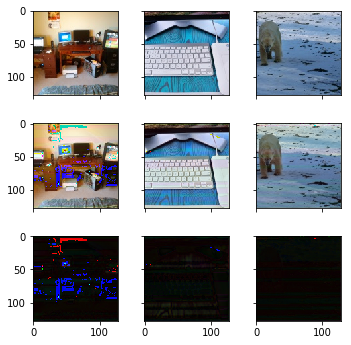


Epoch :  17 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1766415	 | Time     : 234.416017 |
Adversary | Loss  :  0.5909141	 | Accuracy :  0.7556932 |
Encoder   | Loss  :  0.0064516	 | Accuracy :  0.7042069 |
Decoder   | Loss  :  0.1712883	 | Accuracy :  0.7096430 |
Adversary | Loss  :  0.8370926	 | Accuracy :  0.1956957 |

Validation - 
Validate  | Loss  :  0.1747907	 | Time     :  19.810529 |
Encoder   | Loss  :  0.0056841	 | Accuracy :  0.7358879 |
Decoder   | Loss  :  0.1704263	 | Accuracy :  0.7105590 |
Adversary | Loss  :  0.3855134	 | Accuracy :  0.9809237 |


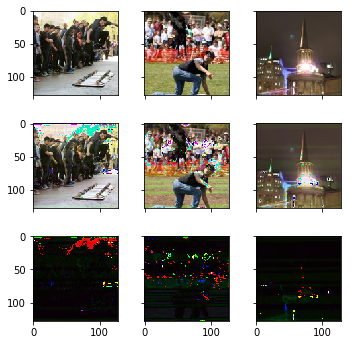


Epoch :  18 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1791440	 | Time     : 235.014411 |
Adversary | Loss  :  0.4579496	 | Accuracy :  0.8939565 |
Encoder   | Loss  :  0.0074097	 | Accuracy :  0.6983963 |
Decoder   | Loss  :  0.1718323	 | Accuracy :  0.7078036 |
Adversary | Loss  :  2.1248178	 | Accuracy :  0.0590591 |

Validation - 
Validate  | Loss  :  0.1757315	 | Time     :  19.914182 |
Encoder   | Loss  :  0.0050508	 | Accuracy :  0.6904681 |
Decoder   | Loss  :  0.1716077	 | Accuracy :  0.7067938 |
Adversary | Loss  :  0.5882676	 | Accuracy :  0.7886546 |


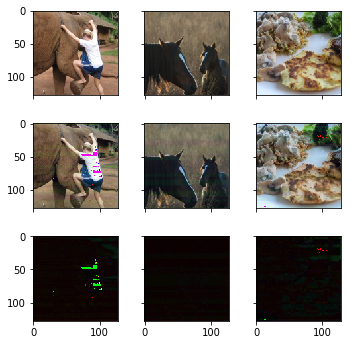


Epoch :  19 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1838890	 | Time     : 234.055640 |
Adversary | Loss  :  0.9587297	 | Accuracy :  0.7915416 |
Encoder   | Loss  :  0.0097410	 | Accuracy :  0.6795223 |
Decoder   | Loss  :  0.1735191	 | Accuracy :  0.7045546 |
Adversary | Loss  :  3.5512321	 | Accuracy :  0.1207458 |

Validation - 
Validate  | Loss  :  0.1858596	 | Time     :  19.829957 |
Encoder   | Loss  :  0.0088253	 | Accuracy :  0.6783496 |
Decoder   | Loss  :  0.1724871	 | Accuracy :  0.7072122 |
Adversary | Loss  :  7.1947403	 | Accuracy :  0.2565261 |


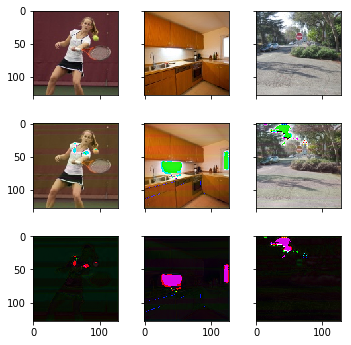


Epoch :  20 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1753870	 | Time     : 234.067604 |
Adversary | Loss  :  1.3317925	 | Accuracy :  0.6018519 |
Encoder   | Loss  :  0.0062405	 | Accuracy :  0.6937091 |
Decoder   | Loss  :  0.1691291	 | Accuracy :  0.7104980 |
Adversary | Loss  :  1.8894670	 | Accuracy :  0.3229479 |

Validation - 
Validate  | Loss  :  0.1732527	 | Time     :  19.723986 |
Encoder   | Loss  :  0.0046125	 | Accuracy :  0.7454497 |
Decoder   | Loss  :  0.1694979	 | Accuracy :  0.7111781 |
Adversary | Loss  :  0.5260424	 | Accuracy :  0.9191766 |


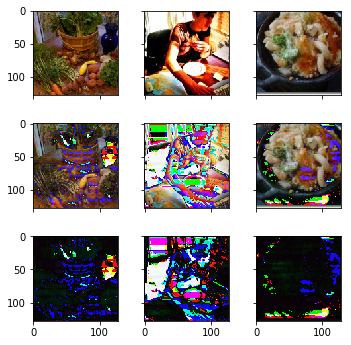


Epoch :  21 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1746430	 | Time     : 233.756306 |
Adversary | Loss  :  0.6747720	 | Accuracy :  0.8449074 |
Encoder   | Loss  :  0.0057169	 | Accuracy :  0.7147570 |
Decoder   | Loss  :  0.1690368	 | Accuracy :  0.7107483 |
Adversary | Loss  :  1.6043650	 | Accuracy :  0.0867117 |

Validation - 
Validate  | Loss  :  0.1807146	 | Time     :  19.537705 |
Encoder   | Loss  :  0.0119587	 | Accuracy :  0.6394970 |
Decoder   | Loss  :  0.1699999	 | Accuracy :  0.7109270 |
Adversary | Loss  :  2.3435352	 | Accuracy :  0.4944779 |


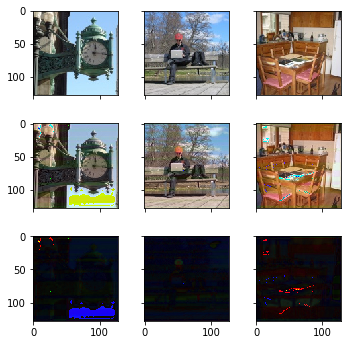


Epoch :  22 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1752022	 | Time     : 233.495028 |
Adversary | Loss  :  1.6028738	 | Accuracy :  0.4908033 |
Encoder   | Loss  :  0.0085295	 | Accuracy :  0.6891115 |
Decoder   | Loss  :  0.1683396	 | Accuracy :  0.7114365 |
Adversary | Loss  :  0.8919637	 | Accuracy :  0.5087587 |

Validation - 
Validate  | Loss  :  0.1731646	 | Time     :  19.751812 |
Encoder   | Loss  :  0.0074468	 | Accuracy :  0.6352871 |
Decoder   | Loss  :  0.1673928	 | Accuracy :  0.7106760 |
Adversary | Loss  :  0.5589359	 | Accuracy :  0.9482931 |


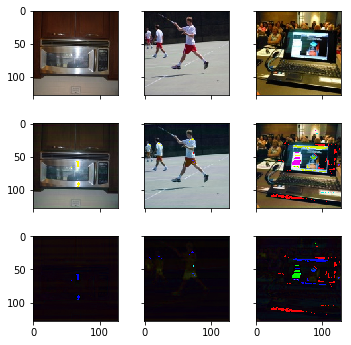


Epoch :  23 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1729735	 | Time     : 233.801946 |
Adversary | Loss  :  0.6704170	 | Accuracy :  0.6151151 |
Encoder   | Loss  :  0.0059143	 | Accuracy :  0.7046583 |
Decoder   | Loss  :  0.1680914	 | Accuracy :  0.7113864 |
Adversary | Loss  :  0.7420889	 | Accuracy :  0.3372122 |

Validation - 
Validate  | Loss  :  0.1733630	 | Time     :  19.657706 |
Encoder   | Loss  :  0.0053060	 | Accuracy :  0.6804854 |
Decoder   | Loss  :  0.1688531	 | Accuracy :  0.7113119 |
Adversary | Loss  :  0.7957535	 | Accuracy :  0.3027108 |


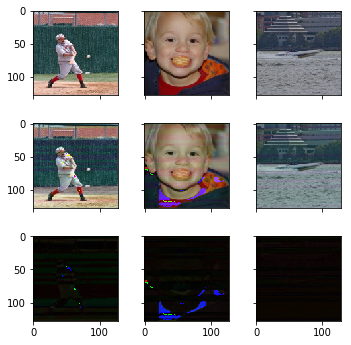


Epoch :  24 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1737658	 | Time     : 233.688659 |
Adversary | Loss  :  0.5752039	 | Accuracy :  0.7609484 |
Encoder   | Loss  :  0.0065900	 | Accuracy :  0.7028627 |
Decoder   | Loss  :  0.1682152	 | Accuracy :  0.7116408 |
Adversary | Loss  :  0.9376311	 | Accuracy :  0.1634134 |

Validation - 
Validate  | Loss  :  0.1747668	 | Time     :  19.472876 |
Encoder   | Loss  :  0.0044682	 | Accuracy :  0.7177194 |
Decoder   | Loss  :  0.1712031	 | Accuracy :  0.7086681 |
Adversary | Loss  :  0.4359386	 | Accuracy :  0.9578313 |


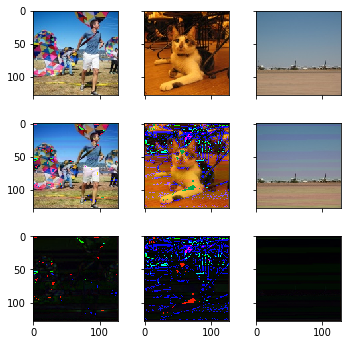


Epoch :  25 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1724810	 | Time     : 234.134254 |
Adversary | Loss  :  1.9699782	 | Accuracy :  0.5117617 |
Encoder   | Loss  :  0.0055779	 | Accuracy :  0.7098474 |
Decoder   | Loss  :  0.1676757	 | Accuracy :  0.7123832 |
Adversary | Loss  :  0.9007495	 | Accuracy :  0.3692442 |

Validation - 
Validate  | Loss  :  0.1726858	 | Time     :  19.943275 |
Encoder   | Loss  :  0.0058072	 | Accuracy :  0.6901794 |
Decoder   | Loss  :  0.1678421	 | Accuracy :  0.7104083 |
Adversary | Loss  :  0.7787068	 | Accuracy :  0.5045181 |


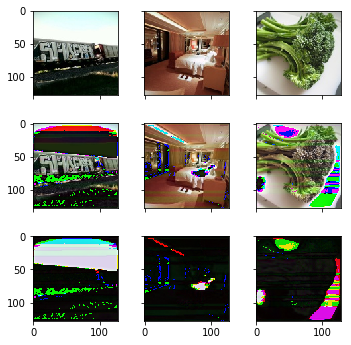


Epoch :  26 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1726043	 | Time     : 234.670484 |
Adversary | Loss  :  0.6500090	 | Accuracy :  0.6555306 |
Encoder   | Loss  :  0.0061056	 | Accuracy :  0.7033001 |
Decoder   | Loss  :  0.1675769	 | Accuracy :  0.7128045 |
Adversary | Loss  :  0.7534935	 | Accuracy :  0.3048048 |

Validation - 
Validate  | Loss  :  0.1732841	 | Time     :  19.882241 |
Encoder   | Loss  :  0.0065893	 | Accuracy :  0.6540080 |
Decoder   | Loss  :  0.1681175	 | Accuracy :  0.7093374 |
Adversary | Loss  :  0.5540341	 | Accuracy :  0.9568273 |


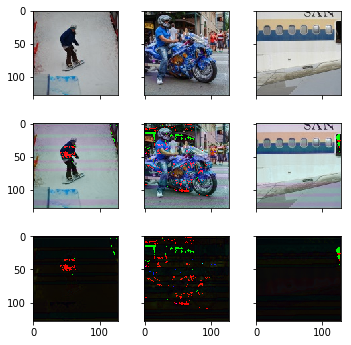


Epoch :  27 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1719288	 | Time     : 233.637110 |
Adversary | Loss  :  0.5997693	 | Accuracy :  0.7486236 |
Encoder   | Loss  :  0.0054946	 | Accuracy :  0.7101807 |
Decoder   | Loss  :  0.1672521	 | Accuracy :  0.7130923 |
Adversary | Loss  :  0.8304864	 | Accuracy :  0.1884384 |

Validation - 
Validate  | Loss  :  0.1700954	 | Time     :  19.762532 |
Encoder   | Loss  :  0.0027265	 | Accuracy :  0.7637368 |
Decoder   | Loss  :  0.1675302	 | Accuracy :  0.7119645 |
Adversary | Loss  :  0.6566172	 | Accuracy :  0.6501004 |


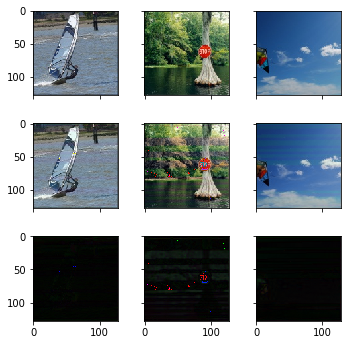


Epoch :  28 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1723795	 | Time     : 233.873909 |
Adversary | Loss  :  0.6793495	 | Accuracy :  0.8073074 |
Encoder   | Loss  :  0.0052796	 | Accuracy :  0.7113605 |
Decoder   | Loss  :  0.1674096	 | Accuracy :  0.7125709 |
Adversary | Loss  :  1.2741035	 | Accuracy :  0.1351351 |

Validation - 
Validate  | Loss  :  0.1723640	 | Time     :  19.592360 |
Encoder   | Loss  :  0.0052822	 | Accuracy :  0.7118694 |
Decoder   | Loss  :  0.1679674	 | Accuracy :  0.7109103 |
Adversary | Loss  :  0.6990921	 | Accuracy :  0.4673694 |


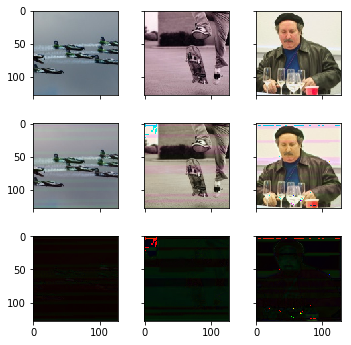


Epoch :  29 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1743450	 | Time     : 234.127900 |
Adversary | Loss  :  1.0730515	 | Accuracy :  0.7859110 |
Encoder   | Loss  :  0.0056732	 | Accuracy :  0.7180210 |
Decoder   | Loss  :  0.1678646	 | Accuracy :  0.7129546 |
Adversary | Loss  :  2.5091758	 | Accuracy :  0.1014765 |

Validation - 
Validate  | Loss  :  0.1868306	 | Time     :  19.592940 |
Encoder   | Loss  :  0.0216368	 | Accuracy :  0.6165134 |
Decoder   | Loss  :  0.1697901	 | Accuracy :  0.7071452 |
Adversary | Loss  :  1.8947221	 | Accuracy :  0.2153614 |


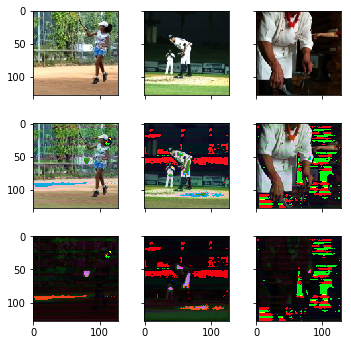


Epoch :  30 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1759798	 | Time     : 234.180089 |
Adversary | Loss  :  4.9257369	 | Accuracy :  0.3278904 |
Encoder   | Loss  :  0.0063356	 | Accuracy :  0.7056261 |
Decoder   | Loss  :  0.1670186	 | Accuracy :  0.7136971 |
Adversary | Loss  :  4.5262637	 | Accuracy :  0.3273273 |

Validation - 
Validate  | Loss  :  0.1714615	 | Time     :  19.721071 |
Encoder   | Loss  :  0.0026007	 | Accuracy :  0.7710655 |
Decoder   | Loss  :  0.1687931	 | Accuracy :  0.7075134 |
Adversary | Loss  :  0.8479153	 | Accuracy :  0.6139558 |


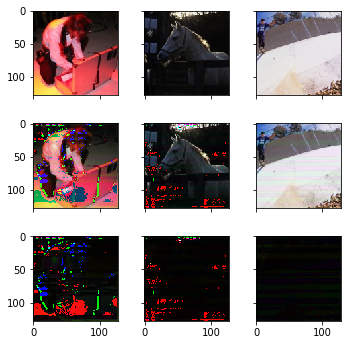


Epoch :  31 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1711003	 | Time     : 234.634328 |
Adversary | Loss  :  0.7055005	 | Accuracy :  0.5401026 |
Encoder   | Loss  :  0.0048396	 | Accuracy :  0.7186608 |
Decoder   | Loss  :  0.1669918	 | Accuracy :  0.7132591 |
Adversary | Loss  :  0.7206824	 | Accuracy :  0.4410661 |

Validation - 
Validate  | Loss  :  0.1735538	 | Time     :  19.746292 |
Encoder   | Loss  :  0.0077701	 | Accuracy :  0.7486163 |
Decoder   | Loss  :  0.1674099	 | Accuracy :  0.7090194 |
Adversary | Loss  :  0.7047923	 | Accuracy :  0.6199799 |


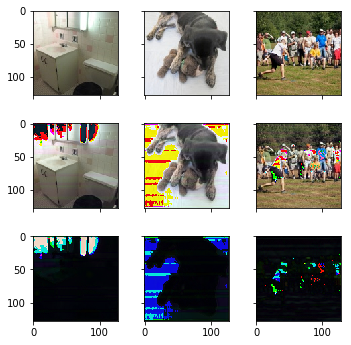


Epoch :  32 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1705067	 | Time     : 233.690028 |
Adversary | Loss  :  0.6518720	 | Accuracy :  0.6495871 |
Encoder   | Loss  :  0.0044463	 | Accuracy :  0.7217453 |
Decoder   | Loss  :  0.1666387	 | Accuracy :  0.7142559 |
Adversary | Loss  :  0.7554948	 | Accuracy :  0.3250751 |

Validation - 
Validate  | Loss  :  0.1693329	 | Time     :  19.824896 |
Encoder   | Loss  :  0.0025498	 | Accuracy :  0.7521905 |
Decoder   | Loss  :  0.1669458	 | Accuracy :  0.7110275 |
Adversary | Loss  :  0.6021465	 | Accuracy :  0.8765060 |


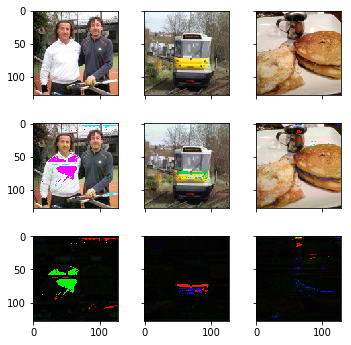


Epoch :  33 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1718653	 | Time     : 232.740632 |
Adversary | Loss  :  0.4610314	 | Accuracy :  0.8806931 |
Encoder   | Loss  :  0.0050144	 | Accuracy :  0.7194635 |
Decoder   | Loss  :  0.1671621	 | Accuracy :  0.7130505 |
Adversary | Loss  :  1.1931422	 | Accuracy :  0.0729479 |

Validation - 
Validate  | Loss  :  0.1712144	 | Time     :  18.682068 |
Encoder   | Loss  :  0.0035814	 | Accuracy :  0.7452605 |
Decoder   | Loss  :  0.1682369	 | Accuracy :  0.7096386 |
Adversary | Loss  :  0.4705472	 | Accuracy :  0.9578313 |


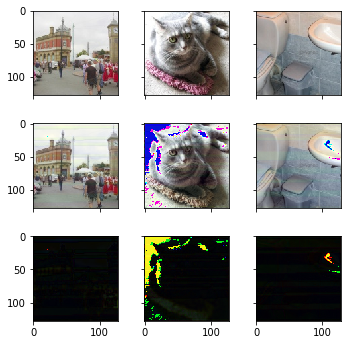


Epoch :  34 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1806234	 | Time     : 234.431183 |
Adversary | Loss  :  0.3572609	 | Accuracy :  0.8952703 |
Encoder   | Loss  :  0.0115454	 | Accuracy :  0.7280850 |
Decoder   | Loss  :  0.1698844	 | Accuracy :  0.7090382 |
Adversary | Loss  :  2.6571598	 | Accuracy :  0.0396647 |

Validation - 
Validate  | Loss  :  0.2452061	 | Time     :  19.625460 |
Encoder   | Loss  :  0.0950147	 | Accuracy :  0.6312357 |
Decoder   | Loss  :  0.1786767	 | Accuracy :  0.6966533 |
Adversary | Loss  :  0.0191499	 | Accuracy :  0.9989960 |


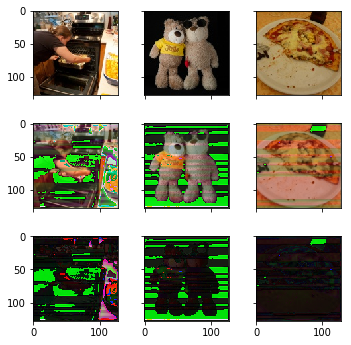


Epoch :  35 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1889710	 | Time     : 233.424772 |
Adversary | Loss  :  1.5322422	 | Accuracy :  0.6880006 |
Encoder   | Loss  :  0.0158010	 | Accuracy :  0.6510105 |
Decoder   | Loss  :  0.1728682	 | Accuracy :  0.7050050 |
Adversary | Loss  :  5.0421624	 | Accuracy :  0.2525025 |

Validation - 
Validate  | Loss  :  0.1707086	 | Time     :  19.519574 |
Encoder   | Loss  :  0.0039443	 | Accuracy :  0.7286702 |
Decoder   | Loss  :  0.1673974	 | Accuracy :  0.7109773 |
Adversary | Loss  :  0.5502500	 | Accuracy :  0.9046184 |


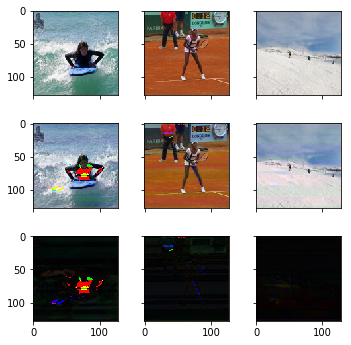


Epoch :  36 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1710248	 | Time     : 233.667330 |
Adversary | Loss  :  0.6321609	 | Accuracy :  0.7015766 |
Encoder   | Loss  :  0.0074841	 | Accuracy :  0.6947441 |
Decoder   | Loss  :  0.1650072	 | Accuracy :  0.7202829 |
Adversary | Loss  :  0.7787639	 | Accuracy :  0.2905405 |

Validation - 
Validate  | Loss  :  0.1666051	 | Time     :  19.620767 |
Encoder   | Loss  :  0.0039942	 | Accuracy :  0.7178031 |
Decoder   | Loss  :  0.1631729	 | Accuracy :  0.7195616 |
Adversary | Loss  :  0.6362347	 | Accuracy :  0.6907631 |


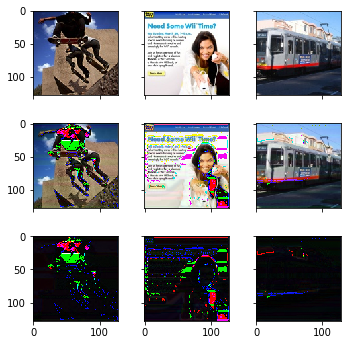


Epoch :  37 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1681916	 | Time     : 233.926018 |
Adversary | Loss  :  0.4631858	 | Accuracy :  0.9094719 |
Encoder   | Loss  :  0.0052561	 | Accuracy :  0.7147519 |
Decoder   | Loss  :  0.1634007	 | Accuracy :  0.7236737 |
Adversary | Loss  :  1.1116104	 | Accuracy :  0.0614364 |

Validation - 
Validate  | Loss  :  0.1673393	 | Time     :  19.652173 |
Encoder   | Loss  :  0.0053312	 | Accuracy :  0.7371445 |
Decoder   | Loss  :  0.1633076	 | Accuracy :  0.7226740 |
Adversary | Loss  :  0.2998838	 | Accuracy :  0.9784136 |


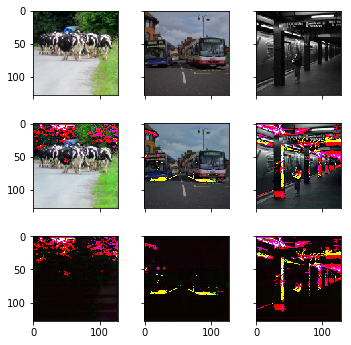


Epoch :  38 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1784799	 | Time     : 233.495106 |
Adversary | Loss  :  2.5191076	 | Accuracy :  0.6639138 |
Encoder   | Loss  :  0.0094932	 | Accuracy :  0.6835477 |
Decoder   | Loss  :  0.1648797	 | Accuracy :  0.7211837 |
Adversary | Loss  :  6.9550076	 | Accuracy :  0.0719470 |

Validation - 
Validate  | Loss  :  0.1774512	 | Time     :  19.424221 |
Encoder   | Loss  :  0.0064748	 | Accuracy :  0.6906961 |
Decoder   | Loss  :  0.1624887	 | Accuracy :  0.7246653 |
Adversary | Loss  : 10.4302359	 | Accuracy :  0.1325301 |


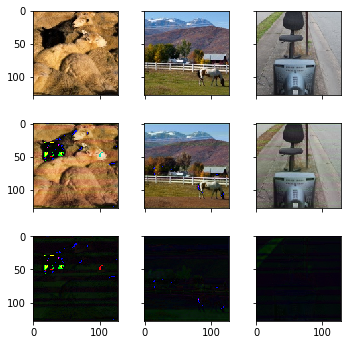


Epoch :  39 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1728439	 | Time     : 234.113654 |
Adversary | Loss  :  6.9559550	 | Accuracy :  0.1793043 |
Encoder   | Loss  :  0.0063614	 | Accuracy :  0.6901996 |
Decoder   | Loss  :  0.1615054	 | Accuracy :  0.7257091 |
Adversary | Loss  :  6.8855419	 | Accuracy :  0.1719219 |

Validation - 
Validate  | Loss  :  0.1727909	 | Time     :  19.765346 |
Encoder   | Loss  :  0.0069277	 | Accuracy :  0.7105615 |
Decoder   | Loss  :  0.1611148	 | Accuracy :  0.7224899 |
Adversary | Loss  :  6.8267365	 | Accuracy :  0.2560241 |


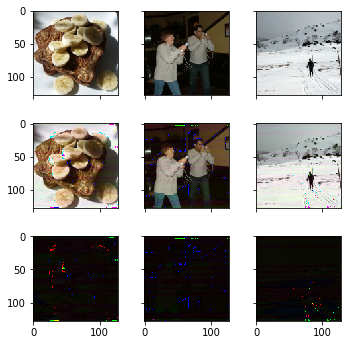


Epoch :  40 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1677325	 | Time     : 233.863385 |
Adversary | Loss  :  5.4204435	 | Accuracy :  0.3235110 |
Encoder   | Loss  :  0.0050497	 | Accuracy :  0.7236000 |
Decoder   | Loss  :  0.1607144	 | Accuracy :  0.7261053 |
Adversary | Loss  :  3.4834006	 | Accuracy :  0.3755005 |

Validation - 
Validate  | Loss  :  0.1682727	 | Time     :  19.676948 |
Encoder   | Loss  :  0.0040321	 | Accuracy :  0.7592482 |
Decoder   | Loss  :  0.1613327	 | Accuracy :  0.7234773 |
Adversary | Loss  :  4.1175008	 | Accuracy :  0.3609438 |


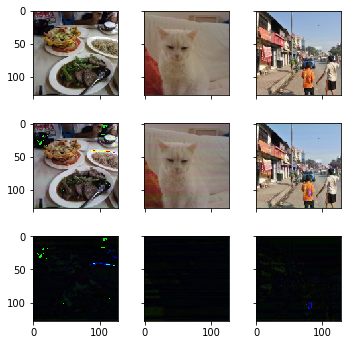


Epoch :  41 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1650480	 | Time     : 233.470172 |
Adversary | Loss  :  1.2221955	 | Accuracy :  0.5318444 |
Encoder   | Loss  :  0.0049318	 | Accuracy :  0.7250821 |
Decoder   | Loss  :  0.1603956	 | Accuracy :  0.7265182 |
Adversary | Loss  :  1.2002258	 | Accuracy :  0.4831081 |

Validation - 
Validate  | Loss  :  0.1662426	 | Time     :  19.835983 |
Encoder   | Loss  :  0.0042618	 | Accuracy :  0.6944541 |
Decoder   | Loss  :  0.1606237	 | Accuracy :  0.7240796 |
Adversary | Loss  :  2.6356065	 | Accuracy :  0.1832329 |


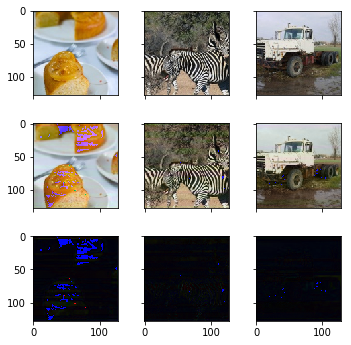


Epoch :  42 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1635819	 | Time     : 232.788193 |
Adversary | Loss  :  0.6617046	 | Accuracy :  0.6295670 |
Encoder   | Loss  :  0.0043437	 | Accuracy :  0.7314793 |
Decoder   | Loss  :  0.1597870	 | Accuracy :  0.7270020 |
Adversary | Loss  :  0.7542760	 | Accuracy :  0.3881381 |

Validation - 
Validate  | Loss  :  0.1641975	 | Time     :  19.839317 |
Encoder   | Loss  :  0.0023108	 | Accuracy :  0.7771454 |
Decoder   | Loss  :  0.1610219	 | Accuracy :  0.7227076 |
Adversary | Loss  :  1.5581285	 | Accuracy :  0.3955823 |


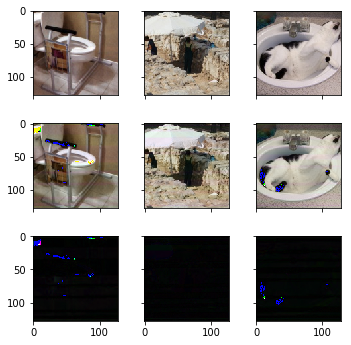


Epoch :  43 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1633383	 | Time     : 233.127090 |
Adversary | Loss  :  0.5957636	 | Accuracy :  0.7365490 |
Encoder   | Loss  :  0.0041039	 | Accuracy :  0.7397192 |
Decoder   | Loss  :  0.1596319	 | Accuracy :  0.7266350 |
Adversary | Loss  :  0.8336751	 | Accuracy :  0.2351101 |

Validation - 
Validate  | Loss  :  0.1627582	 | Time     :  19.607507 |
Encoder   | Loss  :  0.0020098	 | Accuracy :  0.7793694 |
Decoder   | Loss  :  0.1608115	 | Accuracy :  0.7217035 |
Adversary | Loss  :  0.5399087	 | Accuracy :  0.9166666 |


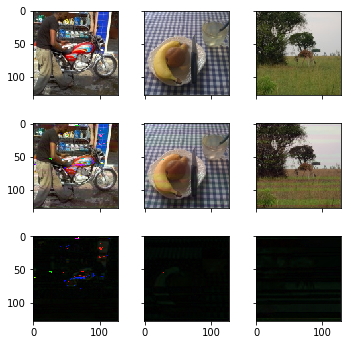


Epoch :  44 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1636489	 | Time     : 233.486773 |
Adversary | Loss  :  0.5086133	 | Accuracy :  0.8262012 |
Encoder   | Loss  :  0.0038635	 | Accuracy :  0.7427260 |
Decoder   | Loss  :  0.1598331	 | Accuracy :  0.7268184 |
Adversary | Loss  :  1.1113700	 | Accuracy :  0.1018518 |

Validation - 
Validate  | Loss  :  0.1656223	 | Time     :  19.563428 |
Encoder   | Loss  :  0.0025989	 | Accuracy :  0.7889546 |
Decoder   | Loss  :  0.1633932	 | Accuracy :  0.7216198 |
Adversary | Loss  :  0.4097794	 | Accuracy :  0.9748996 |


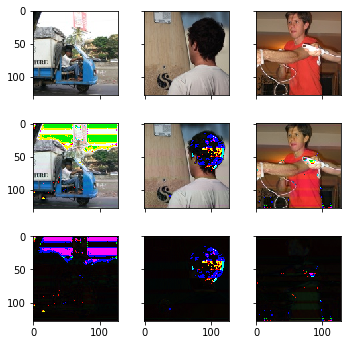


Epoch :  45 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1651356	 | Time     : 233.791841 |
Adversary | Loss  :  0.7535660	 | Accuracy :  0.7790291 |
Encoder   | Loss  :  0.0044316	 | Accuracy :  0.7492299 |
Decoder   | Loss  :  0.1602862	 | Accuracy :  0.7258092 |
Adversary | Loss  :  1.7473063	 | Accuracy :  0.1768018 |

Validation - 
Validate  | Loss  :  0.1633109	 | Time     :  19.718367 |
Encoder   | Loss  :  0.0032866	 | Accuracy :  0.7458739 |
Decoder   | Loss  :  0.1598802	 | Accuracy :  0.7236947 |
Adversary | Loss  :  1.1300957	 | Accuracy :  0.1285141 |


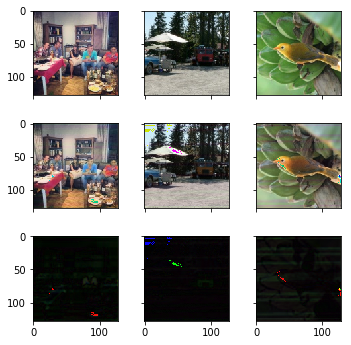


Epoch :  46 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1673968	 | Time     : 234.084732 |
Adversary | Loss  :  1.2813789	 | Accuracy :  0.7316691 |
Encoder   | Loss  :  0.0080977	 | Accuracy :  0.7026027 |
Decoder   | Loss  :  0.1599037	 | Accuracy :  0.7260051 |
Adversary | Loss  :  1.8247465	 | Accuracy :  0.2321071 |

Validation - 
Validate  | Loss  :  0.1644612	 | Time     :  19.563248 |
Encoder   | Loss  :  0.0040383	 | Accuracy :  0.7451324 |
Decoder   | Loss  :  0.1611358	 | Accuracy :  0.7215528 |
Adversary | Loss  :  0.4984817	 | Accuracy :  0.9272088 |


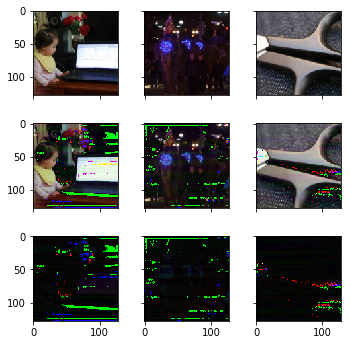


Epoch :  47 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1656412	 | Time     : 234.315646 |
Adversary | Loss  :  0.3524420	 | Accuracy :  0.9186687 |
Encoder   | Loss  :  0.0048963	 | Accuracy :  0.7432924 |
Decoder   | Loss  :  0.1602033	 | Accuracy :  0.7264515 |
Adversary | Loss  :  2.0104723	 | Accuracy :  0.0412913 |

Validation - 
Validate  | Loss  :  0.1676136	 | Time     :  19.587288 |
Encoder   | Loss  :  0.0060295	 | Accuracy :  0.7886064 |
Decoder   | Loss  :  0.1631615	 | Accuracy :  0.7197289 |
Adversary | Loss  :  0.2314643	 | Accuracy :  0.9754016 |


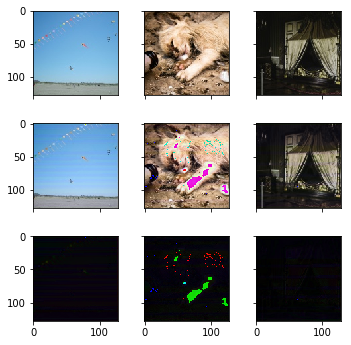


Epoch :  48 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1743787	 | Time     : 234.057847 |
Adversary | Loss  :  0.2818848	 | Accuracy :  0.9069694 |
Encoder   | Loss  :  0.0093050	 | Accuracy :  0.7303498 |
Decoder   | Loss  :  0.1632156	 | Accuracy :  0.7213922 |
Adversary | Loss  :  4.6496387	 | Accuracy :  0.0345345 |

Validation - 
Validate  | Loss  :  0.2253977	 | Time     :  19.757436 |
Encoder   | Loss  :  0.0730978	 | Accuracy :  0.6593292 |
Decoder   | Loss  :  0.1741316	 | Accuracy :  0.7017068 |
Adversary | Loss  :  0.0976603	 | Accuracy :  0.7530121 |


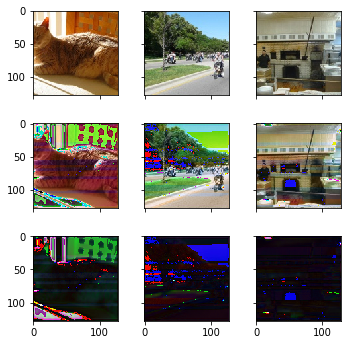


Epoch :  49 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1674825	 | Time     : 233.296437 |
Adversary | Loss  :  4.7984056	 | Accuracy :  0.3813188 |
Encoder   | Loss  :  0.0062034	 | Accuracy :  0.7312473 |
Decoder   | Loss  :  0.1603641	 | Accuracy :  0.7262805 |
Adversary | Loss  :  2.7760649	 | Accuracy :  0.2148399 |

Validation - 
Validate  | Loss  :  0.1723029	 | Time     :  19.861205 |
Encoder   | Loss  :  0.0048852	 | Accuracy :  0.7190186 |
Decoder   | Loss  :  0.1602482	 | Accuracy :  0.7228246 |
Adversary | Loss  :  8.6350288	 | Accuracy :  0.2670683 |


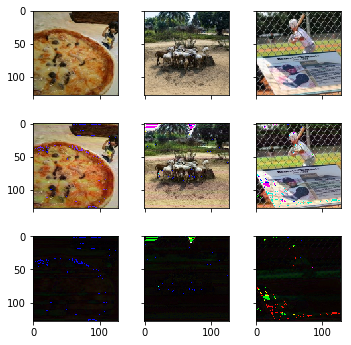


Epoch :  50 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1633314	 | Time     : 234.300083 |
Adversary | Loss  :  2.4243679	 | Accuracy :  0.4612112 |
Encoder   | Loss  :  0.0039453	 | Accuracy :  0.7477142 |
Decoder   | Loss  :  0.1590226	 | Accuracy :  0.7274650 |
Adversary | Loss  :  1.5471213	 | Accuracy :  0.3960210 |

Validation - 
Validate  | Loss  :  0.1623326	 | Time     :  19.802950 |
Encoder   | Loss  :  0.0019100	 | Accuracy :  0.7809684 |
Decoder   | Loss  :  0.1599228	 | Accuracy :  0.7238956 |
Adversary | Loss  :  1.0727882	 | Accuracy :  0.5466868 |


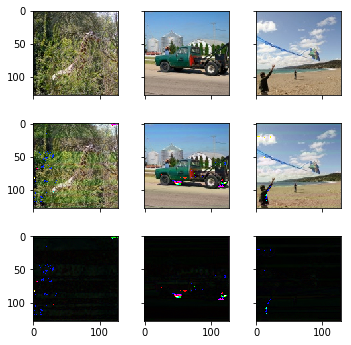


Epoch :  51 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1620734	 | Time     : 234.580533 |
Adversary | Loss  :  0.6856300	 | Accuracy :  0.6281281 |
Encoder   | Loss  :  0.0034756	 | Accuracy :  0.7593337 |
Decoder   | Loss  :  0.1588133	 | Accuracy :  0.7273190 |
Adversary | Loss  :  0.8272403	 | Accuracy :  0.3044294 |

Validation - 
Validate  | Loss  :  0.1639349	 | Time     :  19.717307 |
Encoder   | Loss  :  0.0033568	 | Accuracy :  0.7524692 |
Decoder   | Loss  :  0.1604509	 | Accuracy :  0.7223728 |
Adversary | Loss  :  1.1342580	 | Accuracy :  0.4728916 |


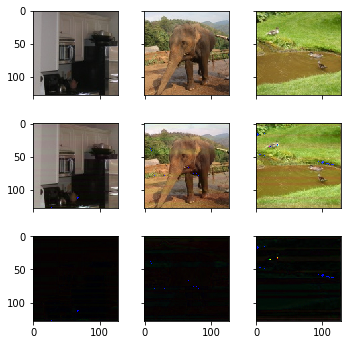


Epoch :  52 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1629461	 | Time     : 234.462441 |
Adversary | Loss  :  0.5253333	 | Accuracy :  0.7939814 |
Encoder   | Loss  :  0.0040400	 | Accuracy :  0.7647842 |
Decoder   | Loss  :  0.1590581	 | Accuracy :  0.7275150 |
Adversary | Loss  :  1.0600193	 | Accuracy :  0.1447698 |

Validation - 
Validate  | Loss  :  0.1640675	 | Time     :  19.820257 |
Encoder   | Loss  :  0.0045319	 | Accuracy :  0.7142773 |
Decoder   | Loss  :  0.1606407	 | Accuracy :  0.7236947 |
Adversary | Loss  :  0.2544174	 | Accuracy :  0.9723895 |


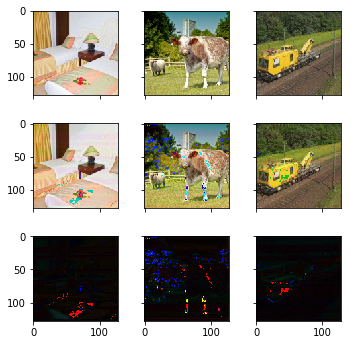


Epoch :  53 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1637093	 | Time     : 233.317916 |
Adversary | Loss  :  0.6044360	 | Accuracy :  0.8016141 |
Encoder   | Loss  :  0.0037047	 | Accuracy :  0.7660717 |
Decoder   | Loss  :  0.1594920	 | Accuracy :  0.7268352 |
Adversary | Loss  :  1.6239666	 | Accuracy :  0.1496496 |

Validation - 
Validate  | Loss  :  0.1615536	 | Time     :  19.628209 |
Encoder   | Loss  :  0.0014559	 | Accuracy :  0.8097446 |
Decoder   | Loss  :  0.1601386	 | Accuracy :  0.7240964 |
Adversary | Loss  :  0.3959327	 | Accuracy :  0.9206827 |


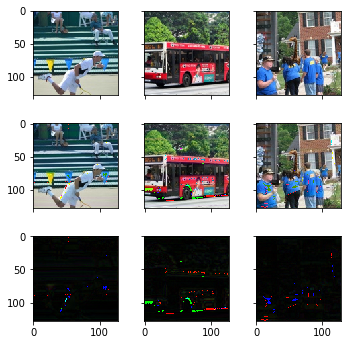


Epoch :  54 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1641676	 | Time     : 233.273376 |
Adversary | Loss  :  0.3764885	 | Accuracy :  0.8929554 |
Encoder   | Loss  :  0.0035113	 | Accuracy :  0.7720767 |
Decoder   | Loss  :  0.1596160	 | Accuracy :  0.7270979 |
Adversary | Loss  :  2.0935986	 | Accuracy :  0.0459209 |

Validation - 
Validate  | Loss  :  0.1649035	 | Time     :  19.516834 |
Encoder   | Loss  :  0.0045043	 | Accuracy :  0.8080492 |
Decoder   | Loss  :  0.1615476	 | Accuracy :  0.7211346 |
Adversary | Loss  :  0.2028083	 | Accuracy :  0.9804217 |


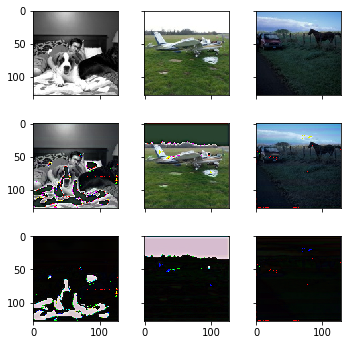


Epoch :  55 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1662127	 | Time     : 233.479476 |
Adversary | Loss  :  3.0854812	 | Accuracy :  0.5010635 |
Encoder   | Loss  :  0.0035400	 | Accuracy :  0.7661706 |
Decoder   | Loss  :  0.1590521	 | Accuracy :  0.7274274 |
Adversary | Loss  :  4.6825862	 | Accuracy :  0.3005506 |

Validation - 
Validate  | Loss  :  0.1622345	 | Time     :  19.473029 |
Encoder   | Loss  :  0.0017250	 | Accuracy :  0.7910036 |
Decoder   | Loss  :  0.1604306	 | Accuracy :  0.7239792 |
Adversary | Loss  :  0.5964176	 | Accuracy :  0.8037148 |


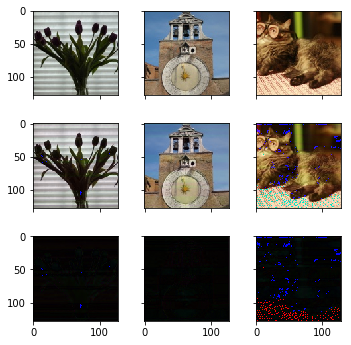


Epoch :  56 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1613401	 | Time     : 233.815479 |
Adversary | Loss  :  0.5987452	 | Accuracy :  0.7248498 |
Encoder   | Loss  :  0.0028933	 | Accuracy :  0.7779024 |
Decoder   | Loss  :  0.1584565	 | Accuracy :  0.7293919 |
Adversary | Loss  :  0.8583128	 | Accuracy :  0.2189690 |

Validation - 
Validate  | Loss  :  0.1638336	 | Time     :  19.825506 |
Encoder   | Loss  :  0.0048509	 | Accuracy :  0.7670881 |
Decoder   | Loss  :  0.1601582	 | Accuracy :  0.7234102 |
Adversary | Loss  :  0.2798224	 | Accuracy :  0.9733936 |


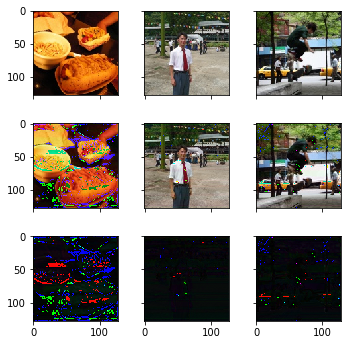


Epoch :  57 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1624531	 | Time     : 234.328031 |
Adversary | Loss  :  0.4463563	 | Accuracy :  0.8602977 |
Encoder   | Loss  :  0.0031446	 | Accuracy :  0.7784103 |
Decoder   | Loss  :  0.1589205	 | Accuracy :  0.7280698 |
Adversary | Loss  :  1.3314154	 | Accuracy :  0.0973473 |

Validation - 
Validate  | Loss  :  0.1649219	 | Time     :  19.499639 |
Encoder   | Loss  :  0.0030518	 | Accuracy :  0.7749156 |
Decoder   | Loss  :  0.1623688	 | Accuracy :  0.7204652 |
Adversary | Loss  :  0.4168862	 | Accuracy :  0.9081326 |


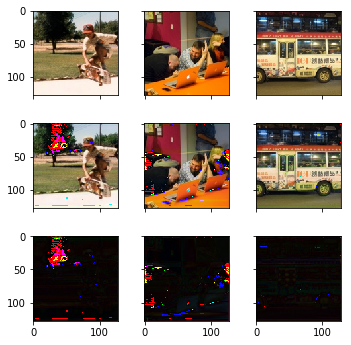


Epoch :  58 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1656876	 | Time     : 233.717474 |
Adversary | Loss  :  1.2968286	 | Accuracy :  0.7454955 |
Encoder   | Loss  :  0.0045765	 | Accuracy :  0.7721524 |
Decoder   | Loss  :  0.1593844	 | Accuracy :  0.7285410 |
Adversary | Loss  :  3.0996065	 | Accuracy :  0.1433934 |

Validation - 
Validate  | Loss  :  0.1736670	 | Time     :  19.622676 |
Encoder   | Loss  :  0.0145961	 | Accuracy :  0.7186374 |
Decoder   | Loss  :  0.1611803	 | Accuracy :  0.7184070 |
Adversary | Loss  :  2.2694046	 | Accuracy :  0.5040160 |


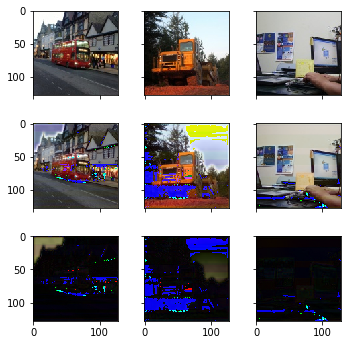


Epoch :  59 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1661116	 | Time     : 233.604220 |
Adversary | Loss  :  0.5392855	 | Accuracy :  0.8250751 |
Encoder   | Loss  :  0.0053154	 | Accuracy :  0.7632805 |
Decoder   | Loss  :  0.1603118	 | Accuracy :  0.7263889 |
Adversary | Loss  :  2.0789595	 | Accuracy :  0.1123624 |

Validation - 
Validate  | Loss  :  0.1697285	 | Time     :  19.898600 |
Encoder   | Loss  :  0.0050639	 | Accuracy :  0.7589791 |
Decoder   | Loss  :  0.1656107	 | Accuracy :  0.7166667 |
Adversary | Loss  :  0.5731241	 | Accuracy :  0.7484940 |


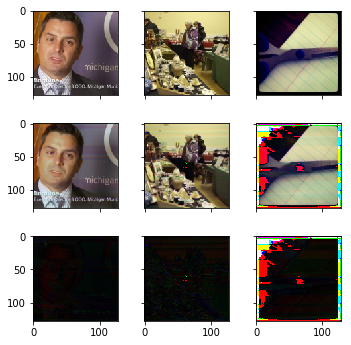


Epoch :  60 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1669128	 | Time     : 233.885356 |
Adversary | Loss  :  0.4397395	 | Accuracy :  0.8454705 |
Encoder   | Loss  :  0.0051905	 | Accuracy :  0.7534527 |
Decoder   | Loss  :  0.1611590	 | Accuracy :  0.7255381 |
Adversary | Loss  :  2.1204352	 | Accuracy :  0.1351351 |

Validation - 
Validate  | Loss  :  0.1648471	 | Time     :  19.950909 |
Encoder   | Loss  :  0.0032273	 | Accuracy :  0.7781699 |
Decoder   | Loss  :  0.1618042	 | Accuracy :  0.7200636 |
Adversary | Loss  :  0.7837533	 | Accuracy :  0.5060241 |


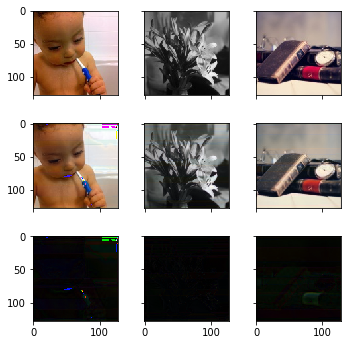


Epoch :  61 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1758685	 | Time     : 234.605285 |
Adversary | Loss  :  1.5413173	 | Accuracy :  0.7137763 |
Encoder   | Loss  :  0.0127170	 | Accuracy :  0.7313669 |
Decoder   | Loss  :  0.1615459	 | Accuracy :  0.7253671 |
Adversary | Loss  :  5.4207425	 | Accuracy :  0.1482733 |

Validation - 
Validate  | Loss  :  0.1617030	 | Time     :  19.607208 |
Encoder   | Loss  :  0.0027705	 | Accuracy :  0.7729299 |
Decoder   | Loss  :  0.1596552	 | Accuracy :  0.7264223 |
Adversary | Loss  :  0.1084133	 | Accuracy :  0.5486947 |


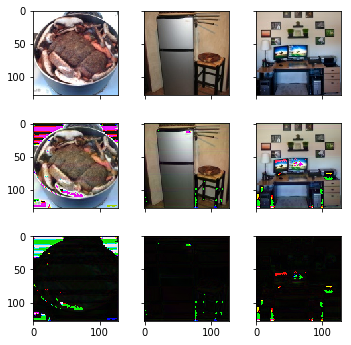


Epoch :  62 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1681722	 | Time     : 233.231174 |
Adversary | Loss  :  3.9443364	 | Accuracy :  0.3847598 |
Encoder   | Loss  :  0.0047642	 | Accuracy :  0.7499495 |
Decoder   | Loss  :  0.1582160	 | Accuracy :  0.7301593 |
Adversary | Loss  :  6.6213636	 | Accuracy :  0.2997998 |

Validation - 
Validate  | Loss  :  0.1670258	 | Time     :  19.821414 |
Encoder   | Loss  :  0.0031670	 | Accuracy :  0.7773884 |
Decoder   | Loss  :  0.1590632	 | Accuracy :  0.7270750 |
Adversary | Loss  :  5.7456522	 | Accuracy :  0.3278112 |


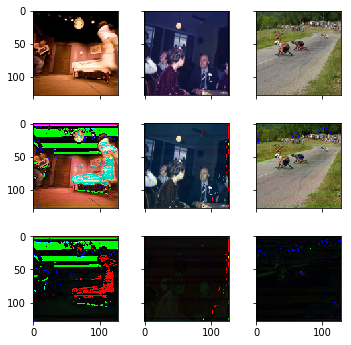


Epoch :  63 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1638625	 | Time     : 233.916038 |
Adversary | Loss  :  2.7441406	 | Accuracy :  0.4826702 |
Encoder   | Loss  :  0.0035655	 | Accuracy :  0.7637606 |
Decoder   | Loss  :  0.1574513	 | Accuracy :  0.7327411 |
Adversary | Loss  :  3.9152927	 | Accuracy :  0.3587338 |

Validation - 
Validate  | Loss  :  0.1608399	 | Time     :  19.784984 |
Encoder   | Loss  :  0.0021283	 | Accuracy :  0.8061235 |
Decoder   | Loss  :  0.1583426	 | Accuracy :  0.7296519 |
Adversary | Loss  :  1.0075258	 | Accuracy :  0.4954819 |


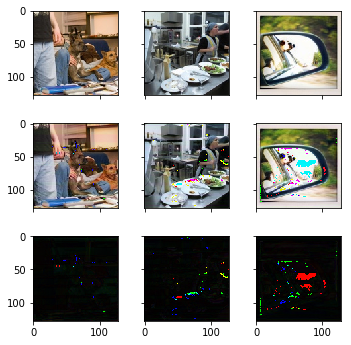


Epoch :  64 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1597536	 | Time     : 233.723567 |
Adversary | Loss  :  0.6390529	 | Accuracy :  0.6832458 |
Encoder   | Loss  :  0.0028705	 | Accuracy :  0.7731149 |
Decoder   | Loss  :  0.1568484	 | Accuracy :  0.7349933 |
Adversary | Loss  :  0.8958436	 | Accuracy :  0.2836587 |

Validation - 
Validate  | Loss  :  0.1599950	 | Time     :  19.538451 |
Encoder   | Loss  :  0.0019557	 | Accuracy :  0.7972539 |
Decoder   | Loss  :  0.1579785	 | Accuracy :  0.7331995 |
Adversary | Loss  :  0.6475207	 | Accuracy :  0.7319277 |


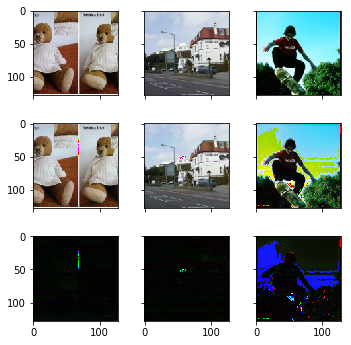


Epoch :  65 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1594869	 | Time     : 233.267298 |
Adversary | Loss  :  0.5304637	 | Accuracy :  0.7967342 |
Encoder   | Loss  :  0.0026690	 | Accuracy :  0.7850250 |
Decoder   | Loss  :  0.1565774	 | Accuracy :  0.7367117 |
Adversary | Loss  :  1.0411844	 | Accuracy :  0.1560310 |

Validation - 
Validate  | Loss  :  0.1621802	 | Time     :  19.693615 |
Encoder   | Loss  :  0.0035780	 | Accuracy :  0.7931636 |
Decoder   | Loss  :  0.1593700	 | Accuracy :  0.7297524 |
Adversary | Loss  :  0.3056222	 | Accuracy :  0.9226908 |


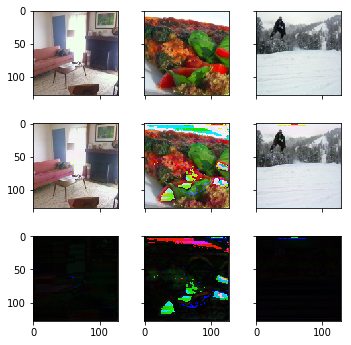


Epoch :  66 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1601397	 | Time     : 233.272558 |
Adversary | Loss  :  0.4464526	 | Accuracy :  0.8450326 |
Encoder   | Loss  :  0.0027866	 | Accuracy :  0.7848260 |
Decoder   | Loss  :  0.1567565	 | Accuracy :  0.7376543 |
Adversary | Loss  :  1.4326268	 | Accuracy :  0.1159910 |

Validation - 
Validate  | Loss  :  0.1617741	 | Time     :  19.374380 |
Encoder   | Loss  :  0.0023318	 | Accuracy :  0.8076127 |
Decoder   | Loss  :  0.1589152	 | Accuracy :  0.7310743 |
Adversary | Loss  :  1.2267237	 | Accuracy :  0.4241968 |


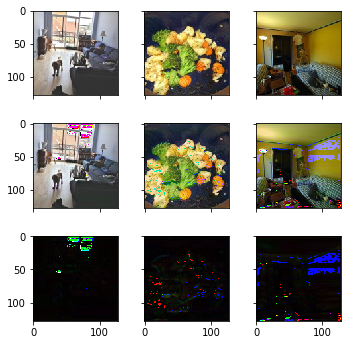


Epoch :  67 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1605368	 | Time     : 233.705415 |
Adversary | Loss  :  0.7891076	 | Accuracy :  0.7620745 |
Encoder   | Loss  :  0.0030360	 | Accuracy :  0.7810751 |
Decoder   | Loss  :  0.1565835	 | Accuracy :  0.7378253 |
Adversary | Loss  :  1.8280888	 | Accuracy :  0.2008258 |

Validation - 
Validate  | Loss  :  0.1624255	 | Time     :  19.692772 |
Encoder   | Loss  :  0.0066673	 | Accuracy :  0.6785919 |
Decoder   | Loss  :  0.1564256	 | Accuracy :  0.7362283 |
Adversary | Loss  :  1.3327909	 | Accuracy :  0.3037148 |


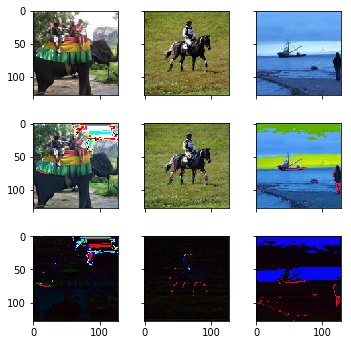


Epoch :  68 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1600583	 | Time     : 233.498341 |
Adversary | Loss  :  2.5402107	 | Accuracy :  0.4884885 |
Encoder   | Loss  :  0.0028515	 | Accuracy :  0.7832639 |
Decoder   | Loss  :  0.1551751	 | Accuracy :  0.7415665 |
Adversary | Loss  :  2.8870740	 | Accuracy :  0.4379379 |

Validation - 
Validate  | Loss  :  0.1603501	 | Time     :  19.530188 |
Encoder   | Loss  :  0.0015784	 | Accuracy :  0.8319858 |
Decoder   | Loss  :  0.1564215	 | Accuracy :  0.7357932 |
Adversary | Loss  :  2.8237462	 | Accuracy :  0.5928715 |


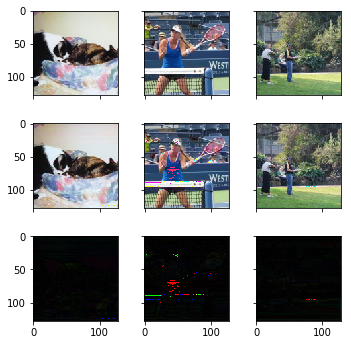


Epoch :  69 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1575541	 | Time     : 233.390911 |
Adversary | Loss  :  0.6766222	 | Accuracy :  0.6757382 |
Encoder   | Loss  :  0.0025644	 | Accuracy :  0.7887931 |
Decoder   | Loss  :  0.1548088	 | Accuracy :  0.7417668 |
Adversary | Loss  :  0.9502589	 | Accuracy :  0.3046797 |

Validation - 
Validate  | Loss  :  0.1607423	 | Time     :  19.787025 |
Encoder   | Loss  :  0.0044408	 | Accuracy :  0.8104919 |
Decoder   | Loss  :  0.1569064	 | Accuracy :  0.7345549 |
Adversary | Loss  :  0.7272831	 | Accuracy :  0.5998996 |


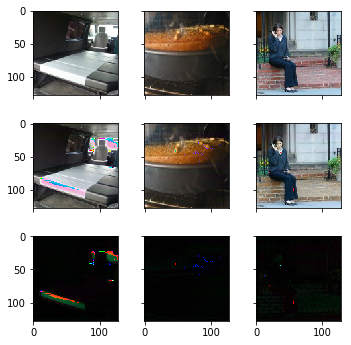


Epoch :  70 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1574164	 | Time     : 234.531969 |
Adversary | Loss  :  0.4784658	 | Accuracy :  0.8307682 |
Encoder   | Loss  :  0.0025021	 | Accuracy :  0.7943453 |
Decoder   | Loss  :  0.1545101	 | Accuracy :  0.7436562 |
Adversary | Loss  :  1.1548547	 | Accuracy :  0.1592843 |

Validation - 
Validate  | Loss  :  0.1574764	 | Time     :  19.859812 |
Encoder   | Loss  :  0.0021964	 | Accuracy :  0.7739031 |
Decoder   | Loss  :  0.1552991	 | Accuracy :  0.7401440 |
Adversary | Loss  :  0.6397325	 | Accuracy :  0.7399598 |


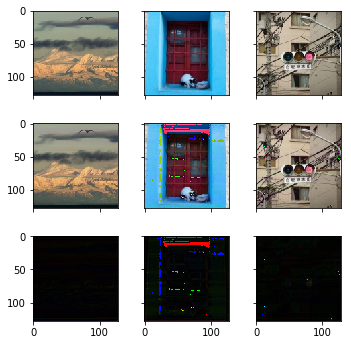


Epoch :  71 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1568942	 | Time     : 233.313655 |
Adversary | Loss  :  0.7246543	 | Accuracy :  0.7511261 |
Encoder   | Loss  :  0.0023458	 | Accuracy :  0.7938421 |
Decoder   | Loss  :  0.1540891	 | Accuracy :  0.7448531 |
Adversary | Loss  :  1.1629965	 | Accuracy :  0.2606356 |

Validation - 
Validate  | Loss  :  0.1573363	 | Time     :  19.590396 |
Encoder   | Loss  :  0.0029247	 | Accuracy :  0.7999598 |
Decoder   | Loss  :  0.1547303	 | Accuracy :  0.7405288 |
Adversary | Loss  :  0.5587033	 | Accuracy :  0.7344378 |


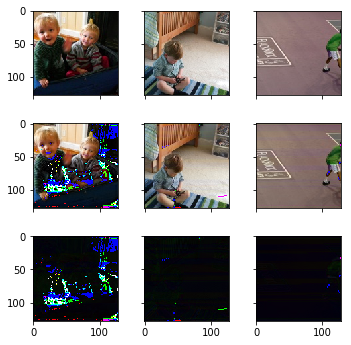


Epoch :  72 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1601122	 | Time     : 233.677953 |
Adversary | Loss  :  0.4506084	 | Accuracy :  0.8306432 |
Encoder   | Loss  :  0.0049881	 | Accuracy :  0.7843608 |
Decoder   | Loss  :  0.1549950	 | Accuracy :  0.7438813 |
Adversary | Loss  :  1.6254975	 | Accuracy :  0.1463964 |

Validation - 
Validate  | Loss  :  0.1605136	 | Time     :  19.667610 |
Encoder   | Loss  :  0.0037946	 | Accuracy :  0.8065856 |
Decoder   | Loss  :  0.1566453	 | Accuracy :  0.7371988 |
Adversary | Loss  :  1.2121034	 | Accuracy :  0.2359438 |


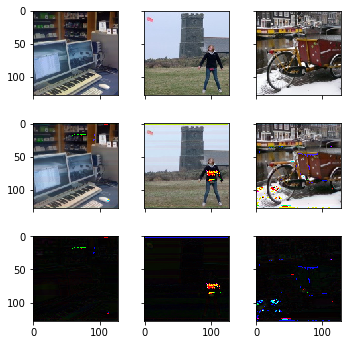


Epoch :  73 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1614828	 | Time     : 235.086926 |
Adversary | Loss  :  5.6417885	 | Accuracy :  0.3213839 |
Encoder   | Loss  :  0.0036482	 | Accuracy :  0.7665823 |
Decoder   | Loss  :  0.1533709	 | Accuracy :  0.7468635 |
Adversary | Loss  :  5.5581412	 | Accuracy :  0.2347347 |

Validation - 
Validate  | Loss  :  0.1563310	 | Time     :  19.411986 |
Encoder   | Loss  :  0.0018952	 | Accuracy :  0.7767268 |
Decoder   | Loss  :  0.1537083	 | Accuracy :  0.7438587 |
Adversary | Loss  :  1.2960709	 | Accuracy :  0.4272088 |


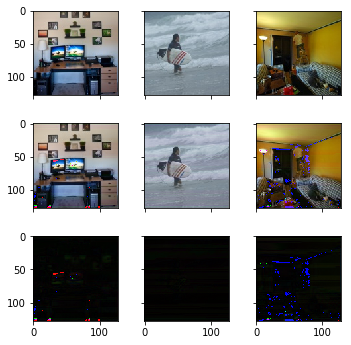


Epoch :  74 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1639256	 | Time     : 234.098350 |
Adversary | Loss  :  5.9979367	 | Accuracy :  0.3189439 |
Encoder   | Loss  :  0.0039219	 | Accuracy :  0.7470284 |
Decoder   | Loss  :  0.1524563	 | Accuracy :  0.7489031 |
Adversary | Loss  :  8.7239523	 | Accuracy :  0.1986987 |

Validation - 
Validate  | Loss  :  0.1600797	 | Time     :  19.763645 |
Encoder   | Loss  :  0.0046889	 | Accuracy :  0.7292368 |
Decoder   | Loss  :  0.1529309	 | Accuracy :  0.7465026 |
Adversary | Loss  :  3.8665359	 | Accuracy :  0.5025101 |


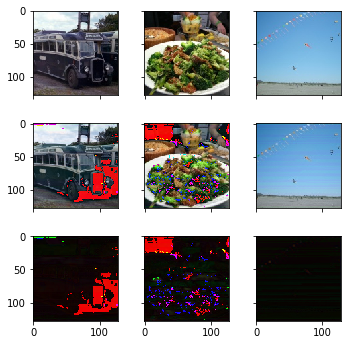


Epoch :  75 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1547980	 | Time     : 234.624457 |
Adversary | Loss  :  1.1884245	 | Accuracy :  0.6143643 |
Encoder   | Loss  :  0.0027020	 | Accuracy :  0.7708079 |
Decoder   | Loss  :  0.1517186	 | Accuracy :  0.7514181 |
Adversary | Loss  :  1.1880547	 | Accuracy :  0.4973724 |

Validation - 
Validate  | Loss  :  0.1537338	 | Time     :  19.550022 |
Encoder   | Loss  :  0.0016949	 | Accuracy :  0.7646170 |
Decoder   | Loss  :  0.1518129	 | Accuracy :  0.7480422 |
Adversary | Loss  :  0.7345235	 | Accuracy :  0.5150602 |


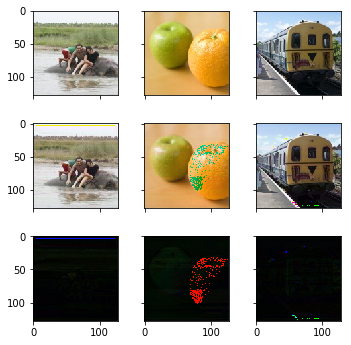


Epoch :  76 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1542223	 | Time     : 233.819410 |
Adversary | Loss  :  0.6740433	 | Accuracy :  0.7105856 |
Encoder   | Loss  :  0.0022141	 | Accuracy :  0.7956333 |
Decoder   | Loss  :  0.1514489	 | Accuracy :  0.7535911 |
Adversary | Loss  :  1.2235813	 | Accuracy :  0.2817818 |

Validation - 
Validate  | Loss  :  0.1536012	 | Time     :  19.442912 |
Encoder   | Loss  :  0.0018890	 | Accuracy :  0.8147643 |
Decoder   | Loss  :  0.1514642	 | Accuracy :  0.7493976 |
Adversary | Loss  :  0.8146616	 | Accuracy :  0.4984940 |


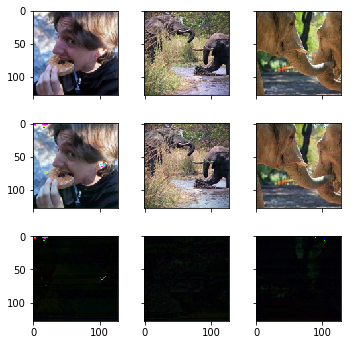


Epoch :  77 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1532517	 | Time     : 233.293581 |
Adversary | Loss  :  0.5384917	 | Accuracy :  0.7703953 |
Encoder   | Loss  :  0.0020969	 | Accuracy :  0.8013526 |
Decoder   | Loss  :  0.1507938	 | Accuracy :  0.7542835 |
Adversary | Loss  :  0.9900280	 | Accuracy :  0.2050801 |

Validation - 
Validate  | Loss  :  0.1528634	 | Time     :  19.574400 |
Encoder   | Loss  :  0.0013404	 | Accuracy :  0.8184385 |
Decoder   | Loss  :  0.1514371	 | Accuracy :  0.7504016 |
Adversary | Loss  :  0.4879662	 | Accuracy :  0.9161647 |


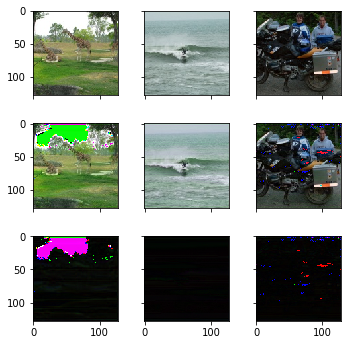


Epoch :  78 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1543015	 | Time     : 233.808295 |
Adversary | Loss  :  0.5497961	 | Accuracy :  0.7785285 |
Encoder   | Loss  :  0.0031969	 | Accuracy :  0.7921931 |
Decoder   | Loss  :  0.1507968	 | Accuracy :  0.7549382 |
Adversary | Loss  :  1.2667632	 | Accuracy :  0.2188438 |

Validation - 
Validate  | Loss  :  0.1530359	 | Time     :  19.625575 |
Encoder   | Loss  :  0.0013860	 | Accuracy :  0.8334220 |
Decoder   | Loss  :  0.1508971	 | Accuracy :  0.7512550 |
Adversary | Loss  :  1.1684786	 | Accuracy :  0.7314258 |


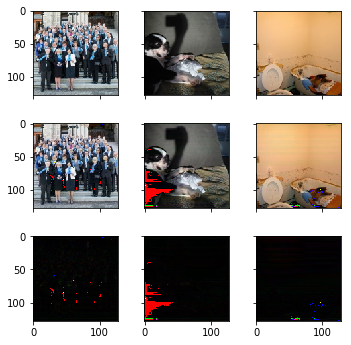


Epoch :  79 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1527930	 | Time     : 233.123326 |
Adversary | Loss  :  0.5492319	 | Accuracy :  0.7657657 |
Encoder   | Loss  :  0.0021868	 | Accuracy :  0.7986153 |
Decoder   | Loss  :  0.1501409	 | Accuracy :  0.7563605 |
Adversary | Loss  :  1.1213361	 | Accuracy :  0.2150901 |

Validation - 
Validate  | Loss  :  0.1527161	 | Time     :  19.897248 |
Encoder   | Loss  :  0.0017754	 | Accuracy :  0.8353899 |
Decoder   | Loss  :  0.1511198	 | Accuracy :  0.7503179 |
Adversary | Loss  :  0.3536493	 | Accuracy :  0.9523092 |


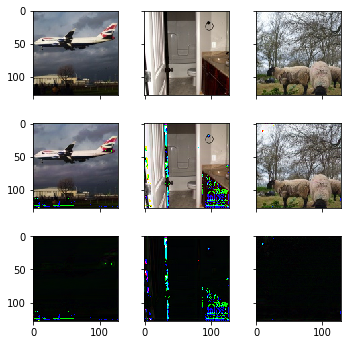


Epoch :  80 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1521017	 | Time     : 233.197893 |
Adversary | Loss  :  0.5546172	 | Accuracy :  0.7655781 |
Encoder   | Loss  :  0.0019746	 | Accuracy :  0.8100104 |
Decoder   | Loss  :  0.1496121	 | Accuracy :  0.7581289 |
Adversary | Loss  :  1.1073313	 | Accuracy :  0.2183433 |

Validation - 
Validate  | Loss  :  0.1519186	 | Time     :  19.747483 |
Encoder   | Loss  :  0.0014455	 | Accuracy :  0.8109590 |
Decoder   | Loss  :  0.1504162	 | Accuracy :  0.7545515 |
Adversary | Loss  :  0.4904893	 | Accuracy :  0.8493976 |


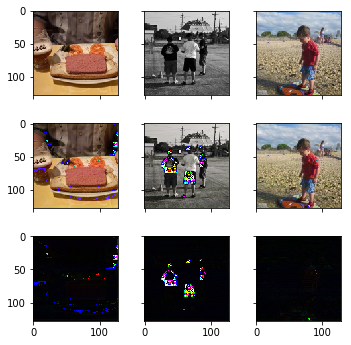


Epoch :  81 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1523894	 | Time     : 233.736950 |
Adversary | Loss  :  0.4649016	 | Accuracy :  0.8288913 |
Encoder   | Loss  :  0.0021081	 | Accuracy :  0.8063278 |
Decoder   | Loss  :  0.1496466	 | Accuracy :  0.7585753 |
Adversary | Loss  :  1.2671195	 | Accuracy :  0.1458959 |

Validation - 
Validate  | Loss  :  0.1526275	 | Time     :  19.714003 |
Encoder   | Loss  :  0.0025213	 | Accuracy :  0.7542155 |
Decoder   | Loss  :  0.1505767	 | Accuracy :  0.7538320 |
Adversary | Loss  :  0.2859135	 | Accuracy :  0.9713855 |


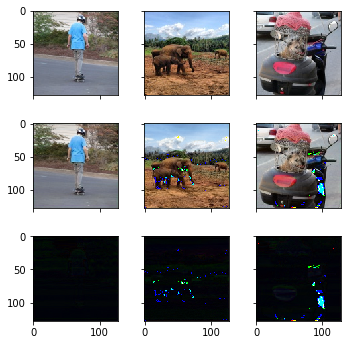


Epoch :  82 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1532008	 | Time     : 234.324672 |
Adversary | Loss  :  2.6384556	 | Accuracy :  0.4724725 |
Encoder   | Loss  :  0.0037799	 | Accuracy :  0.7802556 |
Decoder   | Loss  :  0.1487685	 | Accuracy :  0.7605814 |
Adversary | Loss  :  1.7864394	 | Accuracy :  0.4530781 |

Validation - 
Validate  | Loss  :  0.1530551	 | Time     :  19.768718 |
Encoder   | Loss  :  0.0014178	 | Accuracy :  0.8010392 |
Decoder   | Loss  :  0.1505686	 | Accuracy :  0.7501171 |
Adversary | Loss  :  1.4941641	 | Accuracy :  0.4974899 |


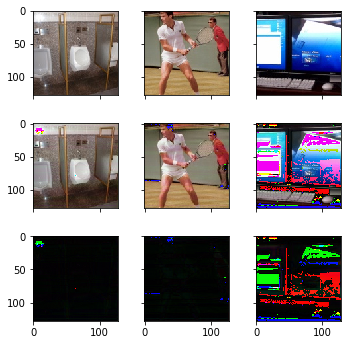


Epoch :  83 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1497486	 | Time     : 233.449714 |
Adversary | Loss  :  0.7902710	 | Accuracy :  0.5455455 |
Encoder   | Loss  :  0.0021171	 | Accuracy :  0.7980187 |
Decoder   | Loss  :  0.1474818	 | Accuracy :  0.7633967 |
Adversary | Loss  :  0.7848487	 | Accuracy :  0.4824825 |

Validation - 
Validate  | Loss  :  0.1511246	 | Time     :  19.785948 |
Encoder   | Loss  :  0.0021591	 | Accuracy :  0.7372569 |
Decoder   | Loss  :  0.1485853	 | Accuracy :  0.7582497 |
Adversary | Loss  :  1.0279567	 | Accuracy :  0.7545181 |


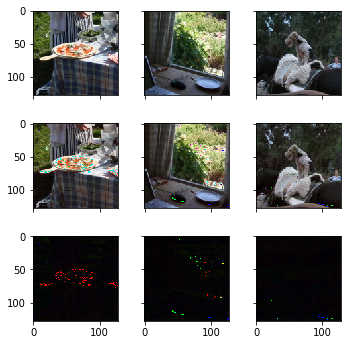


Epoch :  84 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1492611	 | Time     : 233.302482 |
Adversary | Loss  :  0.6566405	 | Accuracy :  0.6393894 |
Encoder   | Loss  :  0.0019077	 | Accuracy :  0.8036444 |
Decoder   | Loss  :  0.1470965	 | Accuracy :  0.7647564 |
Adversary | Loss  :  0.8292262	 | Accuracy :  0.3697447 |

Validation - 
Validate  | Loss  :  0.1490767	 | Time     :  19.710983 |
Encoder   | Loss  :  0.0014059	 | Accuracy :  0.8342291 |
Decoder   | Loss  :  0.1474249	 | Accuracy :  0.7613956 |
Adversary | Loss  :  0.6676079	 | Accuracy :  0.5732931 |


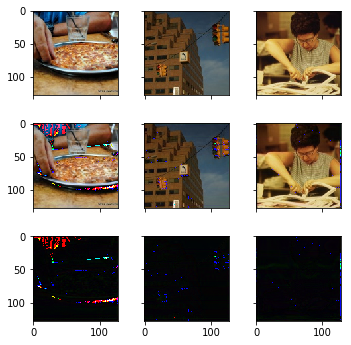


Epoch :  85 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1491150	 | Time     : 233.171249 |
Adversary | Loss  :  0.6514019	 | Accuracy :  0.7186562 |
Encoder   | Loss  :  0.0019611	 | Accuracy :  0.8042129 |
Decoder   | Loss  :  0.1466872	 | Accuracy :  0.7662079 |
Adversary | Loss  :  1.0550511	 | Accuracy :  0.2896647 |

Validation - 
Validate  | Loss  :  0.1500776	 | Time     :  19.839334 |
Encoder   | Loss  :  0.0013677	 | Accuracy :  0.8297743 |
Decoder   | Loss  :  0.1484381	 | Accuracy :  0.7579819 |
Adversary | Loss  :  0.6821527	 | Accuracy :  0.6345382 |


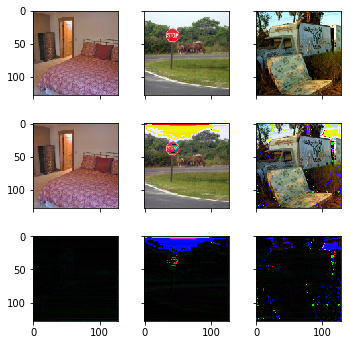


Epoch :  86 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1486831	 | Time     : 234.066225 |
Adversary | Loss  :  0.5083783	 | Accuracy :  0.8133759 |
Encoder   | Loss  :  0.0018437	 | Accuracy :  0.8060243 |
Decoder   | Loss  :  0.1463584	 | Accuracy :  0.7676176 |
Adversary | Loss  :  1.0340854	 | Accuracy :  0.1701702 |

Validation - 
Validate  | Loss  :  0.1478452	 | Time     :  19.618573 |
Encoder   | Loss  :  0.0012251	 | Accuracy :  0.8106371 |
Decoder   | Loss  :  0.1465583	 | Accuracy :  0.7647256 |
Adversary | Loss  :  0.4293131	 | Accuracy :  0.9698795 |


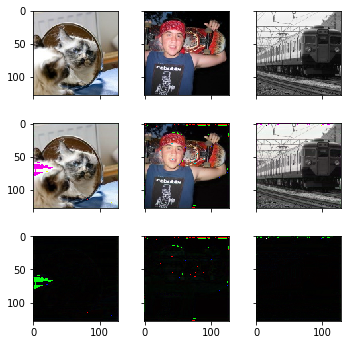


Epoch :  87 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1490368	 | Time     : 233.236448 |
Adversary | Loss  :  0.4815098	 | Accuracy :  0.8231357 |
Encoder   | Loss  :  0.0020141	 | Accuracy :  0.8065351 |
Decoder   | Loss  :  0.1464475	 | Accuracy :  0.7688021 |
Adversary | Loss  :  1.1793550	 | Accuracy :  0.1509009 |

Validation - 
Validate  | Loss  :  0.1498673	 | Time     :  19.565435 |
Encoder   | Loss  :  0.0015662	 | Accuracy :  0.7668911 |
Decoder   | Loss  :  0.1483578	 | Accuracy :  0.7597055 |
Adversary | Loss  :  0.4130459	 | Accuracy :  0.9186747 |


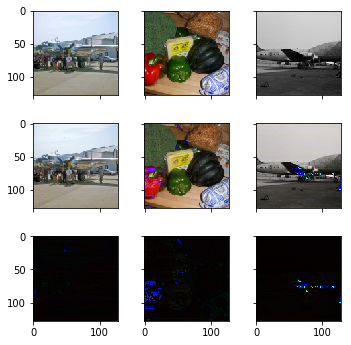


Epoch :  88 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1494549	 | Time     : 232.999763 |
Adversary | Loss  :  0.5407403	 | Accuracy :  0.7983609 |
Encoder   | Loss  :  0.0023177	 | Accuracy :  0.8104299 |
Decoder   | Loss  :  0.1464479	 | Accuracy :  0.7676843 |
Adversary | Loss  :  1.3845543	 | Accuracy :  0.1801802 |

Validation - 
Validate  | Loss  :  0.1503267	 | Time     :  19.706853 |
Encoder   | Loss  :  0.0022871	 | Accuracy :  0.8260542 |
Decoder   | Loss  :  0.1483134	 | Accuracy :  0.7602577 |
Adversary | Loss  :  0.4122369	 | Accuracy :  0.9101406 |


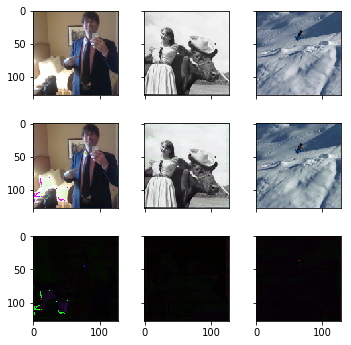


Epoch :  89 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1530899	 | Time     : 233.971406 |
Adversary | Loss  :  2.9846442	 | Accuracy :  0.5485486 |
Encoder   | Loss  :  0.0026846	 | Accuracy :  0.8042764 |
Decoder   | Loss  :  0.1458625	 | Accuracy :  0.7691483 |
Adversary | Loss  :  5.3481183	 | Accuracy :  0.1816817 |

Validation - 
Validate  | Loss  :  0.1478569	 | Time     :  19.749038 |
Encoder   | Loss  :  0.0013012	 | Accuracy :  0.8130585 |
Decoder   | Loss  :  0.1469419	 | Accuracy :  0.7631861 |
Adversary | Loss  :  0.0041855	 | Accuracy :  0.0431727 |


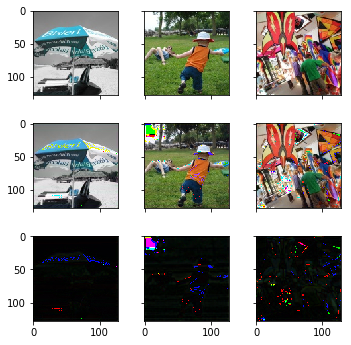


Epoch :  90 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1606642	 | Time     : 233.340421 |
Adversary | Loss  :  7.6474791	 | Accuracy :  0.0599349 |
Encoder   | Loss  :  0.0018154	 | Accuracy :  0.8076102 |
Decoder   | Loss  :  0.1445812	 | Accuracy :  0.7714173 |
Adversary | Loss  : 14.8122435	 | Accuracy :  0.0290290 |

Validation - 
Validate  | Loss  :  0.1505592	 | Time     :  19.538653 |
Encoder   | Loss  :  0.0015184	 | Accuracy :  0.7584877 |
Decoder   | Loss  :  0.1459969	 | Accuracy :  0.7649766 |
Adversary | Loss  :  3.4994853	 | Accuracy :  0.2093374 |


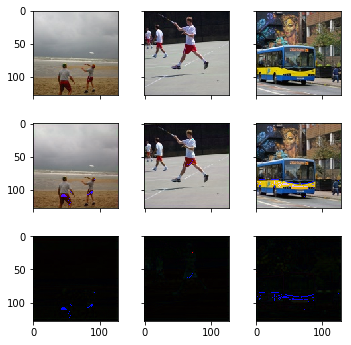


Epoch :  91 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1526324	 | Time     : 233.991917 |
Adversary | Loss  :  3.8886302	 | Accuracy :  0.3574199 |
Encoder   | Loss  :  0.0033543	 | Accuracy :  0.7933254 |
Decoder   | Loss  :  0.1445043	 | Accuracy :  0.7711961 |
Adversary | Loss  :  5.7800860	 | Accuracy :  0.3340841 |

Validation - 
Validate  | Loss  :  0.1467995	 | Time     :  19.445659 |
Encoder   | Loss  :  0.0017994	 | Accuracy :  0.8103667 |
Decoder   | Loss  :  0.1447419	 | Accuracy :  0.7678380 |
Adversary | Loss  :  0.7979996	 | Accuracy :  0.5441767 |


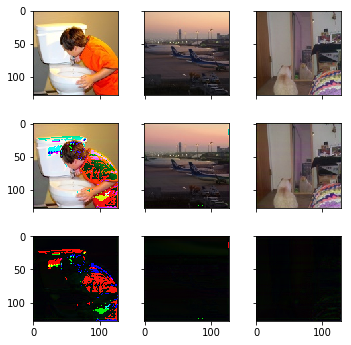


Epoch :  92 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1460185	 | Time     : 233.525280 |
Adversary | Loss  :  0.7142783	 | Accuracy :  0.5377878 |
Encoder   | Loss  :  0.0017629	 | Accuracy :  0.8067328 |
Decoder   | Loss  :  0.1440380	 | Accuracy :  0.7732733 |
Adversary | Loss  :  0.7464488	 | Accuracy :  0.4535786 |

Validation - 
Validate  | Loss  :  0.1478607	 | Time     :  19.644732 |
Encoder   | Loss  :  0.0014998	 | Accuracy :  0.7974432 |
Decoder   | Loss  :  0.1461591	 | Accuracy :  0.7647088 |
Adversary | Loss  :  0.6518572	 | Accuracy :  0.7334337 |


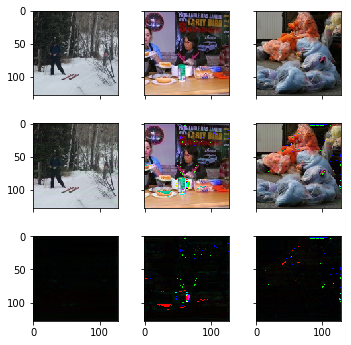


Epoch :  93 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1478428	 | Time     : 232.930206 |
Adversary | Loss  :  1.5016717	 | Accuracy :  0.6604104 |
Encoder   | Loss  :  0.0017333	 | Accuracy :  0.8100170 |
Decoder   | Loss  :  0.1438549	 | Accuracy :  0.7742409 |
Adversary | Loss  :  2.7746010	 | Accuracy :  0.1811812 |

Validation - 
Validate  | Loss  :  0.1465700	 | Time     :  19.456559 |
Encoder   | Loss  :  0.0014728	 | Accuracy :  0.8163825 |
Decoder   | Loss  :  0.1446535	 | Accuracy :  0.7679049 |
Adversary | Loss  :  0.8855084	 | Accuracy :  0.3498996 |


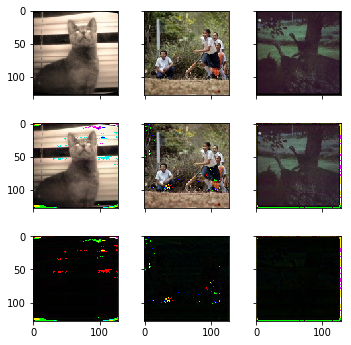


Epoch :  94 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1470181	 | Time     : 233.240987 |
Adversary | Loss  :  1.9311858	 | Accuracy :  0.4523273 |
Encoder   | Loss  :  0.0018696	 | Accuracy :  0.8050689 |
Decoder   | Loss  :  0.1435672	 | Accuracy :  0.7742117 |
Adversary | Loss  :  2.1421599	 | Accuracy :  0.5266517 |

Validation - 
Validate  | Loss  :  0.1497147	 | Time     :  19.646983 |
Encoder   | Loss  :  0.0012415	 | Accuracy :  0.8482842 |
Decoder   | Loss  :  0.1481944	 | Accuracy :  0.7596051 |
Adversary | Loss  :  0.6512948	 | Accuracy :  0.6290160 |


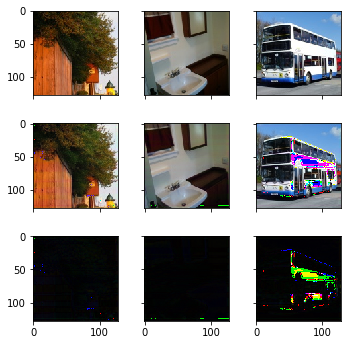


Epoch :  95 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1450719	 | Time     : 234.519862 |
Adversary | Loss  :  0.7103875	 | Accuracy :  0.5073824 |
Encoder   | Loss  :  0.0016989	 | Accuracy :  0.8068377 |
Decoder   | Loss  :  0.1431831	 | Accuracy :  0.7745829 |
Adversary | Loss  :  0.6995642	 | Accuracy :  0.5267767 |

Validation - 
Validate  | Loss  :  0.1453572	 | Time     :  19.570639 |
Encoder   | Loss  :  0.0012947	 | Accuracy :  0.8071399 |
Decoder   | Loss  :  0.1437327	 | Accuracy :  0.7699631 |
Adversary | Loss  :  0.7181145	 | Accuracy :  0.5090361 |


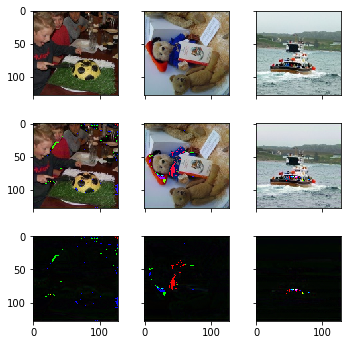


Epoch :  96 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1451452	 | Time     : 233.737860 |
Adversary | Loss  :  0.6324341	 | Accuracy :  0.6824324 |
Encoder   | Loss  :  0.0017778	 | Accuracy :  0.8052548 |
Decoder   | Loss  :  0.1430424	 | Accuracy :  0.7751083 |
Adversary | Loss  :  0.8583179	 | Accuracy :  0.3289540 |

Validation - 
Validate  | Loss  :  0.1474761	 | Time     :  19.516908 |
Encoder   | Loss  :  0.0025458	 | Accuracy :  0.7971836 |
Decoder   | Loss  :  0.1453344	 | Accuracy :  0.7649766 |
Adversary | Loss  :  0.3596390	 | Accuracy :  0.9397590 |


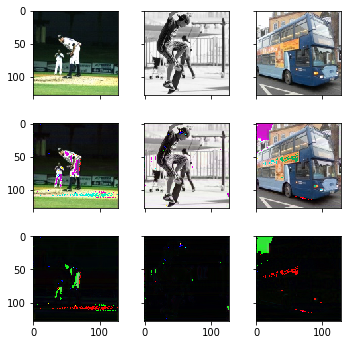


Epoch :  97 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1455043	 | Time     : 233.973437 |
Adversary | Loss  :  0.4871236	 | Accuracy :  0.8343970 |
Encoder   | Loss  :  0.0017713	 | Accuracy :  0.8103805 |
Decoder   | Loss  :  0.1431485	 | Accuracy :  0.7759593 |
Adversary | Loss  :  1.1158932	 | Accuracy :  0.1559059 |

Validation - 
Validate  | Loss  :  0.1465262	 | Time     :  19.390311 |
Encoder   | Loss  :  0.0020258	 | Accuracy :  0.8071051 |
Decoder   | Loss  :  0.1446728	 | Accuracy :  0.7698293 |
Adversary | Loss  :  0.4353476	 | Accuracy :  0.9759036 |


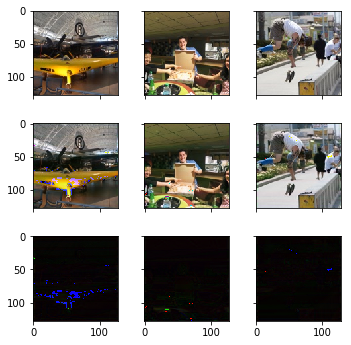


Epoch :  98 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1508882	 | Time     : 232.862875 |
Adversary | Loss  :  0.3144229	 | Accuracy :  0.9110986 |
Encoder   | Loss  :  0.0043064	 | Accuracy :  0.8029389 |
Decoder   | Loss  :  0.1442958	 | Accuracy :  0.7741617 |
Adversary | Loss  :  3.5779953	 | Accuracy :  0.0420420 |

Validation - 
Validate  | Loss  :  0.1510532	 | Time     :  19.549485 |
Encoder   | Loss  :  0.0064673	 | Accuracy :  0.7865648 |
Decoder   | Loss  :  0.1464839	 | Accuracy :  0.7672691 |
Adversary | Loss  :  0.0421932	 | Accuracy :  0.9874498 |


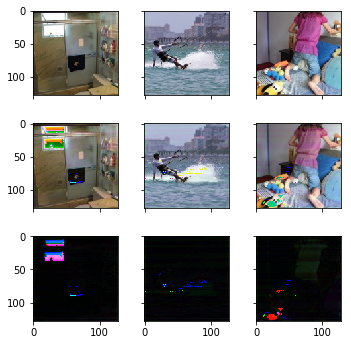


Epoch :  99 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1476188	 | Time     : 233.515724 |
Adversary | Loss  :  0.4591727	 | Accuracy :  0.8778153 |
Encoder   | Loss  :  0.0023354	 | Accuracy :  0.8040782 |
Decoder   | Loss  :  0.1438207	 | Accuracy :  0.7751626 |
Adversary | Loss  :  2.1633205	 | Accuracy :  0.1106106 |

Validation - 
Validate  | Loss  :  0.1467396	 | Time     :  19.498856 |
Encoder   | Loss  :  0.0014994	 | Accuracy :  0.8303955 |
Decoder   | Loss  :  0.1449440	 | Accuracy :  0.7707831 |
Adversary | Loss  :  0.7460481	 | Accuracy :  0.5913655 |


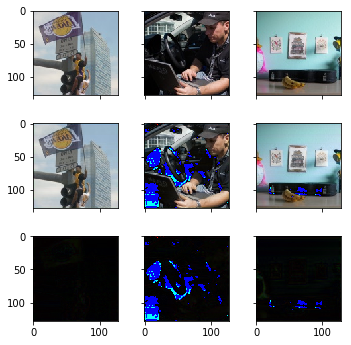


Epoch :  100 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1484437	 | Time     : 234.275187 |
Adversary | Loss  :  0.3333235	 | Accuracy :  0.9214839 |
Encoder   | Loss  :  0.0025711	 | Accuracy :  0.8022395 |
Decoder   | Loss  :  0.1444599	 | Accuracy :  0.7753087 |
Adversary | Loss  :  2.1839983	 | Accuracy :  0.0573073 |

Validation - 
Validate  | Loss  :  0.1800226	 | Time     :  19.666198 |
Encoder   | Loss  :  0.0370020	 | Accuracy :  0.7874823 |
Decoder   | Loss  :  0.1534259	 | Accuracy :  0.7577477 |
Adversary | Loss  :  0.6952391	 | Accuracy :  0.5888554 |


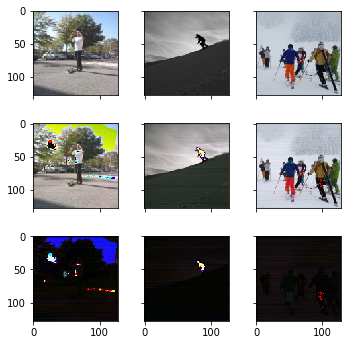


Epoch :  101 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1489443	 | Time     : 234.337424 |
Adversary | Loss  :  4.0357723	 | Accuracy :  0.4618368 |
Encoder   | Loss  :  0.0037358	 | Accuracy :  0.7820995 |
Decoder   | Loss  :  0.1433526	 | Accuracy :  0.7764431 |
Adversary | Loss  :  2.9765899	 | Accuracy :  0.2249750 |

Validation - 
Validate  | Loss  :  0.1531976	 | Time     :  19.563325 |
Encoder   | Loss  :  0.0021230	 | Accuracy :  0.8169466 |
Decoder   | Loss  :  0.1447626	 | Accuracy :  0.7685575 |
Adversary | Loss  :  6.9489231	 | Accuracy :  0.3423695 |


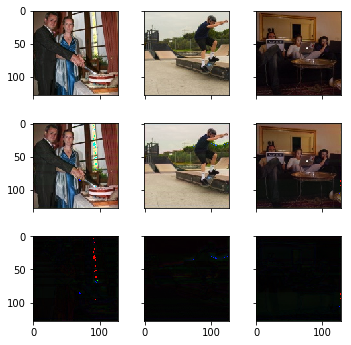


Epoch :  102 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1548409	 | Time     : 234.440554 |
Adversary | Loss  :  6.9985147	 | Accuracy :  0.1462713 |
Encoder   | Loss  :  0.0022526	 | Accuracy :  0.8019079 |
Decoder   | Loss  :  0.1417025	 | Accuracy :  0.7786828 |
Adversary | Loss  : 11.5616169	 | Accuracy :  0.1009760 |

Validation - 
Validate  | Loss  :  0.1460762	 | Time     :  19.834501 |
Encoder   | Loss  :  0.0022410	 | Accuracy :  0.7948925 |
Decoder   | Loss  :  0.1434895	 | Accuracy :  0.7697791 |
Adversary | Loss  :  1.0179691	 | Accuracy :  0.3052209 |


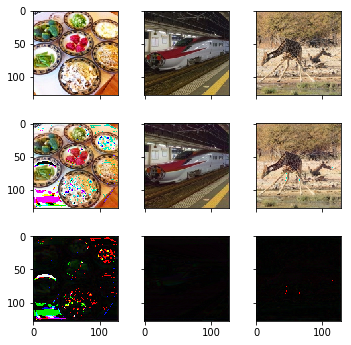


Epoch :  103 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1576278	 | Time     : 234.371953 |
Adversary | Loss  :  6.9504371	 | Accuracy :  0.1928804 |
Encoder   | Loss  :  0.0054359	 | Accuracy :  0.7763051 |
Decoder   | Loss  :  0.1415243	 | Accuracy :  0.7793751 |
Adversary | Loss  : 12.2983475	 | Accuracy :  0.0944695 |

Validation - 
Validate  | Loss  :  0.1500670	 | Time     :  19.557036 |
Encoder   | Loss  :  0.0040369	 | Accuracy :  0.7523847 |
Decoder   | Loss  :  0.1428851	 | Accuracy :  0.7712851 |
Adversary | Loss  :  4.3560653	 | Accuracy :  0.3182731 |


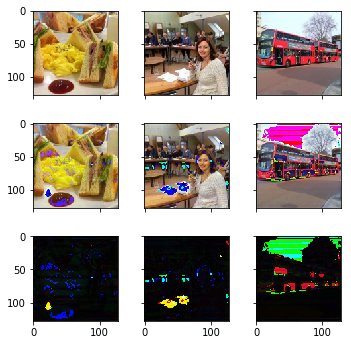


Epoch :  104 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1517416	 | Time     : 233.584654 |
Adversary | Loss  :  5.7910461	 | Accuracy :  0.2856606 |
Encoder   | Loss  :  0.0038743	 | Accuracy :  0.7800480 |
Decoder   | Loss  :  0.1411638	 | Accuracy :  0.7804137 |
Adversary | Loss  :  7.8657579	 | Accuracy :  0.2591341 |

Validation - 
Validate  | Loss  :  0.1472464	 | Time     :  19.796998 |
Encoder   | Loss  :  0.0026409	 | Accuracy :  0.7787928 |
Decoder   | Loss  :  0.1426002	 | Accuracy :  0.7743809 |
Adversary | Loss  :  2.7975421	 | Accuracy :  0.2269076 |


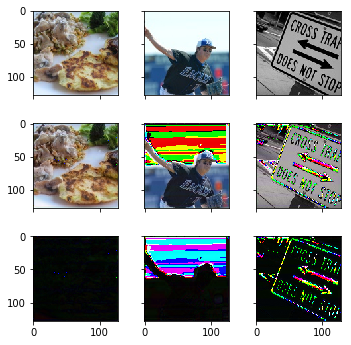


Epoch :  105 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1438570	 | Time     : 233.650826 |
Adversary | Loss  :  1.3079922	 | Accuracy :  0.5526151 |
Encoder   | Loss  :  0.0024486	 | Accuracy :  0.8003170 |
Decoder   | Loss  :  0.1406425	 | Accuracy :  0.7811186 |
Adversary | Loss  :  1.5004581	 | Accuracy :  0.4215465 |

Validation - 
Validate  | Loss  :  0.1439390	 | Time     :  19.667466 |
Encoder   | Loss  :  0.0024947	 | Accuracy :  0.7855770 |
Decoder   | Loss  :  0.1414691	 | Accuracy :  0.7761378 |
Adversary | Loss  :  0.7236140	 | Accuracy :  0.5838353 |


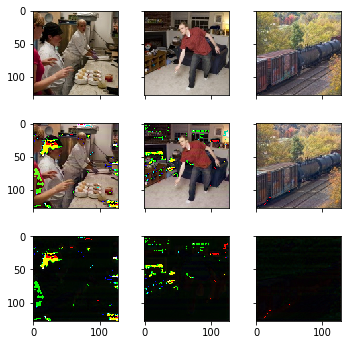


Epoch :  106 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1432523	 | Time     : 234.917287 |
Adversary | Loss  :  0.4986303	 | Accuracy :  0.8169419 |
Encoder   | Loss  :  0.0021694	 | Accuracy :  0.8074264 |
Decoder   | Loss  :  0.1405139	 | Accuracy :  0.7818611 |
Adversary | Loss  :  1.2198238	 | Accuracy :  0.1710460 |

Validation - 
Validate  | Loss  :  0.1445332	 | Time     :  19.590038 |
Encoder   | Loss  :  0.0016873	 | Accuracy :  0.8118317 |
Decoder   | Loss  :  0.1427040	 | Accuracy :  0.7760208 |
Adversary | Loss  :  0.6481147	 | Accuracy :  0.6862449 |


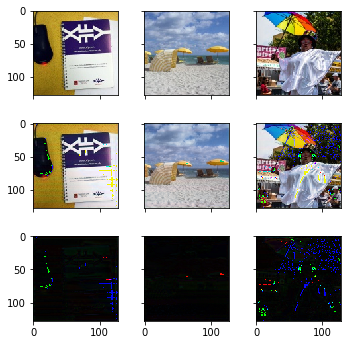


Epoch :  107 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1580559	 | Time     : 234.125291 |
Adversary | Loss  :  0.2541318	 | Accuracy :  0.9519520 |
Encoder   | Loss  :  0.0065719	 | Accuracy :  0.7369477 |
Decoder   | Loss  :  0.1498663	 | Accuracy :  0.7660327 |
Adversary | Loss  :  3.5892987	 | Accuracy :  0.0422923 |

Validation - 
Validate  | Loss  :  0.1493813	 | Time     :  19.740402 |
Encoder   | Loss  :  0.0045898	 | Accuracy :  0.7450109 |
Decoder   | Loss  :  0.1459701	 | Accuracy :  0.7709169 |
Adversary | Loss  :  0.1983988	 | Accuracy :  0.9608434 |


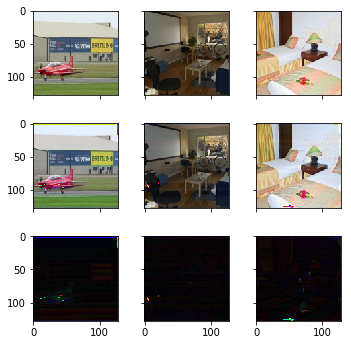


Epoch :  108 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1491299	 | Time     : 233.728206 |
Adversary | Loss  :  0.3440833	 | Accuracy :  0.9027778 |
Encoder   | Loss  :  0.0037891	 | Accuracy :  0.7791341 |
Decoder   | Loss  :  0.1438377	 | Accuracy :  0.7781698 |
Adversary | Loss  :  2.6398070	 | Accuracy :  0.0558058 |

Validation - 
Validate  | Loss  :  0.1504884	 | Time     :  19.501015 |
Encoder   | Loss  :  0.0030051	 | Accuracy :  0.7555900 |
Decoder   | Loss  :  0.1478972	 | Accuracy :  0.7706326 |
Adversary | Loss  :  0.4876060	 | Accuracy :  0.8780121 |


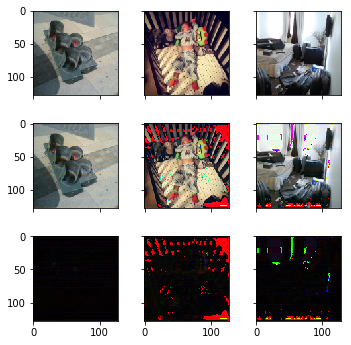


Epoch :  109 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1480372	 | Time     : 234.094750 |
Adversary | Loss  :  0.3181075	 | Accuracy :  0.9213589 |
Encoder   | Loss  :  0.0033079	 | Accuracy :  0.7895955 |
Decoder   | Loss  :  0.1428376	 | Accuracy :  0.7798382 |
Adversary | Loss  :  2.8841062	 | Accuracy :  0.0611862 |

Validation - 
Validate  | Loss  :  0.1443548	 | Time     :  19.557007 |
Encoder   | Loss  :  0.0026855	 | Accuracy :  0.7932529 |
Decoder   | Loss  :  0.1418456	 | Accuracy :  0.7774431 |
Adversary | Loss  :  0.6293166	 | Accuracy :  0.7078313 |


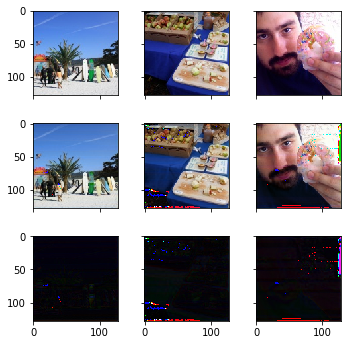


Epoch :  110 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1449466	 | Time     : 233.766686 |
Adversary | Loss  :  2.4796088	 | Accuracy :  0.5222098 |
Encoder   | Loss  :  0.0025523	 | Accuracy :  0.8017991 |
Decoder   | Loss  :  0.1401101	 | Accuracy :  0.7840132 |
Adversary | Loss  :  3.0499299	 | Accuracy :  0.3816316 |

Validation - 
Validate  | Loss  :  0.1430691	 | Time     :  19.653378 |
Encoder   | Loss  :  0.0019083	 | Accuracy :  0.7617480 |
Decoder   | Loss  :  0.1412248	 | Accuracy :  0.7785308 |
Adversary | Loss  :  0.5085127	 | Accuracy :  0.8408635 |


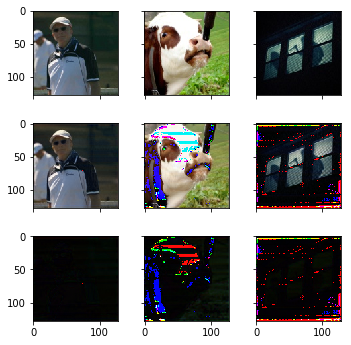


Epoch :  111 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1433503	 | Time     : 233.990821 |
Adversary | Loss  :  0.6027274	 | Accuracy :  0.8109359 |
Encoder   | Loss  :  0.0023227	 | Accuracy :  0.8080447 |
Decoder   | Loss  :  0.1400066	 | Accuracy :  0.7842383 |
Adversary | Loss  :  1.7178141	 | Accuracy :  0.2012012 |

Validation - 
Validate  | Loss  :  0.1459279	 | Time     :  19.579915 |
Encoder   | Loss  :  0.0028310	 | Accuracy :  0.7850497 |
Decoder   | Loss  :  0.1434962	 | Accuracy :  0.7771586 |
Adversary | Loss  :  0.4500495	 | Accuracy :  0.8845382 |


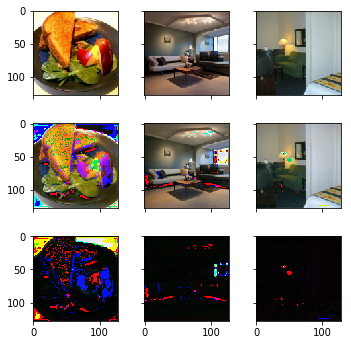


Epoch :  112 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1441438	 | Time     : 233.759813 |
Adversary | Loss  :  0.3480767	 | Accuracy :  0.9137889 |
Encoder   | Loss  :  0.0027305	 | Accuracy :  0.7975077 |
Decoder   | Loss  :  0.1401969	 | Accuracy :  0.7858150 |
Adversary | Loss  :  2.0355122	 | Accuracy :  0.0633133 |

Validation - 
Validate  | Loss  :  0.1427527	 | Time     :  19.387691 |
Encoder   | Loss  :  0.0015430	 | Accuracy :  0.8030308 |
Decoder   | Loss  :  0.1414113	 | Accuracy :  0.7793674 |
Adversary | Loss  :  0.2612335	 | Accuracy :  0.9879518 |


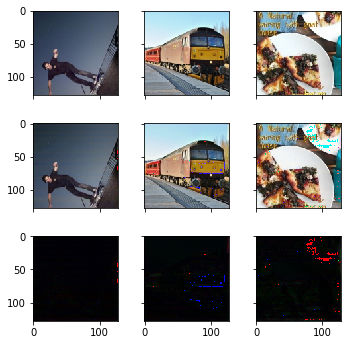


Epoch :  113 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1539306	 | Time     : 233.375433 |
Adversary | Loss  :  1.9122632	 | Accuracy :  0.7439940 |
Encoder   | Loss  :  0.0042792	 | Accuracy :  0.7795328 |
Decoder   | Loss  :  0.1443893	 | Accuracy :  0.7783325 |
Adversary | Loss  :  6.5458603	 | Accuracy :  0.0559309 |

Validation - 
Validate  | Loss  :  0.1457918	 | Time     :  19.723470 |
Encoder   | Loss  :  0.0027042	 | Accuracy :  0.7924622 |
Decoder   | Loss  :  0.1401939	 | Accuracy :  0.7818105 |
Adversary | Loss  :  3.7049789	 | Accuracy :  0.2776105 |


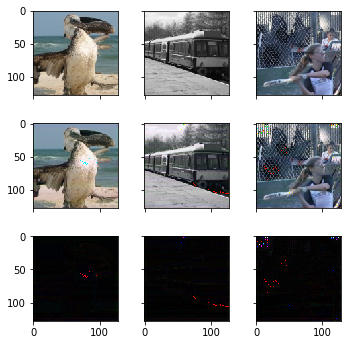


Epoch :  114 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1501674	 | Time     : 233.689330 |
Adversary | Loss  :  6.5167980	 | Accuracy :  0.2152778 |
Encoder   | Loss  :  0.0026717	 | Accuracy :  0.7946844 |
Decoder   | Loss  :  0.1385622	 | Accuracy :  0.7877168 |
Adversary | Loss  :  9.7349997	 | Accuracy :  0.1667918 |

Validation - 
Validate  | Loss  :  0.1450285	 | Time     :  19.708205 |
Encoder   | Loss  :  0.0017466	 | Accuracy :  0.8288957 |
Decoder   | Loss  :  0.1403148	 | Accuracy :  0.7795515 |
Adversary | Loss  :  3.4911101	 | Accuracy :  0.3770080 |


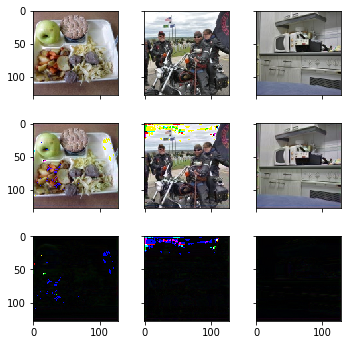


Epoch :  115 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1438868	 | Time     : 232.591767 |
Adversary | Loss  :  4.0019979	 | Accuracy :  0.4098473 |
Encoder   | Loss  :  0.0031249	 | Accuracy :  0.7874244 |
Decoder   | Loss  :  0.1380094	 | Accuracy :  0.7893602 |
Adversary | Loss  :  3.6900053	 | Accuracy :  0.4278027 |

Validation - 
Validate  | Loss  :  0.1413123	 | Time     :  19.532492 |
Encoder   | Loss  :  0.0017871	 | Accuracy :  0.8156643 |
Decoder   | Loss  :  0.1390788	 | Accuracy :  0.7828982 |
Adversary | Loss  :  0.9825670	 | Accuracy :  0.5692771 |


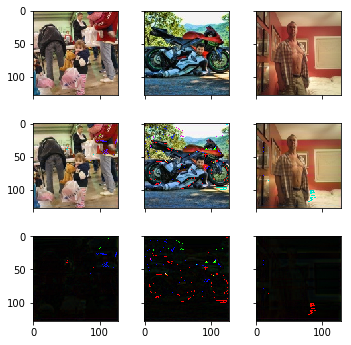


Epoch :  116 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1399760	 | Time     : 233.150030 |
Adversary | Loss  :  0.9477097	 | Accuracy :  0.5499249 |
Encoder   | Loss  :  0.0022722	 | Accuracy :  0.7967926 |
Decoder   | Loss  :  0.1374706	 | Accuracy :  0.7903612 |
Adversary | Loss  :  0.9148350	 | Accuracy :  0.5053804 |

Validation - 
Validate  | Loss  :  0.1423933	 | Time     :  19.291346 |
Encoder   | Loss  :  0.0019546	 | Accuracy :  0.8095849 |
Decoder   | Loss  :  0.1400564	 | Accuracy :  0.7831158 |
Adversary | Loss  :  0.9687459	 | Accuracy :  0.7339358 |


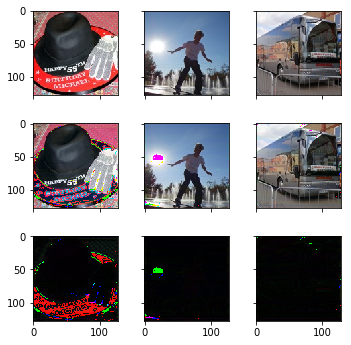


Epoch :  117 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1425723	 | Time     : 233.539616 |
Adversary | Loss  :  0.5863637	 | Accuracy :  0.7411161 |
Encoder   | Loss  :  0.0042876	 | Accuracy :  0.7640792 |
Decoder   | Loss  :  0.1381982	 | Accuracy :  0.7898106 |
Adversary | Loss  :  1.3727950	 | Accuracy :  0.2692693 |

Validation - 
Validate  | Loss  :  0.1445875	 | Time     :  19.788338 |
Encoder   | Loss  :  0.0044453	 | Accuracy :  0.7434632 |
Decoder   | Loss  :  0.1404829	 | Accuracy :  0.7823461 |
Adversary | Loss  :  0.9928640	 | Accuracy :  0.5642570 |


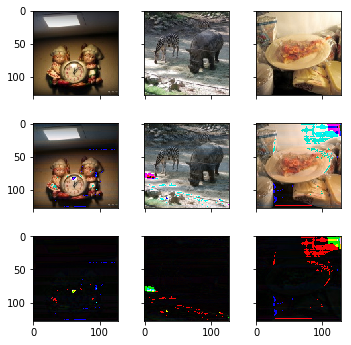


Epoch :  118 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1418740	 | Time     : 233.399835 |
Adversary | Loss  :  0.4276297	 | Accuracy :  0.8662413 |
Encoder   | Loss  :  0.0035941	 | Accuracy :  0.7583224 |
Decoder   | Loss  :  0.1377522	 | Accuracy :  0.7897606 |
Adversary | Loss  :  1.6059034	 | Accuracy :  0.1432683 |

Validation - 
Validate  | Loss  :  0.1413411	 | Time     :  19.684811 |
Encoder   | Loss  :  0.0027651	 | Accuracy :  0.7684121 |
Decoder   | Loss  :  0.1391936	 | Accuracy :  0.7835507 |
Adversary | Loss  :  0.2119038	 | Accuracy :  0.9784138 |


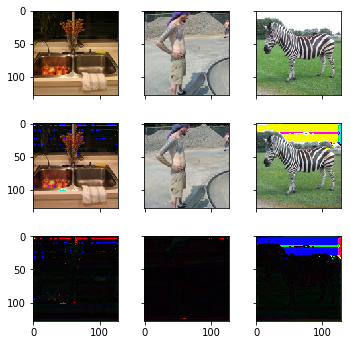


Epoch :  119 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1428978	 | Time     : 233.710809 |
Adversary | Loss  :  2.6025379	 | Accuracy :  0.5145770 |
Encoder   | Loss  :  0.0028488	 | Accuracy :  0.7802289 |
Decoder   | Loss  :  0.1366860	 | Accuracy :  0.7939356 |
Adversary | Loss  :  4.2176566	 | Accuracy :  0.3241992 |

Validation - 
Validate  | Loss  :  0.1392579	 | Time     :  19.497925 |
Encoder   | Loss  :  0.0020223	 | Accuracy :  0.7751143 |
Decoder   | Loss  :  0.1371973	 | Accuracy :  0.7885709 |
Adversary | Loss  :  0.6449565	 | Accuracy :  0.7801205 |


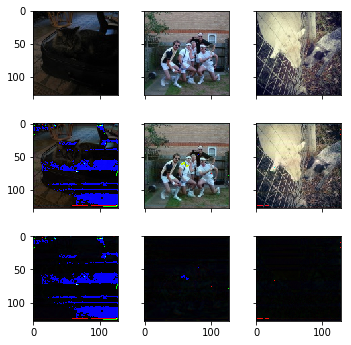


Epoch :  120 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1400195	 | Time     : 233.029757 |
Adversary | Loss  :  0.4943092	 | Accuracy :  0.7973599 |
Encoder   | Loss  :  0.0030853	 | Accuracy :  0.7797716 |
Decoder   | Loss  :  0.1365038	 | Accuracy :  0.7944111 |
Adversary | Loss  :  1.3559766	 | Accuracy :  0.2218468 |

Validation - 
Validate  | Loss  :  0.1401707	 | Time     :  19.673082 |
Encoder   | Loss  :  0.0021170	 | Accuracy :  0.8042787 |
Decoder   | Loss  :  0.1378309	 | Accuracy :  0.7873327 |
Adversary | Loss  :  0.8577981	 | Accuracy :  0.7143574 |


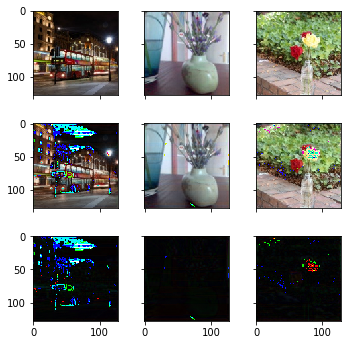


Epoch :  121 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1391814	 | Time     : 233.202434 |
Adversary | Loss  :  0.4205149	 | Accuracy :  0.8671796 |
Encoder   | Loss  :  0.0022997	 | Accuracy :  0.7960502 |
Decoder   | Loss  :  0.1358805	 | Accuracy :  0.7958124 |
Adversary | Loss  :  1.6911131	 | Accuracy :  0.1149900 |

Validation - 
Validate  | Loss  :  0.1388295	 | Time     :  19.545160 |
Encoder   | Loss  :  0.0018318	 | Accuracy :  0.8336216 |
Decoder   | Loss  :  0.1373648	 | Accuracy :  0.7890061 |
Adversary | Loss  :  0.1824638	 | Accuracy :  0.9779117 |


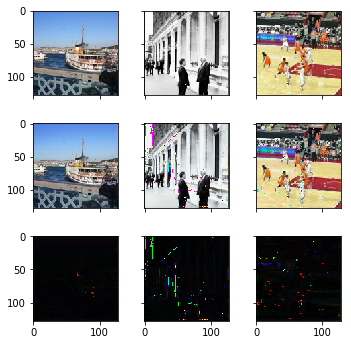


Epoch :  122 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1389161	 | Time     : 233.040207 |
Adversary | Loss  :  3.2564971	 | Accuracy :  0.5768269 |
Encoder   | Loss  :  0.0022152	 | Accuracy :  0.8109980 |
Decoder   | Loss  :  0.1350940	 | Accuracy :  0.7972056 |
Adversary | Loss  :  2.2715149	 | Accuracy :  0.1059810 |

Validation - 
Validate  | Loss  :  0.1498689	 | Time     :  19.496326 |
Encoder   | Loss  :  0.0019198	 | Accuracy :  0.7964538 |
Decoder   | Loss  :  0.1359245	 | Accuracy :  0.7908132 |
Adversary | Loss  : 12.6004534	 | Accuracy :  0.0803213 |


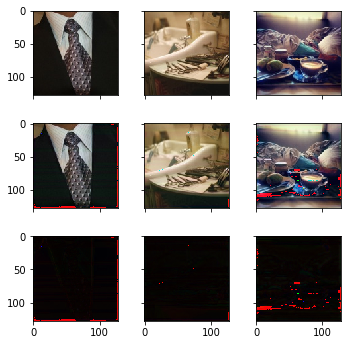


Epoch :  123 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1397124	 | Time     : 233.465000 |
Adversary | Loss  :  5.9737887	 | Accuracy :  0.2561311 |
Encoder   | Loss  :  0.0020391	 | Accuracy :  0.8087873 |
Decoder   | Loss  :  0.1336713	 | Accuracy :  0.8001918 |
Adversary | Loss  :  4.6136494	 | Accuracy :  0.2796547 |

Validation - 
Validate  | Loss  :  0.1466407	 | Time     :  19.626550 |
Encoder   | Loss  :  0.0013174	 | Accuracy :  0.8301011 |
Decoder   | Loss  :  0.1354195	 | Accuracy :  0.7931392 |
Adversary | Loss  : 10.2990665	 | Accuracy :  0.1681727 |


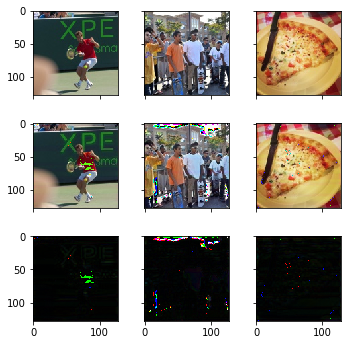


Epoch :  124 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1355507	 | Time     : 233.891308 |
Adversary | Loss  :  6.4386582	 | Accuracy :  0.2097723 |
Encoder   | Loss  :  0.0021405	 | Accuracy :  0.8022730 |
Decoder   | Loss  :  0.1327638	 | Accuracy :  0.8020187 |
Adversary | Loss  :  1.2885106	 | Accuracy :  0.2906657 |

Validation - 
Validate  | Loss  :  0.1509106	 | Time     :  19.664967 |
Encoder   | Loss  :  0.0030379	 | Accuracy :  0.8147844 |
Decoder   | Loss  :  0.1354864	 | Accuracy :  0.7936580 |
Adversary | Loss  : 13.2976837	 | Accuracy :  0.0632530 |


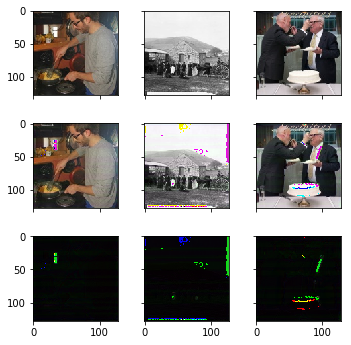


Epoch :  125 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1344433	 | Time     : 233.456161 |
Adversary | Loss  :  7.0185709	 | Accuracy :  0.1648524 |
Encoder   | Loss  :  0.0018760	 | Accuracy :  0.8088633 |
Decoder   | Loss  :  0.1320623	 | Accuracy :  0.8042918 |
Adversary | Loss  :  1.0678071	 | Accuracy :  0.2678929 |

Validation - 
Validate  | Loss  :  0.1419835	 | Time     :  19.769780 |
Encoder   | Loss  :  0.0012379	 | Accuracy :  0.8457845 |
Decoder   | Loss  :  0.1336042	 | Accuracy :  0.7950636 |
Adversary | Loss  :  7.5127969	 | Accuracy :  0.1967872 |


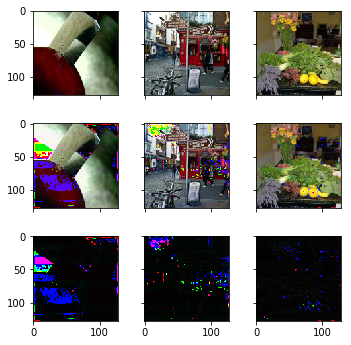


Epoch :  126 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1409974	 | Time     : 232.931006 |
Adversary | Loss  :  5.7396502	 | Accuracy :  0.3002377 |
Encoder   | Loss  :  0.0024296	 | Accuracy :  0.7885652 |
Decoder   | Loss  :  0.1315224	 | Accuracy :  0.8061478 |
Adversary | Loss  :  7.7742219	 | Accuracy :  0.2416166 |

Validation - 
Validate  | Loss  :  0.1377077	 | Time     :  19.639552 |
Encoder   | Loss  :  0.0018204	 | Accuracy :  0.8071282 |
Decoder   | Loss  :  0.1330619	 | Accuracy :  0.7981593 |
Adversary | Loss  :  3.3715460	 | Accuracy :  0.4081325 |


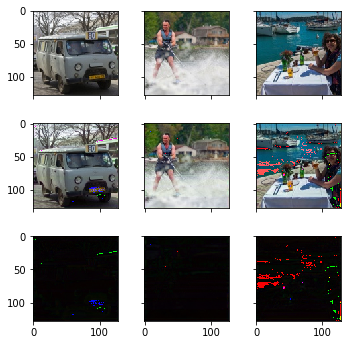


Epoch :  127 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1336207	 | Time     : 232.423876 |
Adversary | Loss  :  5.8560038	 | Accuracy :  0.2764640 |
Encoder   | Loss  :  0.0020799	 | Accuracy :  0.7940328 |
Decoder   | Loss  :  0.1304082	 | Accuracy :  0.8082374 |
Adversary | Loss  :  1.7565663	 | Accuracy :  0.3821321 |

Validation - 
Validate  | Loss  :  0.1452086	 | Time     :  19.774219 |
Encoder   | Loss  :  0.0019922	 | Accuracy :  0.7766847 |
Decoder   | Loss  :  0.1317155	 | Accuracy :  0.8007531 |
Adversary | Loss  : 12.0985899	 | Accuracy :  0.0943775 |


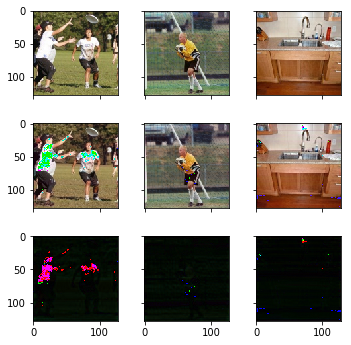


Epoch :  128 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1311392	 | Time     : 233.011280 |
Adversary | Loss  :  7.0056834	 | Accuracy :  0.1536537 |
Encoder   | Loss  :  0.0018345	 | Accuracy :  0.8032080 |
Decoder   | Loss  :  0.1292188	 | Accuracy :  0.8116034 |
Adversary | Loss  :  0.6362498	 | Accuracy :  0.2613864 |

Validation - 
Validate  | Loss  :  0.1483174	 | Time     :  19.649748 |
Encoder   | Loss  :  0.0013283	 | Accuracy :  0.8210918 |
Decoder   | Loss  :  0.1325770	 | Accuracy :  0.7984437 |
Adversary | Loss  : 14.8105736	 | Accuracy :  0.0321285 |


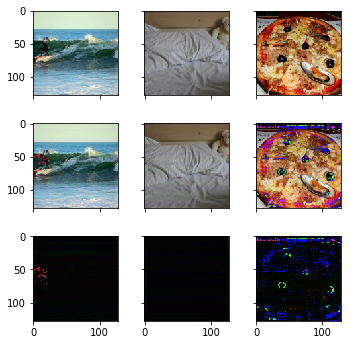


Epoch :  129 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1302527	 | Time     : 233.403167 |
Adversary | Loss  :  6.4664845	 | Accuracy :  0.1995120 |
Encoder   | Loss  :  0.0019268	 | Accuracy :  0.8010021 |
Decoder   | Loss  :  0.1281280	 | Accuracy :  0.8145728 |
Adversary | Loss  :  0.7760165	 | Accuracy :  0.3244494 |

Validation - 
Validate  | Loss  :  0.1424135	 | Time     :  19.743102 |
Encoder   | Loss  :  0.0019851	 | Accuracy :  0.7688410 |
Decoder   | Loss  :  0.1291811	 | Accuracy :  0.8071118 |
Adversary | Loss  : 11.8428116	 | Accuracy :  0.1410643 |


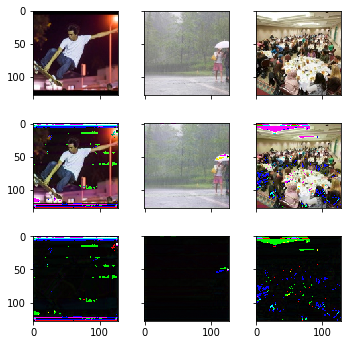


Epoch :  130 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1285436	 | Time     : 232.459092 |
Adversary | Loss  :  7.3430095	 | Accuracy :  0.1288163 |
Encoder   | Loss  :  0.0018794	 | Accuracy :  0.8015447 |
Decoder   | Loss  :  0.1266699	 | Accuracy :  0.8176093 |
Adversary | Loss  :  0.5580777	 | Accuracy :  0.2085836 |

Validation - 
Validate  | Loss  :  0.1375646	 | Time     :  19.625256 |
Encoder   | Loss  :  0.0012537	 | Accuracy :  0.8185259 |
Decoder   | Loss  :  0.1286587	 | Accuracy :  0.8111445 |
Adversary | Loss  :  8.0283499	 | Accuracy :  0.2364458 |


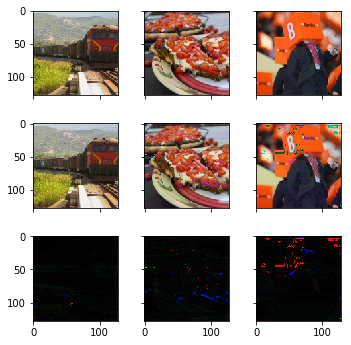


Epoch :  131 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1310605	 | Time     : 234.102633 |
Adversary | Loss  :  5.2740407	 | Accuracy :  0.3301426 |
Encoder   | Loss  :  0.0029171	 | Accuracy :  0.7796063 |
Decoder   | Loss  :  0.1251197	 | Accuracy :  0.8214673 |
Adversary | Loss  :  3.8988466	 | Accuracy :  0.3557307 |

Validation - 
Validate  | Loss  :  0.1290789	 | Time     :  19.778992 |
Encoder   | Loss  :  0.0015995	 | Accuracy :  0.8121296 |
Decoder   | Loss  :  0.1258435	 | Accuracy :  0.8168842 |
Adversary | Loss  :  2.1157296	 | Accuracy :  0.4934739 |


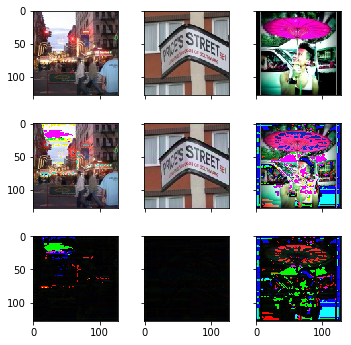


Epoch :  132 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1279096	 | Time     : 233.261433 |
Adversary | Loss  :  2.3363132	 | Accuracy :  0.4842342 |
Encoder   | Loss  :  0.0028738	 | Accuracy :  0.7673120 |
Decoder   | Loss  :  0.1234913	 | Accuracy :  0.8257549 |
Adversary | Loss  :  2.4065783	 | Accuracy :  0.5290290 |

Validation - 
Validate  | Loss  :  0.1247850	 | Time     :  19.694033 |
Encoder   | Loss  :  0.0018607	 | Accuracy :  0.8263706 |
Decoder   | Loss  :  0.1227129	 | Accuracy :  0.8237283 |
Adversary | Loss  :  0.7696592	 | Accuracy :  0.6636546 |


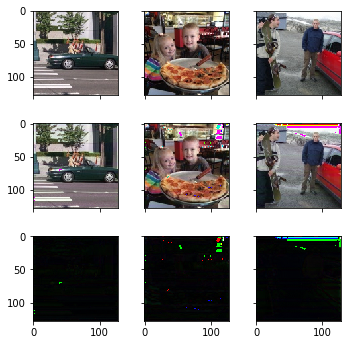


Epoch :  133 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1233941	 | Time     : 233.462751 |
Adversary | Loss  :  0.7110838	 | Accuracy :  0.6406406 |
Encoder   | Loss  :  0.0020431	 | Accuracy :  0.7902060 |
Decoder   | Loss  :  0.1211011	 | Accuracy :  0.8305431 |
Adversary | Loss  :  0.8629227	 | Accuracy :  0.3845095 |

Validation - 
Validate  | Loss  :  0.1231234	 | Time     :  19.630447 |
Encoder   | Loss  :  0.0012569	 | Accuracy :  0.8110194 |
Decoder   | Loss  :  0.1214966	 | Accuracy :  0.8275937 |
Adversary | Loss  :  0.7470184	 | Accuracy :  0.5451807 |


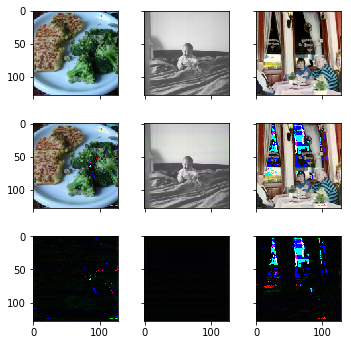


Epoch :  134 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1257987	 | Time     : 233.771733 |
Adversary | Loss  :  0.4503527	 | Accuracy :  0.8526652 |
Encoder   | Loss  :  0.0030338	 | Accuracy :  0.7777882 |
Decoder   | Loss  :  0.1224446	 | Accuracy :  0.8299299 |
Adversary | Loss  :  1.2303826	 | Accuracy :  0.1651652 |

Validation - 
Validate  | Loss  :  0.1247804	 | Time     :  19.687568 |
Encoder   | Loss  :  0.0036431	 | Accuracy :  0.7605579 |
Decoder   | Loss  :  0.1218628	 | Accuracy :  0.8254518 |
Adversary | Loss  :  0.3674509	 | Accuracy :  0.9633533 |


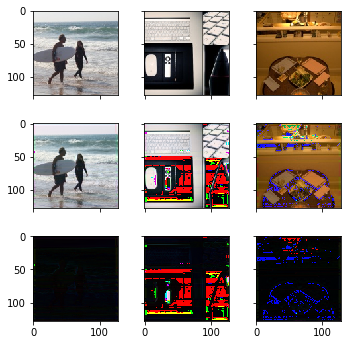


Epoch :  135 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1216475	 | Time     : 232.899203 |
Adversary | Loss  :  0.3464078	 | Accuracy :  0.9513889 |
Encoder   | Loss  :  0.0029101	 | Accuracy :  0.7782966 |
Decoder   | Loss  :  0.1175643	 | Accuracy :  0.8395019 |
Adversary | Loss  :  2.0461144	 | Accuracy :  0.0295295 |

Validation - 
Validate  | Loss  :  0.1189258	 | Time     :  19.560284 |
Encoder   | Loss  :  0.0033230	 | Accuracy :  0.8154111 |
Decoder   | Loss  :  0.1161696	 | Accuracy :  0.8409137 |
Adversary | Loss  :  0.4300565	 | Accuracy :  0.9141566 |


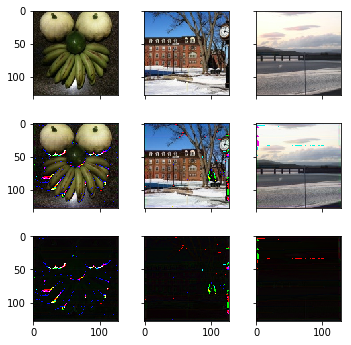


Epoch :  136 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1573330	 | Time     : 233.513654 |
Adversary | Loss  :  0.1995746	 | Accuracy :  0.9320571 |
Encoder   | Loss  :  0.0163989	 | Accuracy :  0.7639583 |
Decoder   | Loss  :  0.1403473	 | Accuracy :  0.7881006 |
Adversary | Loss  :  5.5064878	 | Accuracy :  0.0137638 |

Validation - 
Validate  | Loss  :  0.2784279	 | Time     :  19.957679 |
Encoder   | Loss  :  0.0913324	 | Accuracy :  0.7229786 |
Decoder   | Loss  :  0.2143859	 | Accuracy :  0.6106929 |
Adversary | Loss  :  0.1092976	 | Accuracy :  0.9442771 |


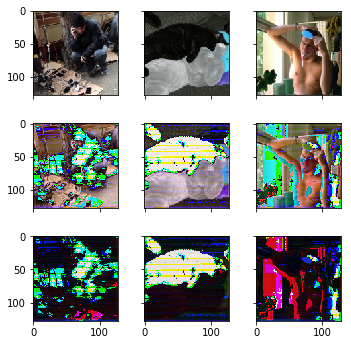


Epoch :  137 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.2086580	 | Time     : 232.673390 |
Adversary | Loss  :  0.0071285	 | Accuracy :  0.7986737 |
Encoder   | Loss  :  0.0157476	 | Accuracy :  0.7378743 |
Decoder   | Loss  :  0.1824463	 | Accuracy :  0.6832041 |
Adversary | Loss  : 15.1883450	 | Accuracy :  0.0001251 |

Validation - 
Validate  | Loss  :  0.1759705	 | Time     :  19.598106 |
Encoder   | Loss  :  0.0082891	 | Accuracy :  0.7489728 |
Decoder   | Loss  :  0.1701559	 | Accuracy :  0.7210676 |
Adversary | Loss  :  0.0122665	 | Accuracy :  0.7876507 |


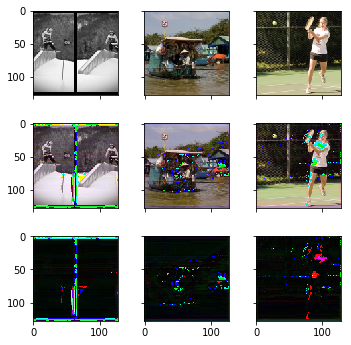


Epoch :  138 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1860099	 | Time     : 232.017196 |
Adversary | Loss  :  0.0008343	 | Accuracy :  0.5795796 |
Encoder   | Loss  :  0.0080267	 | Accuracy :  0.7584051 |
Decoder   | Loss  :  0.1645288	 | Accuracy :  0.7357983 |
Adversary | Loss  : 15.8624659	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1641908	 | Time     :  19.757410 |
Encoder   | Loss  :  0.0087547	 | Accuracy :  0.7825900 |
Decoder   | Loss  :  0.1580623	 | Accuracy :  0.7514224 |
Adversary | Loss  :  0.0002371	 | Accuracy :  0.6169679 |


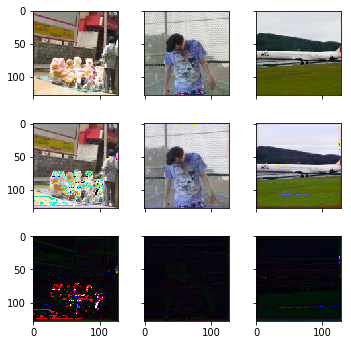


Epoch :  139 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1750629	 | Time     : 232.563494 |
Adversary | Loss  :  0.0002778	 | Accuracy :  0.4209835 |
Encoder   | Loss  :  0.0060033	 | Accuracy :  0.7676121 |
Decoder   | Loss  :  0.1549324	 | Accuracy :  0.7615824 |
Adversary | Loss  : 15.9281797	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1546563	 | Time     :  19.680539 |
Encoder   | Loss  :  0.0049209	 | Accuracy :  0.7907662 |
Decoder   | Loss  :  0.1511953	 | Accuracy :  0.7665495 |
Adversary | Loss  :  0.0164329	 | Accuracy :  0.1561245 |


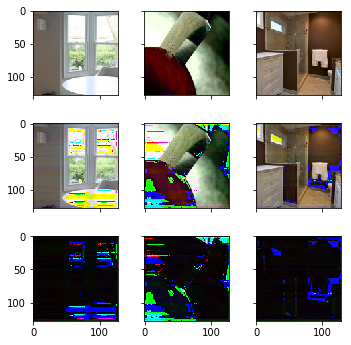


Epoch :  140 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1680641	 | Time     : 232.466674 |
Adversary | Loss  :  0.0001295	 | Accuracy :  0.3270145 |
Encoder   | Loss  :  0.0048727	 | Accuracy :  0.7696431 |
Decoder   | Loss  :  0.1487168	 | Accuracy :  0.7765849 |
Adversary | Loss  : 15.9364357	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1479651	 | Time     :  19.658501 |
Encoder   | Loss  :  0.0043482	 | Accuracy :  0.7825521 |
Decoder   | Loss  :  0.1449095	 | Accuracy :  0.7816934 |
Adversary | Loss  :  0.0118484	 | Accuracy :  0.3825301 |


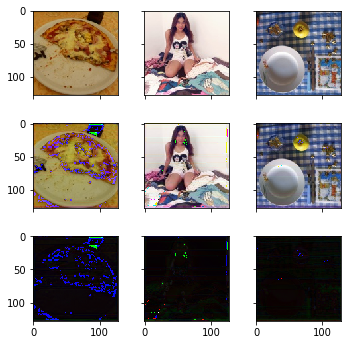


Epoch :  141 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1599991	 | Time     : 232.552172 |
Adversary | Loss  :  0.0002511	 | Accuracy :  0.2515641 |
Encoder   | Loss  :  0.0042453	 | Accuracy :  0.7682037 |
Decoder   | Loss  :  0.1410979	 | Accuracy :  0.7940399 |
Adversary | Loss  : 15.9294767	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1396124	 | Time     :  19.698112 |
Encoder   | Loss  :  0.0043469	 | Accuracy :  0.7601278 |
Decoder   | Loss  :  0.1365693	 | Accuracy :  0.8000001 |
Adversary | Loss  :  0.0003500	 | Accuracy :  0.3433735 |


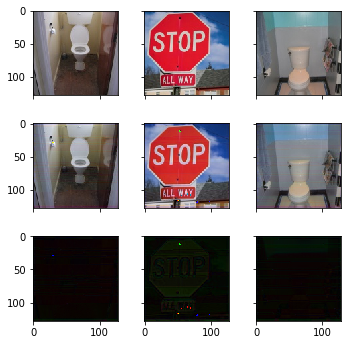


Epoch :  142 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1520699	 | Time     : 232.352703 |
Adversary | Loss  :  0.0000610	 | Accuracy :  0.1677928 |
Encoder   | Loss  :  0.0038423	 | Accuracy :  0.7676362 |
Decoder   | Loss  :  0.1334396	 | Accuracy :  0.8071697 |
Adversary | Loss  : 15.9407167	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1331217	 | Time     :  19.460735 |
Encoder   | Loss  :  0.0026252	 | Accuracy :  0.8025445 |
Decoder   | Loss  :  0.1312840	 | Accuracy :  0.8075636 |
Adversary | Loss  :  0.0001085	 | Accuracy :  0.0170683 |


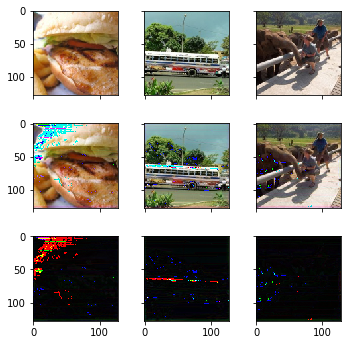


Epoch :  143 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1468608	 | Time     : 232.230105 |
Adversary | Loss  :  0.0011072	 | Accuracy :  0.1738614 |
Encoder   | Loss  :  0.0034036	 | Accuracy :  0.7714210 |
Decoder   | Loss  :  0.1285723	 | Accuracy :  0.8159202 |
Adversary | Loss  : 15.9060650	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1284342	 | Time     :  19.727356 |
Encoder   | Loss  :  0.0030730	 | Accuracy :  0.7647306 |
Decoder   | Loss  :  0.1262594	 | Accuracy :  0.8179049 |
Adversary | Loss  :  0.0236661	 | Accuracy :  0.5100402 |


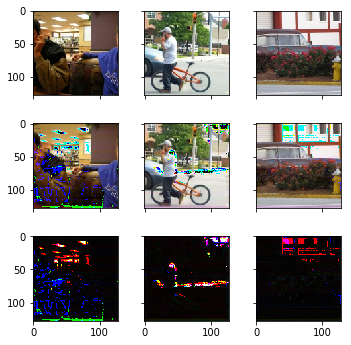


Epoch :  144 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1419607	 | Time     : 232.314308 |
Adversary | Loss  :  0.0000290	 | Accuracy :  0.0524900 |
Encoder   | Loss  :  0.0030930	 | Accuracy :  0.7789981 |
Decoder   | Loss  :  0.1238532	 | Accuracy :  0.8244953 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1241771	 | Time     :  19.623813 |
Encoder   | Loss  :  0.0049768	 | Accuracy :  0.7539280 |
Decoder   | Loss  :  0.1206913	 | Accuracy :  0.8259371 |
Adversary | Loss  :  0.0020827	 | Accuracy :  0.2976908 |


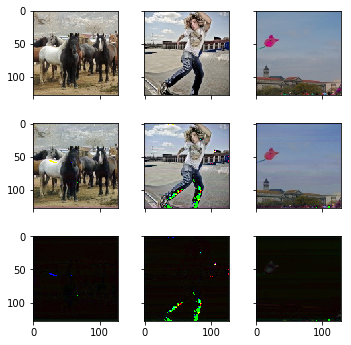


Epoch :  145 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1374626	 | Time     : 232.767427 |
Adversary | Loss  :  0.0001659	 | Accuracy :  0.0701326 |
Encoder   | Loss  :  0.0028529	 | Accuracy :  0.7815815 |
Decoder   | Loss  :  0.1195263	 | Accuracy :  0.8324199 |
Adversary | Loss  : 15.9392271	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1175247	 | Time     :  19.717927 |
Encoder   | Loss  :  0.0020240	 | Accuracy :  0.7758259 |
Decoder   | Loss  :  0.1161078	 | Accuracy :  0.8351907 |
Adversary | Loss  :  0.0001304	 | Accuracy :  0.0311245 |


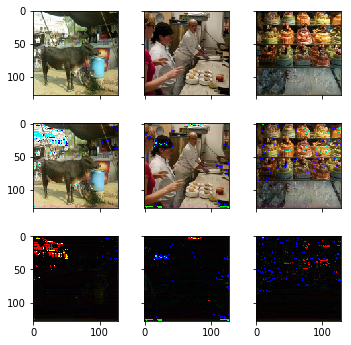


Epoch :  146 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1321193	 | Time     : 232.247101 |
Adversary | Loss  :  0.0000093	 | Accuracy :  0.0520520 |
Encoder   | Loss  :  0.0026620	 | Accuracy :  0.7867348 |
Decoder   | Loss  :  0.1143135	 | Accuracy :  0.8415665 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1123481	 | Time     :  19.572942 |
Encoder   | Loss  :  0.0018924	 | Accuracy :  0.8309247 |
Decoder   | Loss  :  0.1110234	 | Accuracy :  0.8467034 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.1335341 |


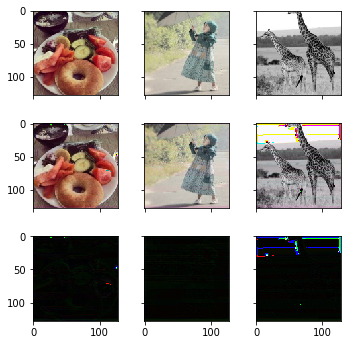


Epoch :  147 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1262938	 | Time     : 232.395040 |
Adversary | Loss  :  0.0012394	 | Accuracy :  0.0663163 |
Encoder   | Loss  :  0.0024912	 | Accuracy :  0.7937430 |
Decoder   | Loss  :  0.1086147	 | Accuracy :  0.8530614 |
Adversary | Loss  : 15.9352007	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.1056769	 | Time     :  19.655361 |
Encoder   | Loss  :  0.0017982	 | Accuracy :  0.8103203 |
Decoder   | Loss  :  0.1044180	 | Accuracy :  0.8538153 |
Adversary | Loss  :  0.0001202	 | Accuracy :  0.0306225 |


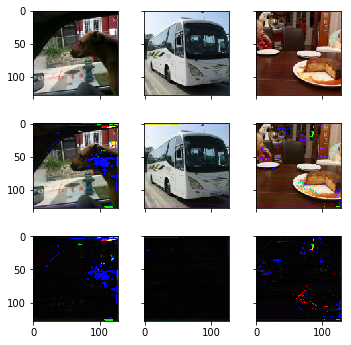


Epoch :  148 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1202927	 | Time     : 232.043368 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0045671 |
Encoder   | Loss  :  0.0024260	 | Accuracy :  0.7979113 |
Decoder   | Loss  :  0.1026521	 | Accuracy :  0.8635344 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0999001	 | Time     :  19.650151 |
Encoder   | Loss  :  0.0015671	 | Accuracy :  0.8516288 |
Decoder   | Loss  :  0.0988031	 | Accuracy :  0.8653447 |
Adversary | Loss  :  0.0000047	 | Accuracy :  0.0095382 |


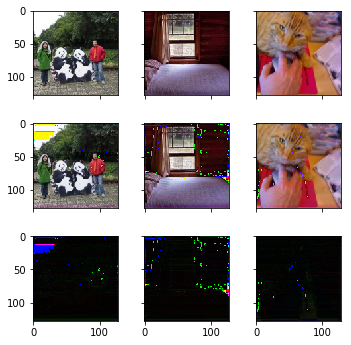


Epoch :  149 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1140727	 | Time     : 232.427150 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0045045 |
Encoder   | Loss  :  0.0023344	 | Accuracy :  0.7998001 |
Decoder   | Loss  :  0.0964962	 | Accuracy :  0.8736320 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0946624	 | Time     :  19.758841 |
Encoder   | Loss  :  0.0040021	 | Accuracy :  0.7199259 |
Decoder   | Loss  :  0.0918608	 | Accuracy :  0.8780288 |
Adversary | Loss  :  0.0000747	 | Accuracy :  0.0301205 |


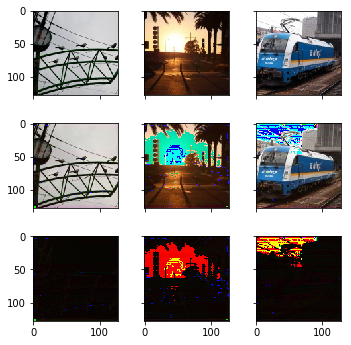


Epoch :  150 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1081836	 | Time     : 232.212944 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0041291 |
Encoder   | Loss  :  0.0021400	 | Accuracy :  0.8047678 |
Decoder   | Loss  :  0.0907432	 | Accuracy :  0.8827744 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0878695	 | Time     :  19.700767 |
Encoder   | Loss  :  0.0016445	 | Accuracy :  0.7866682 |
Decoder   | Loss  :  0.0867169	 | Accuracy :  0.8867971 |
Adversary | Loss  :  0.0014272	 | Accuracy :  0.0271084 |


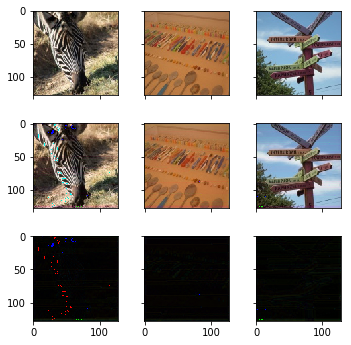


Epoch :  151 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.1033417	 | Time     : 234.251314 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0048799 |
Encoder   | Loss  :  0.0022443	 | Accuracy :  0.8009979 |
Decoder   | Loss  :  0.0858283	 | Accuracy :  0.8887679 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0843755	 | Time     :  19.673296 |
Encoder   | Loss  :  0.0019324	 | Accuracy :  0.8157084 |
Decoder   | Loss  :  0.0830228	 | Accuracy :  0.8898929 |
Adversary | Loss  :  0.0000236	 | Accuracy :  0.0065261 |


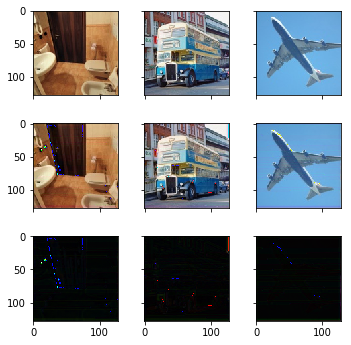


Epoch :  152 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0992910	 | Time     : 231.325678 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0045671 |
Encoder   | Loss  :  0.0022091	 | Accuracy :  0.8021287 |
Decoder   | Loss  :  0.0818023	 | Accuracy :  0.8921129 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0818116	 | Time     :  19.865414 |
Encoder   | Loss  :  0.0019268	 | Accuracy :  0.8437957 |
Decoder   | Loss  :  0.0804622	 | Accuracy :  0.8905622 |
Adversary | Loss  :  0.0007305	 | Accuracy :  0.0261044 |


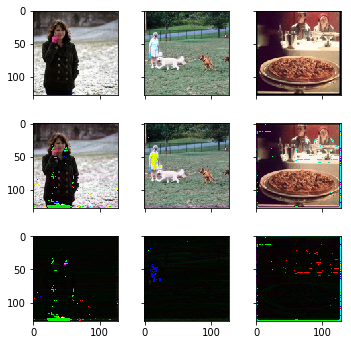


Epoch :  153 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0961072	 | Time     : 232.528447 |
Adversary | Loss  :  0.0011733	 | Accuracy :  0.0287788 |
Encoder   | Loss  :  0.0020958	 | Accuracy :  0.8051957 |
Decoder   | Loss  :  0.0787046	 | Accuracy :  0.8944361 |
Adversary | Loss  : 15.9354506	 | Accuracy :  0.0001251 |

Validation - 
Validate  | Loss  :  0.0813587	 | Time     :  19.596586 |
Encoder   | Loss  :  0.0020234	 | Accuracy :  0.7515313 |
Decoder   | Loss  :  0.0799316	 | Accuracy :  0.8925871 |
Adversary | Loss  :  0.0107536	 | Accuracy :  0.0125502 |


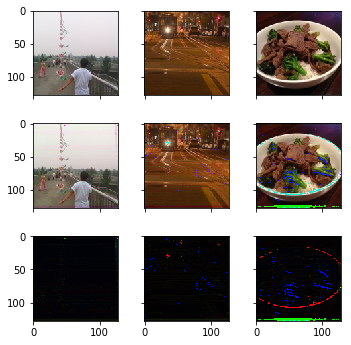


Epoch :  154 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0927125	 | Time     : 231.675508 |
Adversary | Loss  :  0.0000656	 | Accuracy :  0.0383509 |
Encoder   | Loss  :  0.0021659	 | Accuracy :  0.8045961 |
Decoder   | Loss  :  0.0752540	 | Accuracy :  0.8973140 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0769117	 | Time     :  19.641064 |
Encoder   | Loss  :  0.0034620	 | Accuracy :  0.7872021 |
Decoder   | Loss  :  0.0744882	 | Accuracy :  0.8966868 |
Adversary | Loss  :  0.0000953	 | Accuracy :  0.0075301 |


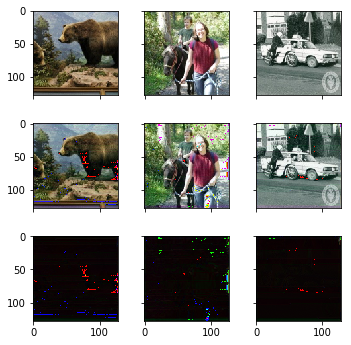


Epoch :  155 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0900746	 | Time     : 233.045470 |
Adversary | Loss  :  0.0000615	 | Accuracy :  0.0401026 |
Encoder   | Loss  :  0.0020361	 | Accuracy :  0.8070521 |
Decoder   | Loss  :  0.0727087	 | Accuracy :  0.8991699 |
Adversary | Loss  : 15.9406090	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0720457	 | Time     :  19.851260 |
Encoder   | Loss  :  0.0011705	 | Accuracy :  0.8047333 |
Decoder   | Loss  :  0.0712263	 | Accuracy :  0.8982430 |
Adversary | Loss  :  0.0000975	 | Accuracy :  0.0135542 |


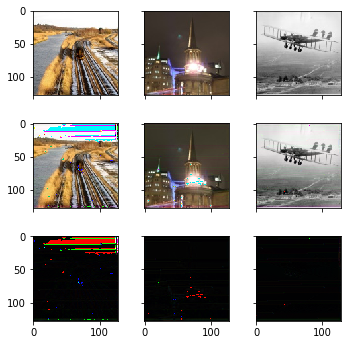


Epoch :  156 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0876919	 | Time     : 232.834810 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0344720 |
Encoder   | Loss  :  0.0019731	 | Accuracy :  0.8053279 |
Decoder   | Loss  :  0.0703683	 | Accuracy :  0.9012137 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0706125	 | Time     :  19.598505 |
Encoder   | Loss  :  0.0016013	 | Accuracy :  0.8400675 |
Decoder   | Loss  :  0.0694916	 | Accuracy :  0.8988285 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0070281 |


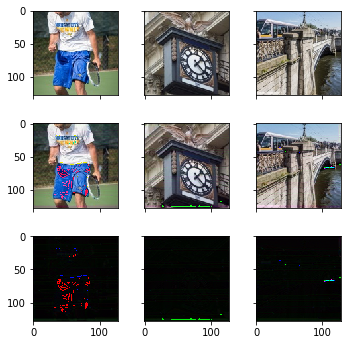


Epoch :  157 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0860330	 | Time     : 231.759908 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0370996 |
Encoder   | Loss  :  0.0020498	 | Accuracy :  0.8039687 |
Decoder   | Loss  :  0.0686558	 | Accuracy :  0.9016725 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0682239	 | Time     :  19.598596 |
Encoder   | Loss  :  0.0011313	 | Accuracy :  0.8526676 |
Decoder   | Loss  :  0.0674320	 | Accuracy :  0.9002007 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0185743 |


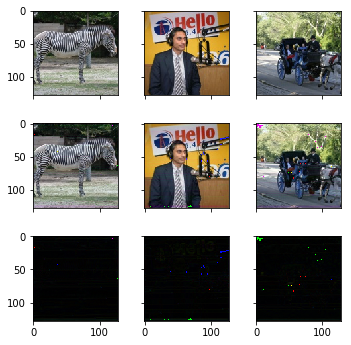


Epoch :  158 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0845716	 | Time     : 231.576436 |
Adversary | Loss  :  0.0000663	 | Accuracy :  0.0999750 |
Encoder   | Loss  :  0.0019629	 | Accuracy :  0.8073137 |
Decoder   | Loss  :  0.0672568	 | Accuracy :  0.9027318 |
Adversary | Loss  : 15.9407129	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0702518	 | Time     :  19.479379 |
Encoder   | Loss  :  0.0012306	 | Accuracy :  0.8572098 |
Decoder   | Loss  :  0.0693904	 | Accuracy :  0.8978915 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


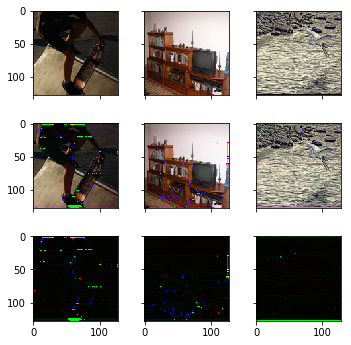


Epoch :  159 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0835230	 | Time     : 230.981833 |
Adversary | Loss  :  0.0001414	 | Accuracy :  0.0456707 |
Encoder   | Loss  :  0.0022587	 | Accuracy :  0.8036193 |
Decoder   | Loss  :  0.0659996	 | Accuracy :  0.9032825 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0672207	 | Time     :  19.490438 |
Encoder   | Loss  :  0.0019422	 | Accuracy :  0.7835348 |
Decoder   | Loss  :  0.0658592	 | Accuracy :  0.9021586 |
Adversary | Loss  :  0.0018783	 | Accuracy :  0.0165663 |


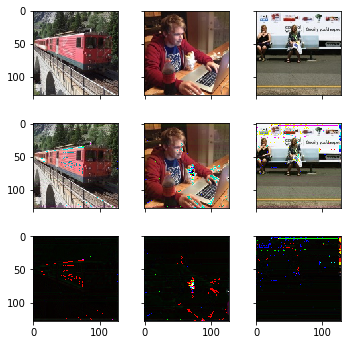


Epoch :  160 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0820000	 | Time     : 231.703994 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0006256 |
Encoder   | Loss  :  0.0019453	 | Accuracy :  0.8070142 |
Decoder   | Loss  :  0.0646959	 | Accuracy :  0.9041250 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0661583	 | Time     :  19.598429 |
Encoder   | Loss  :  0.0013407	 | Accuracy :  0.8237275 |
Decoder   | Loss  :  0.0652195	 | Accuracy :  0.8999666 |
Adversary | Loss  :  0.0002590	 | Accuracy :  0.0075301 |


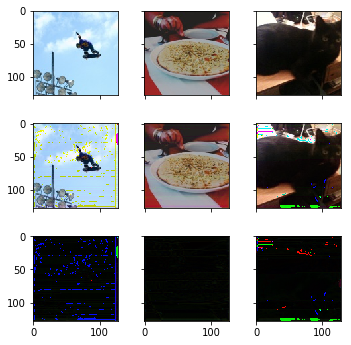


Epoch :  161 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0808775	 | Time     : 231.053650 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005631 |
Encoder   | Loss  :  0.0018925	 | Accuracy :  0.8105085 |
Decoder   | Loss  :  0.0636104	 | Accuracy :  0.9044044 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0660245	 | Time     :  19.761785 |
Encoder   | Loss  :  0.0019440	 | Accuracy :  0.8261864 |
Decoder   | Loss  :  0.0646523	 | Accuracy :  0.9020582 |
Adversary | Loss  :  0.0113827	 | Accuracy :  0.0195783 |


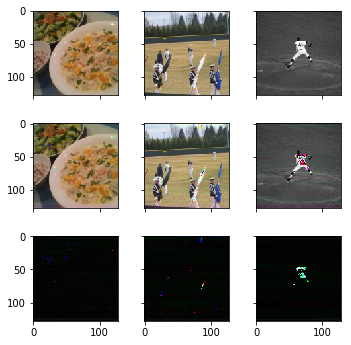


Epoch :  162 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0796794	 | Time     : 231.428153 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0006256 |
Encoder   | Loss  :  0.0018822	 | Accuracy :  0.8071151 |
Decoder   | Loss  :  0.0624195	 | Accuracy :  0.9055764 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0651849	 | Time     :  19.677816 |
Encoder   | Loss  :  0.0012981	 | Accuracy :  0.8277405 |
Decoder   | Loss  :  0.0642755	 | Accuracy :  0.8994980 |
Adversary | Loss  :  0.0006815	 | Accuracy :  0.0225904 |


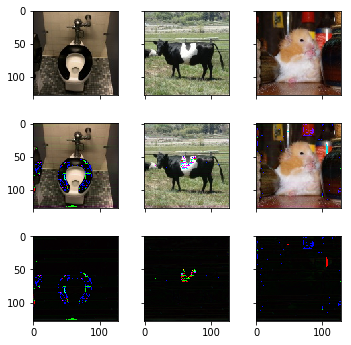


Epoch :  163 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0786791	 | Time     : 231.113718 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0004379 |
Encoder   | Loss  :  0.0018103	 | Accuracy :  0.8072713 |
Decoder   | Loss  :  0.0614695	 | Accuracy :  0.9063605 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0655300	 | Time     :  19.723957 |
Encoder   | Loss  :  0.0024516	 | Accuracy :  0.8454380 |
Decoder   | Loss  :  0.0638121	 | Accuracy :  0.9005857 |
Adversary | Loss  :  0.0017978	 | Accuracy :  0.0155623 |


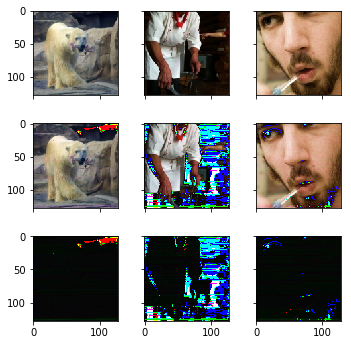


Epoch :  164 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0777208	 | Time     : 231.954363 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0006256 |
Encoder   | Loss  :  0.0016723	 | Accuracy :  0.8128409 |
Decoder   | Loss  :  0.0606078	 | Accuracy :  0.9071321 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0614334	 | Time     :  19.618167 |
Encoder   | Loss  :  0.0012644	 | Accuracy :  0.8159537 |
Decoder   | Loss  :  0.0605483	 | Accuracy :  0.9067771 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0045181 |


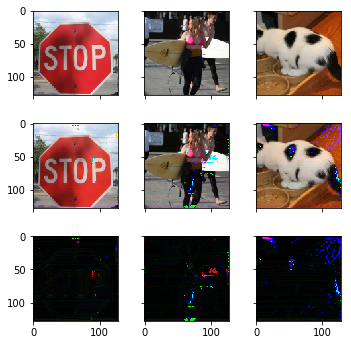


Epoch :  165 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0772310	 | Time     : 231.885112 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0008133 |
Encoder   | Loss  :  0.0016882	 | Accuracy :  0.8123928 |
Decoder   | Loss  :  0.0601068	 | Accuracy :  0.9075534 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0629480	 | Time     :  19.721836 |
Encoder   | Loss  :  0.0011655	 | Accuracy :  0.8232768 |
Decoder   | Loss  :  0.0621314	 | Accuracy :  0.9039490 |
Adversary | Loss  :  0.0007725	 | Accuracy :  0.0110442 |


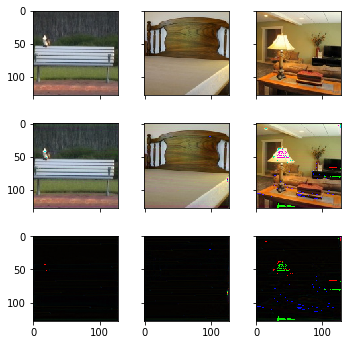


Epoch :  166 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0767028	 | Time     : 231.035457 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0006882 |
Encoder   | Loss  :  0.0016873	 | Accuracy :  0.8120129 |
Decoder   | Loss  :  0.0595793	 | Accuracy :  0.9080372 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0613043	 | Time     :  19.331314 |
Encoder   | Loss  :  0.0009086	 | Accuracy :  0.8228090 |
Decoder   | Loss  :  0.0606590	 | Accuracy :  0.9047188 |
Adversary | Loss  :  0.0093126	 | Accuracy :  0.0376506 |


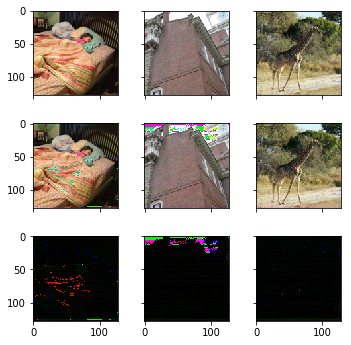


Epoch :  167 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0758940	 | Time     : 231.610817 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005631 |
Encoder   | Loss  :  0.0016575	 | Accuracy :  0.8098306 |
Decoder   | Loss  :  0.0587913	 | Accuracy :  0.9084125 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0597614	 | Time     :  19.726516 |
Encoder   | Loss  :  0.0019344	 | Accuracy :  0.7938806 |
Decoder   | Loss  :  0.0584069	 | Accuracy :  0.9064424 |
Adversary | Loss  :  0.0004771	 | Accuracy :  0.0120482 |


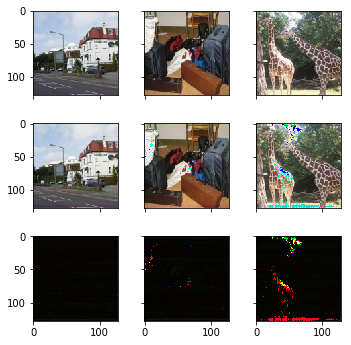


Epoch :  168 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0772605	 | Time     : 231.209212 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0006256 |
Encoder   | Loss  :  0.0016944	 | Accuracy :  0.8077341 |
Decoder   | Loss  :  0.0601320	 | Accuracy :  0.9073616 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0634626	 | Time     :  19.708061 |
Encoder   | Loss  :  0.0009978	 | Accuracy :  0.8482774 |
Decoder   | Loss  :  0.0627609	 | Accuracy :  0.9007363 |
Adversary | Loss  :  0.0032713	 | Accuracy :  0.0466867 |


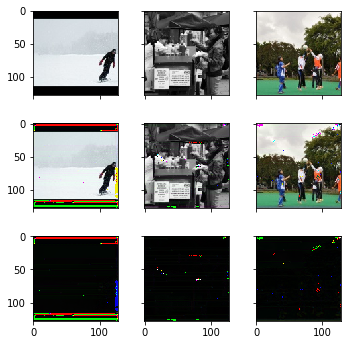


Epoch :  169 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0748559	 | Time     : 231.446209 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0008759 |
Encoder   | Loss  :  0.0015817	 | Accuracy :  0.8166711 |
Decoder   | Loss  :  0.0578064	 | Accuracy :  0.9091800 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0594952	 | Time     :  19.254915 |
Encoder   | Loss  :  0.0013144	 | Accuracy :  0.8077692 |
Decoder   | Loss  :  0.0585736	 | Accuracy :  0.9063588 |
Adversary | Loss  :  0.0015236	 | Accuracy :  0.0140562 |


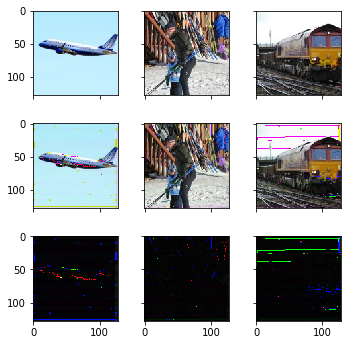


Epoch :  170 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0744123	 | Time     : 231.034721 |
Adversary | Loss  :  0.0004373	 | Accuracy :  0.0140766 |
Encoder   | Loss  :  0.0016689	 | Accuracy :  0.8144255 |
Decoder   | Loss  :  0.0573092	 | Accuracy :  0.9094469 |
Adversary | Loss  : 15.9347668	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0600488	 | Time     :  19.660398 |
Encoder   | Loss  :  0.0009430	 | Accuracy :  0.8659225 |
Decoder   | Loss  :  0.0593888	 | Accuracy :  0.9057731 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0055221 |


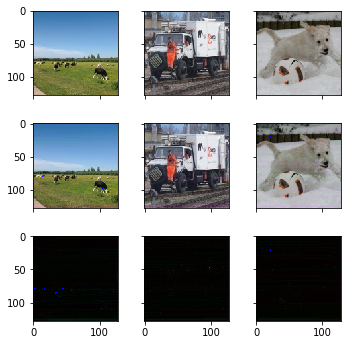


Epoch :  171 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0741010	 | Time     : 232.687422 |
Adversary | Loss  :  0.0000650	 | Accuracy :  0.0198949 |
Encoder   | Loss  :  0.0016005	 | Accuracy :  0.8180138 |
Decoder   | Loss  :  0.0570401	 | Accuracy :  0.9102311 |
Adversary | Loss  : 15.9405260	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0585527	 | Time     :  19.629380 |
Encoder   | Loss  :  0.0012984	 | Accuracy :  0.8159665 |
Decoder   | Loss  :  0.0576438	 | Accuracy :  0.9049197 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0030120 |


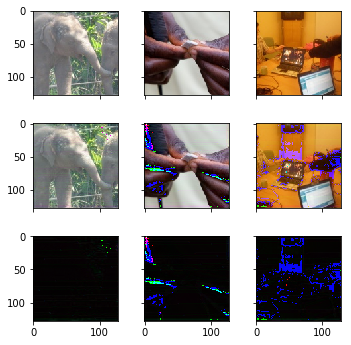


Epoch :  172 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0738511	 | Time     : 231.349009 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0033784 |
Encoder   | Loss  :  0.0015498	 | Accuracy :  0.8178439 |
Decoder   | Loss  :  0.0568238	 | Accuracy :  0.9102268 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0608603	 | Time     :  19.557577 |
Encoder   | Loss  :  0.0012019	 | Accuracy :  0.8548459 |
Decoder   | Loss  :  0.0600184	 | Accuracy :  0.9054886 |
Adversary | Loss  :  0.0006367	 | Accuracy :  0.0230924 |


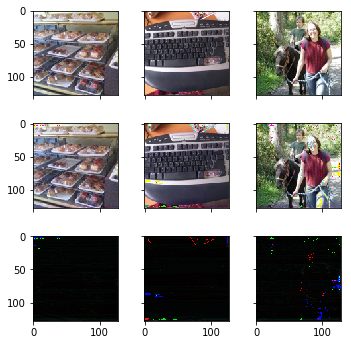


Epoch :  173 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0738815	 | Time     : 231.219378 |
Adversary | Loss  :  0.0000352	 | Accuracy :  0.0096972 |
Encoder   | Loss  :  0.0017575	 | Accuracy :  0.8134803 |
Decoder   | Loss  :  0.0567089	 | Accuracy :  0.9097680 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0595143	 | Time     :  19.481329 |
Encoder   | Loss  :  0.0017998	 | Accuracy :  0.7600164 |
Decoder   | Loss  :  0.0582544	 | Accuracy :  0.9068273 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015060 |


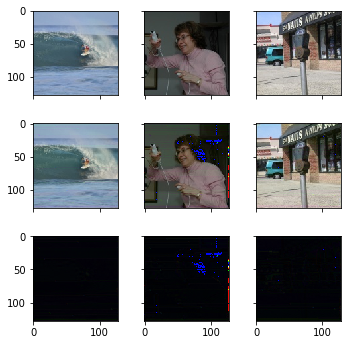


Epoch :  174 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0731088	 | Time     : 231.424266 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0007508 |
Encoder   | Loss  :  0.0015290	 | Accuracy :  0.8209673 |
Decoder   | Loss  :  0.0560960	 | Accuracy :  0.9097598 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0581964	 | Time     :  19.392403 |
Encoder   | Loss  :  0.0010815	 | Accuracy :  0.8600144 |
Decoder   | Loss  :  0.0574393	 | Accuracy :  0.9077476 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


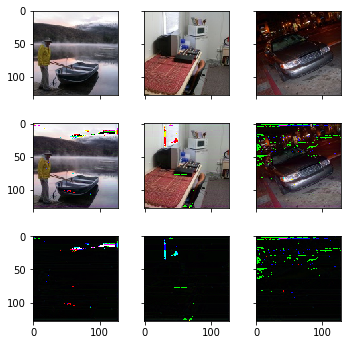


Epoch :  175 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0728496	 | Time     : 231.841208 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0008759 |
Encoder   | Loss  :  0.0015010	 | Accuracy :  0.8191425 |
Decoder   | Loss  :  0.0558565	 | Accuracy :  0.9101851 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0594065	 | Time     :  19.662193 |
Encoder   | Loss  :  0.0009774	 | Accuracy :  0.8359810 |
Decoder   | Loss  :  0.0587223	 | Accuracy :  0.9062248 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0025100 |


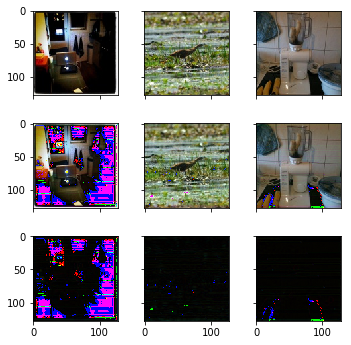


Epoch :  176 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0724013	 | Time     : 231.764942 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005631 |
Encoder   | Loss  :  0.0014550	 | Accuracy :  0.8190681 |
Decoder   | Loss  :  0.0554404	 | Accuracy :  0.9105855 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0571207	 | Time     :  19.463532 |
Encoder   | Loss  :  0.0009993	 | Accuracy :  0.8387038 |
Decoder   | Loss  :  0.0564209	 | Accuracy :  0.9063252 |
Adversary | Loss  :  0.0002862	 | Accuracy :  0.0391566 |


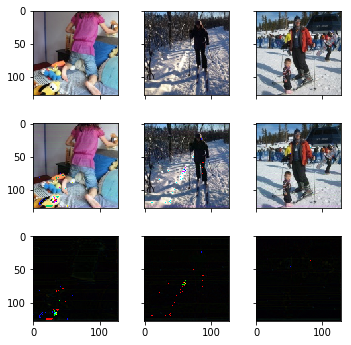


Epoch :  177 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0724791	 | Time     : 231.847677 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0003754 |
Encoder   | Loss  :  0.0014902	 | Accuracy :  0.8191926 |
Decoder   | Loss  :  0.0554935	 | Accuracy :  0.9103646 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0593278	 | Time     :  19.764252 |
Encoder   | Loss  :  0.0015350	 | Accuracy :  0.8408192 |
Decoder   | Loss  :  0.0582532	 | Accuracy :  0.9057563 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


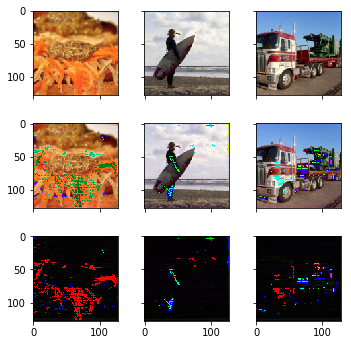


Epoch :  178 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0725485	 | Time     : 232.083834 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0008133 |
Encoder   | Loss  :  0.0017090	 | Accuracy :  0.8138803 |
Decoder   | Loss  :  0.0554098	 | Accuracy :  0.9106898 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0584015	 | Time     :  19.430659 |
Encoder   | Loss  :  0.0012851	 | Accuracy :  0.8301668 |
Decoder   | Loss  :  0.0575019	 | Accuracy :  0.9037818 |
Adversary | Loss  :  0.0000713	 | Accuracy :  0.0060241 |


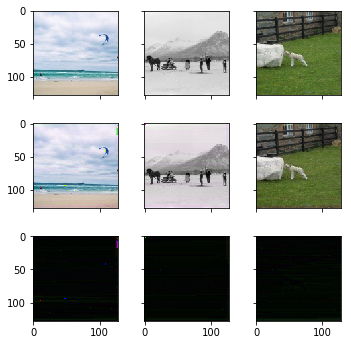


Epoch :  179 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0717464	 | Time     : 231.993472 |
Adversary | Loss  :  0.0001457	 | Accuracy :  0.0076952 |
Encoder   | Loss  :  0.0014590	 | Accuracy :  0.8224484 |
Decoder   | Loss  :  0.0547827	 | Accuracy :  0.9115907 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0595035	 | Time     :  19.550118 |
Encoder   | Loss  :  0.0014333	 | Accuracy :  0.8561098 |
Decoder   | Loss  :  0.0585002	 | Accuracy :  0.9061244 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0120482 |


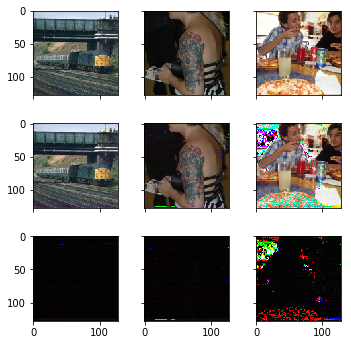


Epoch :  180 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0717503	 | Time     : 231.494146 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0033158 |
Encoder   | Loss  :  0.0014456	 | Accuracy :  0.8196061 |
Decoder   | Loss  :  0.0547960	 | Accuracy :  0.9106857 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0564728	 | Time     :  19.540719 |
Encoder   | Loss  :  0.0012546	 | Accuracy :  0.8492844 |
Decoder   | Loss  :  0.0555946	 | Accuracy :  0.9096051 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0010040 |


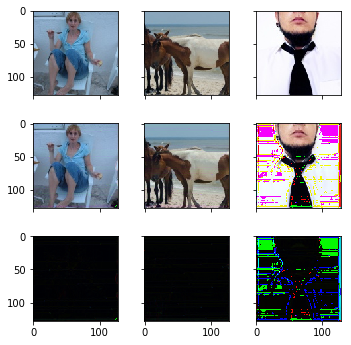


Epoch :  181 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0714762	 | Time     : 230.779623 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0033784 |
Encoder   | Loss  :  0.0014571	 | Accuracy :  0.8189288 |
Decoder   | Loss  :  0.0545138	 | Accuracy :  0.9112195 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0577938	 | Time     :  19.589880 |
Encoder   | Loss  :  0.0008563	 | Accuracy :  0.8345721 |
Decoder   | Loss  :  0.0571944	 | Accuracy :  0.9078479 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0025100 |


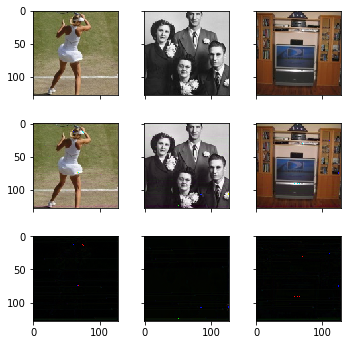


Epoch :  182 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0711539	 | Time     : 232.055766 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0029404 |
Encoder   | Loss  :  0.0013819	 | Accuracy :  0.8206221 |
Decoder   | Loss  :  0.0542442	 | Accuracy :  0.9117534 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0575823	 | Time     :  19.332157 |
Encoder   | Loss  :  0.0016003	 | Accuracy :  0.8598833 |
Decoder   | Loss  :  0.0564621	 | Accuracy :  0.9075134 |
Adversary | Loss  :  0.0000049	 | Accuracy :  0.0150602 |


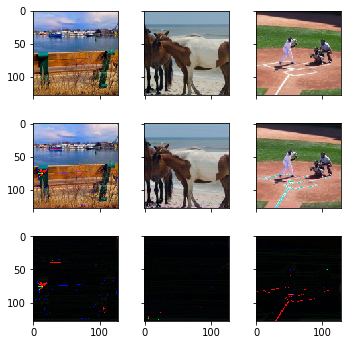


Epoch :  183 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0709185	 | Time     : 231.350496 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0036912 |
Encoder   | Loss  :  0.0014171	 | Accuracy :  0.8239604 |
Decoder   | Loss  :  0.0539841	 | Accuracy :  0.9122497 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0577175	 | Time     :  19.543382 |
Encoder   | Loss  :  0.0015546	 | Accuracy :  0.8005593 |
Decoder   | Loss  :  0.0566293	 | Accuracy :  0.9089692 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0155623 |


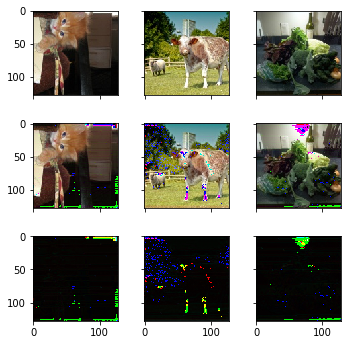


Epoch :  184 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0708048	 | Time     : 231.842075 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0033158 |
Encoder   | Loss  :  0.0013715	 | Accuracy :  0.8221129 |
Decoder   | Loss  :  0.0539024	 | Accuracy :  0.9121455 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0572894	 | Time     :  19.656326 |
Encoder   | Loss  :  0.0007760	 | Accuracy :  0.8682755 |
Decoder   | Loss  :  0.0567462	 | Accuracy :  0.9054718 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0140562 |


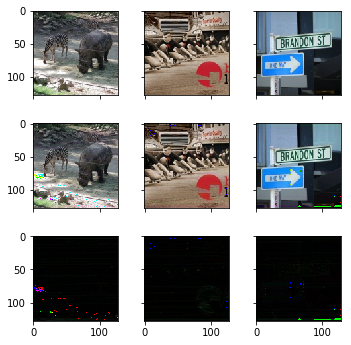


Epoch :  185 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0705260	 | Time     : 231.820011 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0040040 |
Encoder   | Loss  :  0.0013635	 | Accuracy :  0.8218007 |
Decoder   | Loss  :  0.0536292	 | Accuracy :  0.9128878 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0565362	 | Time     :  19.653806 |
Encoder   | Loss  :  0.0009748	 | Accuracy :  0.8151975 |
Decoder   | Loss  :  0.0558538	 | Accuracy :  0.9077979 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0065261 |


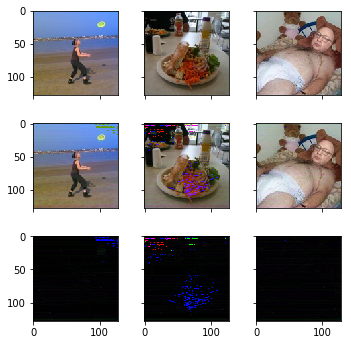


Epoch :  186 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0704416	 | Time     : 231.329656 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0031281 |
Encoder   | Loss  :  0.0014066	 | Accuracy :  0.8200709 |
Decoder   | Loss  :  0.0535146	 | Accuracy :  0.9131381 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0586511	 | Time     :  19.474947 |
Encoder   | Loss  :  0.0015543	 | Accuracy :  0.7803560 |
Decoder   | Loss  :  0.0575629	 | Accuracy :  0.9085843 |
Adversary | Loss  :  0.0002553	 | Accuracy :  0.1812249 |


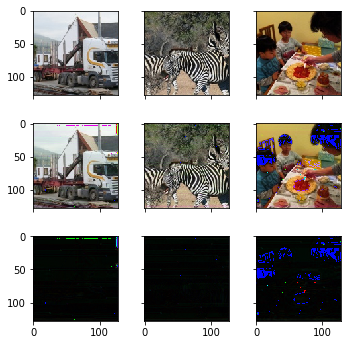


Epoch :  187 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0701857	 | Time     : 231.568312 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0033784 |
Encoder   | Loss  :  0.0014198	 | Accuracy :  0.8228248 |
Decoder   | Loss  :  0.0532495	 | Accuracy :  0.9129045 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0556328	 | Time     :  19.663416 |
Encoder   | Loss  :  0.0008929	 | Accuracy :  0.8715165 |
Decoder   | Loss  :  0.0550078	 | Accuracy :  0.9074966 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0040161 |


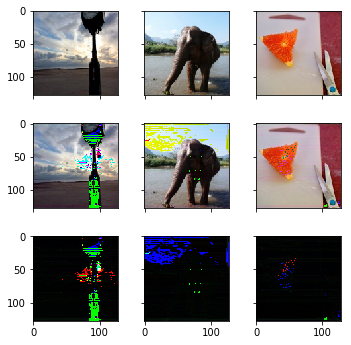


Epoch :  188 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0700247	 | Time     : 232.488875 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0032533 |
Encoder   | Loss  :  0.0014056	 | Accuracy :  0.8197418 |
Decoder   | Loss  :  0.0530984	 | Accuracy :  0.9136803 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0564456	 | Time     :  19.579670 |
Encoder   | Loss  :  0.0008351	 | Accuracy :  0.8233949 |
Decoder   | Loss  :  0.0558610	 | Accuracy :  0.9089021 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0000000 |


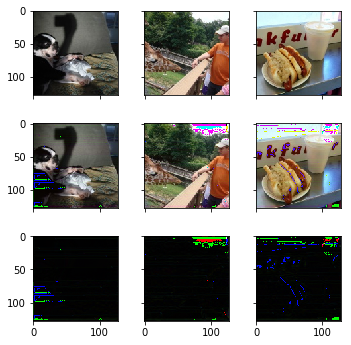


Epoch :  189 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0695995	 | Time     : 232.090950 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0029404 |
Encoder   | Loss  :  0.0013541	 | Accuracy :  0.8232129 |
Decoder   | Loss  :  0.0527093	 | Accuracy :  0.9139764 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0579312	 | Time     :  19.526934 |
Encoder   | Loss  :  0.0011246	 | Accuracy :  0.8059104 |
Decoder   | Loss  :  0.0571438	 | Accuracy :  0.9063754 |
Adversary | Loss  :  0.0000893	 | Accuracy :  0.0060241 |


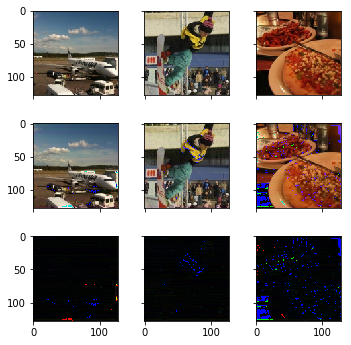


Epoch :  190 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0699830	 | Time     : 231.715891 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0029404 |
Encoder   | Loss  :  0.0014613	 | Accuracy :  0.8200198 |
Decoder   | Loss  :  0.0530177	 | Accuracy :  0.9134133 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0562709	 | Time     :  19.274576 |
Encoder   | Loss  :  0.0012192	 | Accuracy :  0.8182967 |
Decoder   | Loss  :  0.0554173	 | Accuracy :  0.9076974 |
Adversary | Loss  :  0.0001499	 | Accuracy :  0.0562249 |


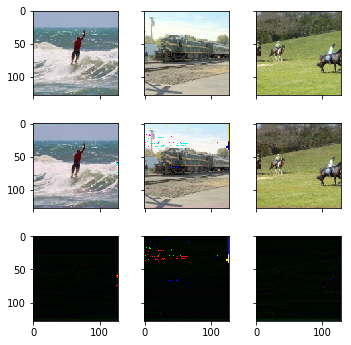


Epoch :  191 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0692956	 | Time     : 231.337266 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0029404 |
Encoder   | Loss  :  0.0013803	 | Accuracy :  0.8210829 |
Decoder   | Loss  :  0.0523870	 | Accuracy :  0.9142184 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0551976	 | Time     :  19.487265 |
Encoder   | Loss  :  0.0007410	 | Accuracy :  0.8618415 |
Decoder   | Loss  :  0.0546786	 | Accuracy :  0.9106091 |
Adversary | Loss  :  0.0002316	 | Accuracy :  0.0642570 |


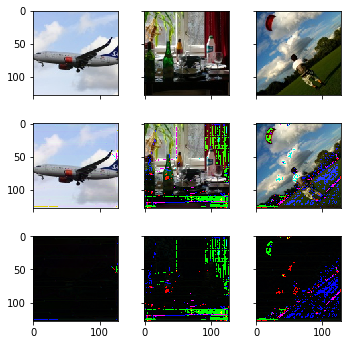


Epoch :  192 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0690178	 | Time     : 231.446416 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0031281 |
Encoder   | Loss  :  0.0013495	 | Accuracy :  0.8216271 |
Decoder   | Loss  :  0.0521307	 | Accuracy :  0.9149817 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0558927	 | Time     :  19.536740 |
Encoder   | Loss  :  0.0014050	 | Accuracy :  0.7984796 |
Decoder   | Loss  :  0.0549090	 | Accuracy :  0.9085510 |
Adversary | Loss  :  0.0001330	 | Accuracy :  0.0155623 |


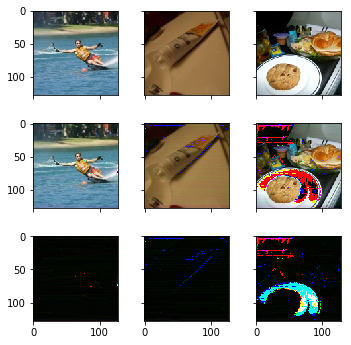


Epoch :  193 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0689416	 | Time     : 231.598838 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0028153 |
Encoder   | Loss  :  0.0014034	 | Accuracy :  0.8222355 |
Decoder   | Loss  :  0.0520168	 | Accuracy :  0.9154279 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0559048	 | Time     :  19.443120 |
Encoder   | Loss  :  0.0007991	 | Accuracy :  0.8620710 |
Decoder   | Loss  :  0.0553454	 | Accuracy :  0.9089692 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0080321 |


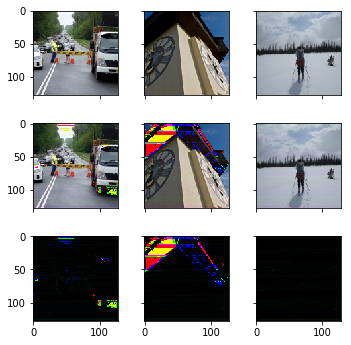


Epoch :  194 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0687077	 | Time     : 231.304224 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0033158 |
Encoder   | Loss  :  0.0013620	 | Accuracy :  0.8222743 |
Decoder   | Loss  :  0.0518119	 | Accuracy :  0.9155948 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0561408	 | Time     :  19.475384 |
Encoder   | Loss  :  0.0015546	 | Accuracy :  0.7602578 |
Decoder   | Loss  :  0.0550526	 | Accuracy :  0.9087850 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0020080 |


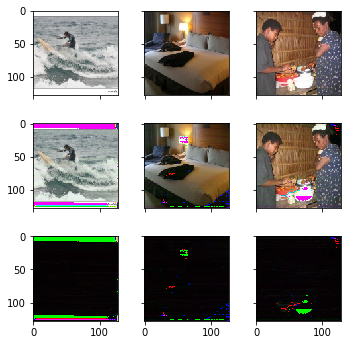


Epoch :  195 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0684993	 | Time     : 231.886958 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0034409 |
Encoder   | Loss  :  0.0012840	 | Accuracy :  0.8221930 |
Decoder   | Loss  :  0.0516582	 | Accuracy :  0.9166791 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0554752	 | Time     :  19.594368 |
Encoder   | Loss  :  0.0007555	 | Accuracy :  0.8598011 |
Decoder   | Loss  :  0.0549464	 | Accuracy :  0.9081994 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0225904 |


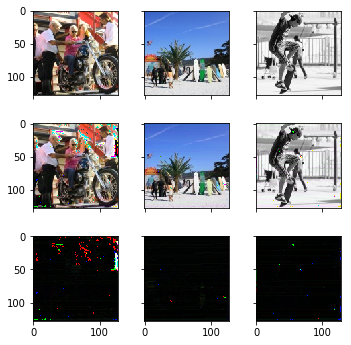


Epoch :  196 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0684782	 | Time     : 232.389403 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0036286 |
Encoder   | Loss  :  0.0013613	 | Accuracy :  0.8215520 |
Decoder   | Loss  :  0.0515829	 | Accuracy :  0.9162328 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0554385	 | Time     :  19.675142 |
Encoder   | Loss  :  0.0008242	 | Accuracy :  0.8424346 |
Decoder   | Loss  :  0.0548616	 | Accuracy :  0.9085342 |
Adversary | Loss  :  0.0000064	 | Accuracy :  0.0200803 |


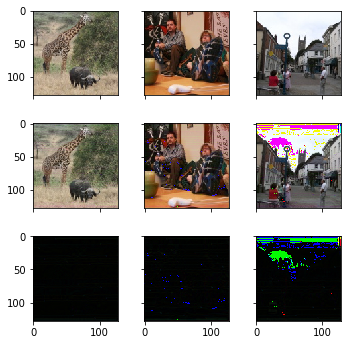


Epoch :  197 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0683841	 | Time     : 232.906874 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0028779 |
Encoder   | Loss  :  0.0014006	 | Accuracy :  0.8213875 |
Decoder   | Loss  :  0.0514612	 | Accuracy :  0.9164539 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0591263	 | Time     :  19.659752 |
Encoder   | Loss  :  0.0017412	 | Accuracy :  0.7649069 |
Decoder   | Loss  :  0.0579074	 | Accuracy :  0.9097724 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0020080 |


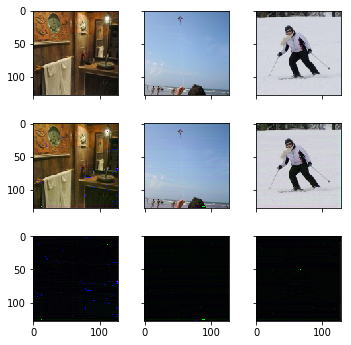


Epoch :  198 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0682363	 | Time     : 232.389927 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0029404 |
Encoder   | Loss  :  0.0013802	 | Accuracy :  0.8192503 |
Decoder   | Loss  :  0.0513278	 | Accuracy :  0.9173298 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0559870	 | Time     :  19.710893 |
Encoder   | Loss  :  0.0013787	 | Accuracy :  0.8149848 |
Decoder   | Loss  :  0.0550219	 | Accuracy :  0.9084002 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0005020 |


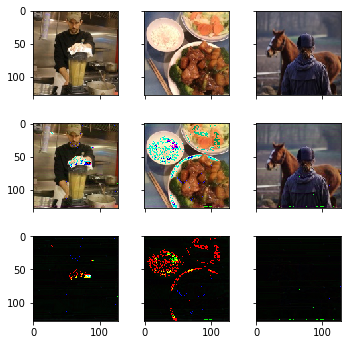


Epoch :  199 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0678548	 | Time     : 232.359041 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0031907 |
Encoder   | Loss  :  0.0012905	 | Accuracy :  0.8238394 |
Decoder   | Loss  :  0.0510091	 | Accuracy :  0.9173965 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0557195	 | Time     :  19.493934 |
Encoder   | Loss  :  0.0009551	 | Accuracy :  0.8498074 |
Decoder   | Loss  :  0.0550509	 | Accuracy :  0.9071118 |
Adversary | Loss  :  0.0000308	 | Accuracy :  0.0170683 |


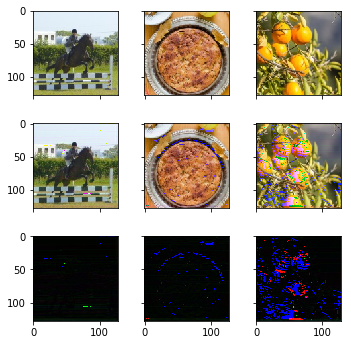


Epoch :  200 / 200 			 [########################################################|##############]

Training   - 
Train     | Loss  :  0.0678476	 | Time     : 232.528159 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0033158 |
Encoder   | Loss  :  0.0013228	 | Accuracy :  0.8201033 |
Decoder   | Loss  :  0.0509793	 | Accuracy :  0.9179221 |
Adversary | Loss  : 15.9423847	 | Accuracy :  0.0000000 |

Validation - 
Validate  | Loss  :  0.0567205	 | Time     :  19.510400 |
Encoder   | Loss  :  0.0008099	 | Accuracy :  0.8614535 |
Decoder   | Loss  :  0.0561536	 | Accuracy :  0.9082998 |
Adversary | Loss  :  0.0000001	 | Accuracy :  0.0015060 |


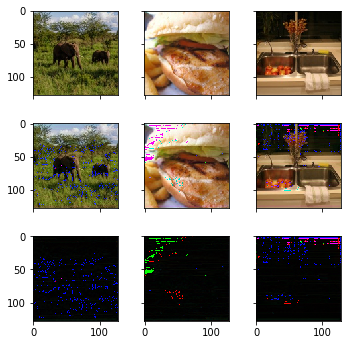

In [15]:
print('Training Complete Network')

loss, acc = [[], [], [], [], [], [], []], [[], [], [], [], [], []]
vloss, vacc = [[], [], [], [], [], [], []], [[], [], [], [], [], []]
advla = [[], []]

for epoch in range(n_epochs):
    print('\nEpoch : ', epoch+1, '/', n_epochs, '\t\t\t', '[', end='')
    batchscore = []
    adv_r, adv_f = [], []

    # Shuffle Data after each Epoch
    train_list, message_train = shuffle(train_list, message_train)
    
    tstartt = time.time()
    for nbatch in range(int(tbatches)):
        if nbatch%12 == 0:
            print('#', end='')
        
        # Generate Images
        r1, r2, r3 = DataGenerator(train_list, train_folder, message_train, nbatch)
        
        # Generate Encoder Images
        fake_images = encoder.predict([r1, r2])    
        
        adversary.trainable = True
        # Train Adversary on Real Images
        y_gen = np.zeros((np.int64(batch_size), 1))
        adv_r.append(adversary.train_on_batch(r1, y_gen))
        # Train Adversary on Fake Images
        y_gen = np.ones((np.int64(batch_size), 1))
        adv_f.append(adversary.train_on_batch(fake_images, y_gen))

        adversary.trainable = False
        # Train Combined
        # Original  - ones | Fool - zeros
        y_gen = np.zeros((np.int64(batch_size), 1))
        batchscore.append(combined.train_on_batch([r1, r2], [r1, r3, y_gen]))
        
        del fake_images, r1, r2, r3, y_gen
    print('|', end='')
    tendt = time.time()
    
    vstartt = time.time()
    vbatchscore = []
    for nbatch in range(int(vbatches)):
        if nbatch%12 == 0:
            print('#', end='')
        v1, v2, v3 = DataGenerator(validate_list, validate_folder, message_validate, nbatch)
        y_gen = np.ones((np.int64(batch_size), 1))
        vbatchscore.append(combined.test_on_batch([v1, v2], [v1, v3, y_gen]))
    vendt = time.time()
    print(']')
    
    # Calculating Metrics
    loss, acc, vloss, vacc, advla = calc_metric(loss, acc, vloss, vacc, advla, adv_r, adv_f, batchscore, vbatchscore)
    print_metric(loss, acc, vloss, vacc, advla, epoch, tendt-tstartt, vendt - vstartt)
    del batchscore, vbatchscore
    
    # Save Complete Model
    encoder.save('{:}complete-encoder-mse-{:02d}-{:1d}-{:03d}.h5'.format(modelpath, L, 0, epoch))
    decoder.save('{:}complete-decoder-mse-{:02d}-{:1d}-{:03d}.h5'.format(modelpath, L, 0, epoch))
    adversary.save('{:}complete-adversary-mse-{:02d}-{:1d}-{:03d}.h5'.format(modelpath, L, 0, epoch))
    
    # Print Images
    p1, p2, _ = DataGenerator(train_list, train_folder, message_train, 0, 3)
    out_img = encoder.predict([p1, p2])
    
    fig, ax = plt.subplots(3, 3, sharex='col', sharey='row', figsize=(5, 5))
    plt.tight_layout()
    for j in range(3):
        ax[0, j].imshow(cv2.cvtColor(arr_img(p1[j]), cv2.COLOR_BGR2RGB))
        ax[1, j].imshow(cv2.cvtColor(arr_img(out_img[j]), cv2.COLOR_BGR2RGB))
        diff1 = cv2.subtract(arr_img(out_img[j]), arr_img(p1[j]))
        diff2 = cv2.subtract(arr_img(p1[j]), arr_img(out_img[j]))
        ax[2, j].imshow(cv2.cvtColor(diff1+diff2, cv2.COLOR_BGR2RGB), cmap='gray')
        ax[0, j].autoscale(False)
        ax[1, j].autoscale(False)
        ax[2, j].autoscale(False)
    plt.show()
    
    del out_img, p1, p2

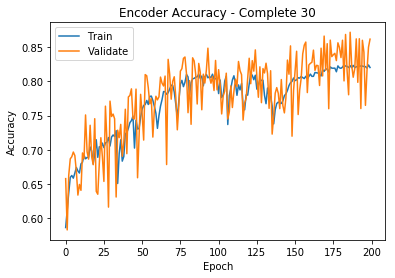

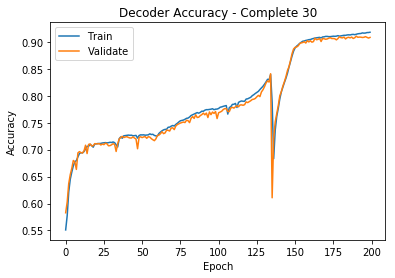

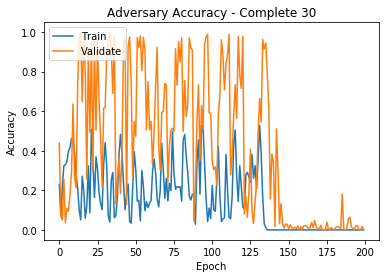

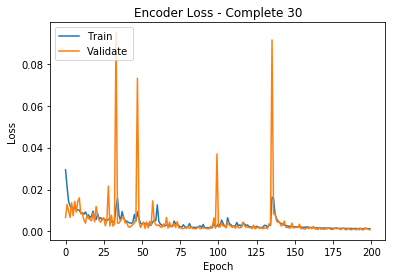

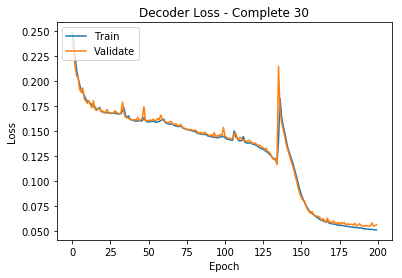

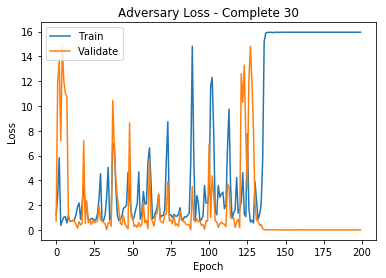

In [17]:
# Plot Encoder Accuracy
plt.plot(acc[0])
plt.plot(vacc[0])
plt.title('Encoder Accuracy - Complete ' + str(L))
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-0-enc-acc.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Decoder Accuracy
plt.plot(acc[1])
plt.plot(vacc[1])
plt.title('Decoder Accuracy - Complete ' + str(L))
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-0-dec-acc.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Adversary Accuracy
plt.plot(acc[2])
plt.plot(vacc[2])
plt.title('Adversary Accuracy - Complete ' + str(L))
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-0-adv-acc.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Encoder Loss
plt.plot(loss[1])
plt.plot(vloss[1])
plt.title('Encoder Loss - Complete ' + str(L))
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-0-enc-loss.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Decoder Loss
plt.plot(loss[2])
plt.plot(vloss[2])
plt.title('Decoder Loss - Complete ' + str(L))
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-0-dec-loss.png', dpi=300, pad_inches=0.1)
plt.show()

# Plot Adversary Loss
plt.plot(loss[3])
plt.plot(vloss[3])
plt.title('Adversary Loss - Complete ' + str(L))
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validate'], loc='upper left')
plt.savefig(modelpath + 'complete-mse-' + str(L) + '-0-adv-loss.png', dpi=300, pad_inches=0.1)
plt.show()

In [31]:
columns = ['Loss', 'vLoss', 'ELoss', 'vELoss', 'DLoss', 'vDLoss', 'ALoss', 'vALoss', 'AdLoss',
          'EAcc', 'vEAcc', 'DAcc', 'vDAcc', 'AAcc', 'vAAcc', 'AdAcc']
df = pd.DataFrame(columns=columns)

In [32]:
df['Loss'] = loss[0]
df['ELoss'] = loss[1]
df['DLoss'] = loss[2]
df['ALoss'] = loss[3]

df['vLoss'] = vloss[0]
df['vELoss'] = vloss[1]
df['vDLoss'] = vloss[2]
df['vALoss'] = vloss[3]

df['EAcc'] = acc[0]
df['DAcc'] = acc[1]
df['AAcc'] = acc[2]

df['vEAcc'] = vacc[0]
df['vDAcc'] = vacc[1]
df['vAAcc'] = vacc[2]

df['AdLoss'] = advla[0]
df['AdAcc'] = advla[1]

df

,Loss,vLoss,ELoss,vELoss,DLoss,vDLoss,ALoss,vALoss,AdLoss,EAcc,vEAcc,DAcc,vDAcc,AAcc,vAAcc,AdAcc
0,0.270175,0.244346,0.029399,0.006641,0.248430,0.238983,1.165195,7.147835e-01,7.246597e-01,0.586739,0.658053,0.551039,0.582848,0.229479,0.438755,0.732170
1,0.257178,0.252532,0.021261,0.012962,0.239479,0.231587,2.815960,1.187180e+01,7.989729e-01,0.611889,0.583272,0.577619,0.602861,0.071321,0.071787,0.864489
2,0.240118,0.234751,0.014315,0.009950,0.224272,0.214099,5.824911,1.368690e+01,6.365849e+00,0.637234,0.662798,0.621367,0.636998,0.222097,0.049699,0.222723
3,0.219869,0.216923,0.012273,0.006766,0.210916,0.204996,0.362312,7.190189e+00,7.043530e+00,0.659802,0.686899,0.644953,0.653581,0.323824,0.256024,0.183308
4,0.211108,0.226915,0.010853,0.013645,0.202787,0.202535,0.723877,1.482802e+01,6.652963e+00,0.662651,0.690013,0.658292,0.665311,0.329955,0.037149,0.204204
5,0.204999,0.208576,0.011460,0.007482,0.195950,0.191300,1.026858,1.203832e+01,6.317818e+00,0.658746,0.696837,0.669866,0.679936,0.345470,0.109438,0.231982
6,0.199071,0.209543,0.010928,0.014346,0.190345,0.188440,1.076386,1.106170e+01,5.649176e+00,0.666107,0.691653,0.677540,0.677443,0.397272,0.094378,0.278529
7,0.196148,0.209902,0.010539,0.009201,0.188212,0.192749,0.559500,1.071269e+01,4.555923e+00,0.674317,0.668348,0.679746,0.663337,0.416291,0.179217,0.336587
8,0.193607,0.192819,0.010244,0.014345,0.185280,0.181798,1.155948,9.798670e-01,3.192634e+00,0.669249,0.634063,0.686541,0.693942,0.461837,0.292671,0.422297
9,0.189536,0.191752,0.010199,0.016044,0.181691,0.179855,0.705459,6.667380e-01,6.972588e-01,0.666182,0.649583,0.692722,0.696386,0.462588,0.636546,0.518644


In [19]:
# Write to CSV
print('Writing to CSV', end='')
df.to_csv('{:}complete-mse-{:02d}-0.csv'.format(modelpath, L))
print(' - Done')

Writing to CSV
 - Done


In [20]:
# Find the Best Accuracy of Models
print('Maximum Validation Accuracy - ')
e_max, d_max, a_max = 0, 0, 0
e_min, d_min, a_min = 0, 0, 0

def find_best_acc(alist, llist):
    maxacc, minloss = 0.0, 10.0
    maxindex, minindex = 0, 0
    for i in range(len(alist)):
        if alist[i]>=maxacc:
            maxacc = alist[i]
            maxindex = i
        if llist[i]<=minloss:
            minloss = llist[i]
            minindex = i
    return [maxacc, maxindex], [minloss, minindex]
    
# Encoder
[maxacc, e_max], [minloss, e_min] = find_best_acc(vacc[0], vloss[1])
print('Encoder   : {:10.7f} | Index : {}'.format(maxacc, e_max))
print('Encoder   : {:10.7f} | Index : {}'.format(minloss, e_min))

# Decoder
[maxacc, d_max], [minloss, d_min] = find_best_acc(vacc[1], vloss[2])
print('Decoder   : {:10.7f} | Index : {}'.format(maxacc, d_max))
print('Decoder   : {:10.7f} | Index : {}'.format(minloss, d_min))

# Adversary
[maxacc, a_max], [minloss, a_min] = find_best_acc(vacc[2], vloss[3])
print('Adversary : {:10.7f} | Index : {}'.format(maxacc, a_max))
print('Adversary : {:10.7f} | Index : {}'.format(minloss, a_min))

Maximum Validation Accuracy - 
Encoder   :  0.8715165 | Index : 186
Encoder   :  0.0007410 | Index : 190
Decoder   :  0.9106091 | Index : 190
Decoder   :  0.0546786 | Index : 190
Adversary :  0.9989960 | Index : 33
Adversary :  0.0000001 | Index : 199


In [21]:
# Load Best Model
print('Loading Best Model', end='')

bemodel = 'complete-encoder-mse-{:02d}-{:1d}-{:03d}'.format(L, 0, e_min)
bdmodel = 'complete-decoder-mse-{:02d}-{:1d}-{:03d}'.format(L, 0, d_min)
bamodel = 'complete-adversary-mse-{:02d}-{:1d}-{:03d}'.format(L, 0, a_min)

l_emodel = load_model(modelpath + bemodel + '.h5')
l_emodel.load_weights(modelpath + bemodel + '.h5')
l_emodel.save(modelpath + bemodel + '.hdf5')
l_emodel = load_model(modelpath + bemodel + '.hdf5')

l_dmodel = load_model(modelpath + bdmodel + '.h5')
l_dmodel.load_weights(modelpath + bdmodel + '.h5')
l_dmodel.save(modelpath + bdmodel + '.hdf5')
l_dmodel = load_model(modelpath + bdmodel + '.hdf5')

l_amodel = load_model(modelpath + bamodel + '.h5')
l_amodel.load_weights(modelpath + bamodel + '.h5')
l_amodel.save(modelpath + bamodel + '.hdf5')
l_amodel = load_model(modelpath + bamodel + '.hdf5')

l_model = build_combined(l_emodel, l_dmodel, l_amodel)
print(' - Done')

Loading Best Model - Done


In [27]:
def calc_metric(loss, acc, history):
    avgl_e, avgl_d, avgl_a = [], [], []
    avga_e, avga_d, avga_a = [], [], []
    avgl = []

    for hist in history:
        avgl.append(hist[0])
        avgl_e.append(hist[1])
        avgl_d.append(hist[2])
        avgl_a.append(hist[3])
        avga_e.append(hist[4])
        avga_d.append(hist[7])
        avga_a.append(hist[8])

    loss[0].append(np.mean(avgl))
    loss[1].append(np.mean(avgl_e))
    loss[2].append(np.mean(avgl_d))
    loss[3].append(np.mean(avgl_a))
    acc[0].append(np.mean(avga_e))
    acc[1].append(np.mean(avga_d))
    acc[2].append(np.mean(avga_a))
    
    return loss, acc

In [28]:
t1loss, t1acc = [[], [], [], [], [], [], []], [[], [], [], [], [], []]
t2loss, t2acc = [[], [], [], [], [], [], []], [[], [], [], [], [], []]

ttbatches = len(test_list)/batch_size
fscore, lscore = [], []

print('Testing Models - [', end='')
for nbatch in range(int(ttbatches)):
    if nbatch%12 == 0:
        print('#', end='')

    t1, t2, t3 = DataGenerator(test_list, test_folder, message_test, nbatch)
    y_gen = np.ones((np.int64(batch_size), 1))
    
    fscore.append(combined.test_on_batch([t1, t2], [t1, t3, y_gen]))
    lscore.append(l_model.test_on_batch([t1, t2], [t1, t3, y_gen]))    
print('] - Done')

t1loss, t1acc = calc_metric(t1loss, t1acc, fscore)
t2loss, t2acc = calc_metric(t2loss, t2acc, lscore)

print()
print('Accuracy  |    Final   |     Best   |')
print('-'*9, '+', '-'*10, '+', '-'*10, '|')
print('Encoder   | {:10.8f} | {:10.8f} |'.format(np.mean(t1acc[0]), np.mean(t2acc[0])))
print('Decoder   | {:10.8f} | {:10.8f} |'.format(np.mean(t1acc[1]), np.mean(t2acc[1])))
print('Adversary | {:10.8f} | {:10.8f} |'.format(np.mean(t1acc[2]), np.mean(t2acc[2])))

Testing Models - [#######] - Done

Accuracy  |    Final   |     Best   |
--------- + ---------- + ---------- |
Encoder   | 0.86171371 | 0.86002684 |
Decoder   | 0.91211510 | 0.90950471 |
Adversary | 0.00000000 | 0.00000000 |


In [29]:
# Save Images
def save_images(dfolder, rfolder, file_list, messages, bmodel):
    print('[', end='')
    for index in range(len(test_list)//batch_size):
        if index%12 == 0:
            print('#', end='')
        file_list_temp = file_list[index*batch_size : (index+1)*batch_size]
        message_temp = messages[index*batch_size : (index+1)*batch_size]

        images = []
        batch_msg = []
        for i, ID in enumerate(file_list_temp):        
            img = cv2.imread(rfolder + ID, -1)
            img = img.reshape([H, W, C])
            images.append((np.array(img, dtype='float32')-127.5)/127.5)
            
            msg = gen_msg_plates(message_temp[i])
            batch_msg.append(msg)
        
        output, _, _ = bmodel.predict([np.array(images), np.array(batch_msg)])
        
        for i in range(len(output)):
            cv2.imwrite(dfolder + file_list_temp[i], arr_img(output[i]))
    print(']', end='')

In [30]:
# Save Test
if np.mean(t1acc[0])>np.mean(t2acc[0]):
    bmodel = combined
else:
    bmodel = l_model

print('Saving Encoded Test Images - ', end='')
save_images('dataset128/complete-gan-mse-{:02d}-{:1d}/test/'.format(L, 0), test_folder, test_list, message_test, bmodel)
print(' - Done')
print('Saving Encoded Validate Images - ', end='')
save_images('dataset128/complete-gan-mse-{:02d}-{:1d}/validate/'.format(L, 0), validate_folder, validate_list, message_validate, bmodel)
print(' - Done')
print('Saving Encoded Train Images - ', end='')
save_images('dataset128/complete-gan-mse-{:02d}-{:1d}/train/'.format(L, 0), train_folder, train_list, message_train, bmodel)
print(' - Done')

Saving Encoded Test Images - [#######] - Done
Saving Encoded Validate Images - [#######] - Done
Saving Encoded Train Images - [#######] - Done
